# Vanilla GAN

![GAN](https://image.slidesharecdn.com/ganlapgan-170104090744/95/generative-adversarial-network-laplacian-pyramid-gan-7-638.jpg?cb=1484221156)

## Training Results on MNIST

### Epoch 1 - 200

![loss](loss.gif)
![training](Sampling.gif)

In [28]:
from torchvision import datasets, transforms
import torch
from torch import nn,optim
from torch.autograd import Variable
from torchvision.utils import save_image,make_grid
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

In [29]:
args={
    'batch_size':256,
    'cuda':True,
    'save_result':10,
    'lr':0.001
}

CUDA_DEVICE=1

In [30]:
kwargs = {'num_workers': 1, 'pin_memory': True} if args['cuda'] else {}
transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.Normalize(mean=(0.5, 0.5, 0.5), 
                std=(0.5, 0.5, 0.5))])

MNIST_data = torch.utils.data.DataLoader(
    datasets.MNIST('data',train=True,download=True,transform=transform),
    batch_size=args['batch_size'], shuffle=True, **kwargs)

In [31]:
def imshow(inp, c, save=False, title=None):
    """Imshow for Tensor."""
    fig = plt.figure(figsize=(5, 5))
    inp = inp.numpy().transpose((1, 2, 0))
    plt.imshow(inp)
    
    plt.title(title) if title is not None else plt.title(str(c).zfill(3))
    plt.show()
    if save:
        if not os.path.exists('vanilla-out/'):
            os.makedirs('vanilla-out/')
        plt.savefig('vanilla-out/{}.png'.format(str(c).zfill(3)), bbox_inches='tight')
        plt.close(fig)

def denorm(x):
    out = (x + 1) / 2
    return out.clamp(0, 1)


In [32]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.fc1=nn.Linear(64,256)
        self.fc2=nn.Linear(256,256)
        self.fc3=nn.Linear(256,256)
        self.fc4=nn.Linear(256,28*28)
        self.relu=nn.LeakyReLU()
        self.tanh=nn.Tanh()
        
    
    def forward(self,z):
        z=self.relu(self.fc1(z))
        z=self.relu(self.fc2(z))
        z=self.relu(self.fc3(z))
        z=self.fc4(z)
        z=self.tanh(z)
        return z.view(-1,1,28,28)


class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator,self).__init__()
        self.fc1=nn.Linear(28*28,256)
        self.fc2=nn.Linear(256,256)
        self.fc3=nn.Linear(256,256)
        self.fc4=nn.Linear(256,1)
        self.relu=nn.LeakyReLU()
        self.sigmoid=nn.Sigmoid()
        
    def forward(self,x):
        x=x.view(-1,28*28)
        x=self.relu(self.fc1(x))
        x=self.relu(self.fc2(x))
        x=self.relu(self.fc3(x))
        x=self.fc4(x)
        x=self.sigmoid(x)
        return x

In [33]:


if args['cuda']:
    gen=Generator().cuda(CUDA_DEVICE)
    dis=Discriminator().cuda(CUDA_DEVICE)
else:
    gen=Generator()
    dis=Discriminator()

criterion=nn.BCELoss()

gen_optimizer=optim.Adam(gen.parameters(),lr=0.0003)
dis_optimizer=optim.Adam(dis.parameters(),lr=0.0003)

> Epoch : 1 Batch : 19 / 235 Loss_D : 1.071130633354187 Loss_G : 0.501803457736969
> Epoch : 1 Batch : 39 / 235 Loss_D : 1.2470717430114746 Loss_G : 0.8765783309936523
> Epoch : 1 Batch : 59 / 235 Loss_D : 0.18784457445144653 Loss_G : 3.1129140853881836
> Epoch : 1 Batch : 79 / 235 Loss_D : 0.2215324342250824 Loss_G : 1.970328450202942
> Epoch : 1 Batch : 99 / 235 Loss_D : 0.5169848203659058 Loss_G : 1.0551432371139526
> Epoch : 1 Batch : 119 / 235 Loss_D : 0.2072204053401947 Loss_G : 1.9873266220092773
> Epoch : 1 Batch : 139 / 235 Loss_D : 0.11885066330432892 Loss_G : 2.938382625579834
> Epoch : 1 Batch : 159 / 235 Loss_D : 0.057947590947151184 Loss_G : 4.474339008331299
> Epoch : 1 Batch : 179 / 235 Loss_D : 0.023191075772047043 Loss_G : 4.404652118682861
> Epoch : 1 Batch : 199 / 235 Loss_D : 0.10716470330953598 Loss_G : 3.6350414752960205
> Epoch : 1 Batch : 219 / 235 Loss_D : 0.02375996857881546 Loss_G : 5.753352165222168


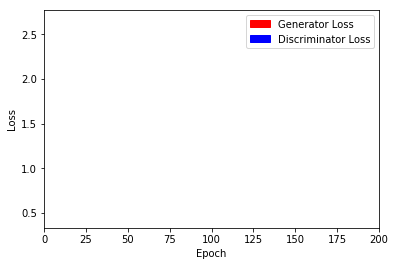

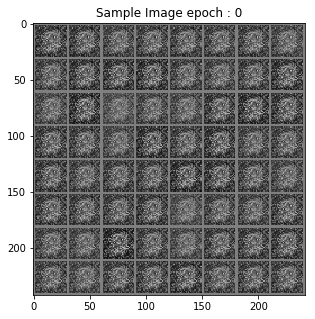

> Epoch : 2 Batch : 19 / 235 Loss_D : 2.652606725692749 Loss_G : 2.795255184173584
> Epoch : 2 Batch : 39 / 235 Loss_D : 0.0924893394112587 Loss_G : 6.256472587585449
> Epoch : 2 Batch : 59 / 235 Loss_D : 0.18235252797603607 Loss_G : 6.624540328979492
> Epoch : 2 Batch : 79 / 235 Loss_D : 0.16775847971439362 Loss_G : 6.274893760681152
> Epoch : 2 Batch : 99 / 235 Loss_D : 0.09635960310697556 Loss_G : 8.348852157592773
> Epoch : 2 Batch : 119 / 235 Loss_D : 0.07494661211967468 Loss_G : 6.565369129180908
> Epoch : 2 Batch : 139 / 235 Loss_D : 0.1980845034122467 Loss_G : 6.790472030639648
> Epoch : 2 Batch : 159 / 235 Loss_D : 0.062078431248664856 Loss_G : 6.593095779418945
> Epoch : 2 Batch : 179 / 235 Loss_D : 0.18047593533992767 Loss_G : 6.94705057144165
> Epoch : 2 Batch : 199 / 235 Loss_D : 0.16266073286533356 Loss_G : 5.565216064453125
> Epoch : 2 Batch : 219 / 235 Loss_D : 0.3481922149658203 Loss_G : 5.048861026763916


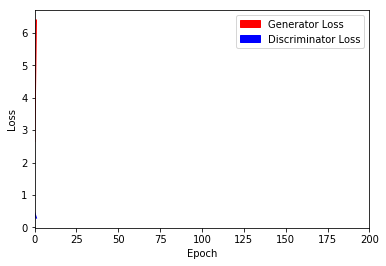

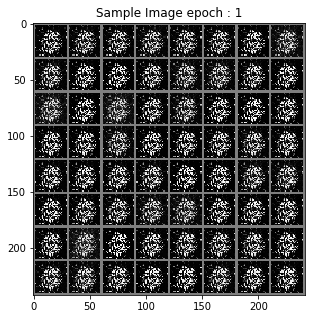

> Epoch : 3 Batch : 19 / 235 Loss_D : 0.0616428442299366 Loss_G : 8.580251693725586
> Epoch : 3 Batch : 39 / 235 Loss_D : 0.1362365484237671 Loss_G : 5.618819236755371
> Epoch : 3 Batch : 59 / 235 Loss_D : 0.4161182641983032 Loss_G : 2.7991909980773926
> Epoch : 3 Batch : 79 / 235 Loss_D : 0.5263578295707703 Loss_G : 2.6328413486480713
> Epoch : 3 Batch : 99 / 235 Loss_D : 0.2968641221523285 Loss_G : 3.786952495574951
> Epoch : 3 Batch : 119 / 235 Loss_D : 0.43826669454574585 Loss_G : 3.2927327156066895
> Epoch : 3 Batch : 139 / 235 Loss_D : 1.269301414489746 Loss_G : 7.920156002044678
> Epoch : 3 Batch : 159 / 235 Loss_D : 0.2198236733675003 Loss_G : 4.410756587982178
> Epoch : 3 Batch : 179 / 235 Loss_D : 1.5916467905044556 Loss_G : 5.325318813323975
> Epoch : 3 Batch : 199 / 235 Loss_D : 0.024465715512633324 Loss_G : 4.776103973388672
> Epoch : 3 Batch : 219 / 235 Loss_D : 0.09458927810192108 Loss_G : 4.513944625854492


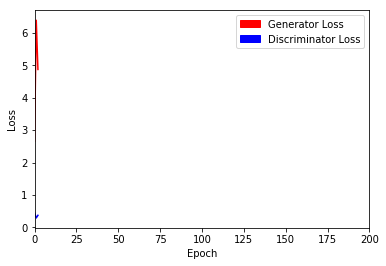

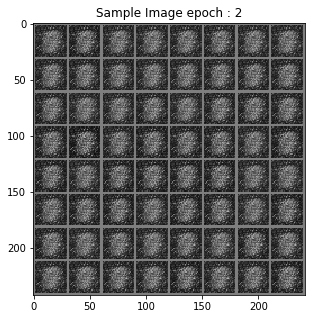

> Epoch : 4 Batch : 19 / 235 Loss_D : 0.39357680082321167 Loss_G : 2.931671142578125
> Epoch : 4 Batch : 39 / 235 Loss_D : 0.059378642588853836 Loss_G : 4.725536346435547
> Epoch : 4 Batch : 59 / 235 Loss_D : 0.5403814315795898 Loss_G : 1.8872145414352417
> Epoch : 4 Batch : 79 / 235 Loss_D : 0.3480401039123535 Loss_G : 3.170762538909912
> Epoch : 4 Batch : 99 / 235 Loss_D : 1.300580382347107 Loss_G : 2.966172456741333
> Epoch : 4 Batch : 119 / 235 Loss_D : 0.25267088413238525 Loss_G : 4.059887886047363
> Epoch : 4 Batch : 139 / 235 Loss_D : 0.11249113082885742 Loss_G : 5.0159173011779785
> Epoch : 4 Batch : 159 / 235 Loss_D : 0.6414653658866882 Loss_G : 3.82743763923645
> Epoch : 4 Batch : 179 / 235 Loss_D : 1.6175882816314697 Loss_G : 4.9352898597717285
> Epoch : 4 Batch : 199 / 235 Loss_D : 2.1340296268463135 Loss_G : 3.6796653270721436
> Epoch : 4 Batch : 219 / 235 Loss_D : 0.31564778089523315 Loss_G : 5.411872863769531


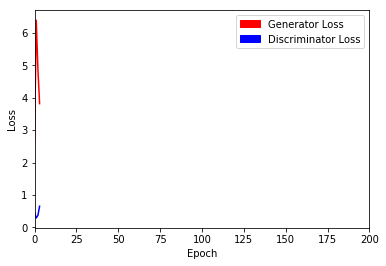

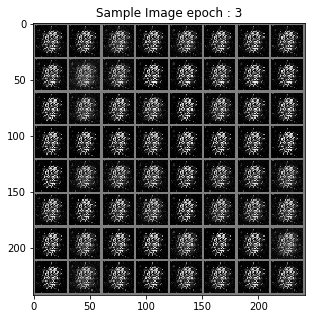

> Epoch : 5 Batch : 19 / 235 Loss_D : 0.1944270133972168 Loss_G : 7.0989837646484375
> Epoch : 5 Batch : 39 / 235 Loss_D : 0.6724457144737244 Loss_G : 8.602149963378906
> Epoch : 5 Batch : 59 / 235 Loss_D : 0.2204606533050537 Loss_G : 8.55710220336914
> Epoch : 5 Batch : 79 / 235 Loss_D : 0.09077216684818268 Loss_G : 8.554391860961914
> Epoch : 5 Batch : 99 / 235 Loss_D : 0.5079902410507202 Loss_G : 4.051531791687012
> Epoch : 5 Batch : 119 / 235 Loss_D : 0.16871947050094604 Loss_G : 5.4515533447265625
> Epoch : 5 Batch : 139 / 235 Loss_D : 2.751878261566162 Loss_G : 0.6741703748703003
> Epoch : 5 Batch : 159 / 235 Loss_D : 1.0804778337478638 Loss_G : 2.0009384155273438
> Epoch : 5 Batch : 179 / 235 Loss_D : 0.6838459968566895 Loss_G : 2.719237804412842
> Epoch : 5 Batch : 199 / 235 Loss_D : 0.9857496619224548 Loss_G : 2.9470267295837402
> Epoch : 5 Batch : 219 / 235 Loss_D : 1.374345064163208 Loss_G : 2.286588191986084


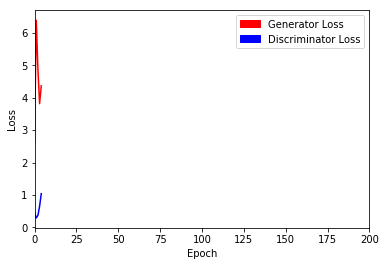

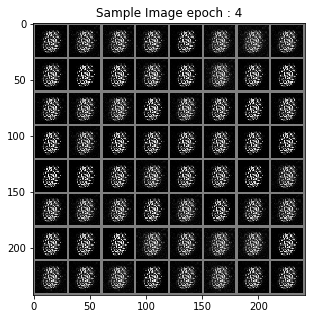

> Epoch : 6 Batch : 19 / 235 Loss_D : 0.3773391544818878 Loss_G : 4.202949523925781
> Epoch : 6 Batch : 39 / 235 Loss_D : 0.5741601586341858 Loss_G : 4.083075523376465
> Epoch : 6 Batch : 59 / 235 Loss_D : 0.8233784437179565 Loss_G : 3.766659736633301
> Epoch : 6 Batch : 79 / 235 Loss_D : 0.23451673984527588 Loss_G : 4.732291221618652
> Epoch : 6 Batch : 99 / 235 Loss_D : 1.5615506172180176 Loss_G : 1.1390893459320068
> Epoch : 6 Batch : 119 / 235 Loss_D : 0.8923543691635132 Loss_G : 2.151362180709839
> Epoch : 6 Batch : 139 / 235 Loss_D : 0.5749696493148804 Loss_G : 2.48409366607666
> Epoch : 6 Batch : 159 / 235 Loss_D : 0.6168127059936523 Loss_G : 2.7611618041992188
> Epoch : 6 Batch : 179 / 235 Loss_D : 0.7660186886787415 Loss_G : 2.6546804904937744
> Epoch : 6 Batch : 199 / 235 Loss_D : 4.426011085510254 Loss_G : 0.9783679246902466
> Epoch : 6 Batch : 219 / 235 Loss_D : 0.9851790070533752 Loss_G : 2.4997944831848145


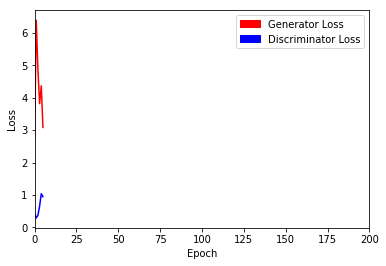

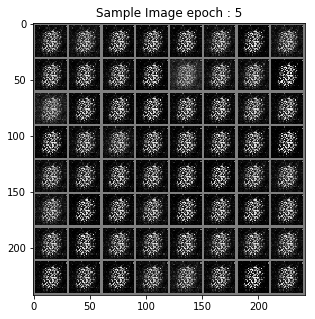

> Epoch : 7 Batch : 19 / 235 Loss_D : 0.11552155017852783 Loss_G : 4.995174884796143
> Epoch : 7 Batch : 39 / 235 Loss_D : 0.31548330187797546 Loss_G : 3.295789957046509
> Epoch : 7 Batch : 59 / 235 Loss_D : 0.6898305416107178 Loss_G : 2.1701712608337402
> Epoch : 7 Batch : 79 / 235 Loss_D : 0.9182989597320557 Loss_G : 2.121593475341797
> Epoch : 7 Batch : 99 / 235 Loss_D : 0.34793055057525635 Loss_G : 2.5356831550598145
> Epoch : 7 Batch : 119 / 235 Loss_D : 1.4135136604309082 Loss_G : 2.250516176223755
> Epoch : 7 Batch : 139 / 235 Loss_D : 0.9295334815979004 Loss_G : 1.91719651222229
> Epoch : 7 Batch : 159 / 235 Loss_D : 1.6404414176940918 Loss_G : 2.03206729888916
> Epoch : 7 Batch : 179 / 235 Loss_D : 0.5321630239486694 Loss_G : 2.912515640258789
> Epoch : 7 Batch : 199 / 235 Loss_D : 0.672343373298645 Loss_G : 2.0021250247955322
> Epoch : 7 Batch : 219 / 235 Loss_D : 0.41774147748947144 Loss_G : 3.393521785736084


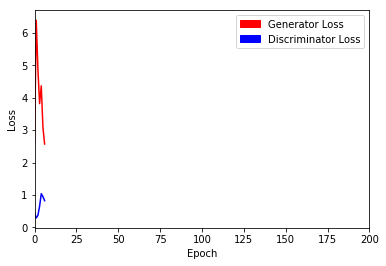

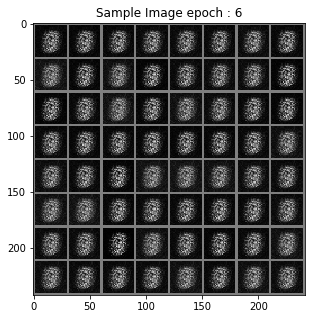

> Epoch : 8 Batch : 19 / 235 Loss_D : 1.1868504285812378 Loss_G : 1.6999356746673584
> Epoch : 8 Batch : 39 / 235 Loss_D : 0.46874576807022095 Loss_G : 2.632053852081299
> Epoch : 8 Batch : 59 / 235 Loss_D : 1.4019443988800049 Loss_G : 1.8801686763763428
> Epoch : 8 Batch : 79 / 235 Loss_D : 1.8772611618041992 Loss_G : 1.9358973503112793
> Epoch : 8 Batch : 99 / 235 Loss_D : 0.4956310987472534 Loss_G : 2.9130873680114746
> Epoch : 8 Batch : 119 / 235 Loss_D : 1.6305443048477173 Loss_G : 1.546176552772522
> Epoch : 8 Batch : 139 / 235 Loss_D : 1.31598961353302 Loss_G : 2.0096259117126465
> Epoch : 8 Batch : 159 / 235 Loss_D : 0.7664430141448975 Loss_G : 2.592024326324463
> Epoch : 8 Batch : 179 / 235 Loss_D : 1.1452564001083374 Loss_G : 1.8452434539794922
> Epoch : 8 Batch : 199 / 235 Loss_D : 0.6364516615867615 Loss_G : 3.319535732269287
> Epoch : 8 Batch : 219 / 235 Loss_D : 1.2537212371826172 Loss_G : 2.9043996334075928


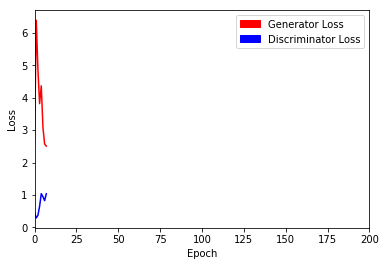

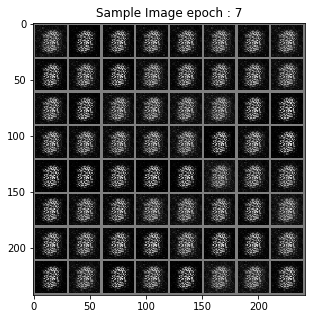

> Epoch : 9 Batch : 19 / 235 Loss_D : 0.5171570181846619 Loss_G : 3.2975220680236816
> Epoch : 9 Batch : 39 / 235 Loss_D : 0.8292111158370972 Loss_G : 2.762451171875
> Epoch : 9 Batch : 59 / 235 Loss_D : 1.4203810691833496 Loss_G : 3.4172019958496094
> Epoch : 9 Batch : 79 / 235 Loss_D : 0.4354487955570221 Loss_G : 3.3197133541107178
> Epoch : 9 Batch : 99 / 235 Loss_D : 0.7584524154663086 Loss_G : 2.3510079383850098
> Epoch : 9 Batch : 119 / 235 Loss_D : 0.8822878003120422 Loss_G : 2.6570920944213867
> Epoch : 9 Batch : 139 / 235 Loss_D : 0.8906574249267578 Loss_G : 2.4261465072631836
> Epoch : 9 Batch : 159 / 235 Loss_D : 0.8546544313430786 Loss_G : 2.078892230987549
> Epoch : 9 Batch : 179 / 235 Loss_D : 0.6379812955856323 Loss_G : 2.2865798473358154
> Epoch : 9 Batch : 199 / 235 Loss_D : 1.5078883171081543 Loss_G : 1.4822980165481567
> Epoch : 9 Batch : 219 / 235 Loss_D : 0.7345089912414551 Loss_G : 1.6379941701889038


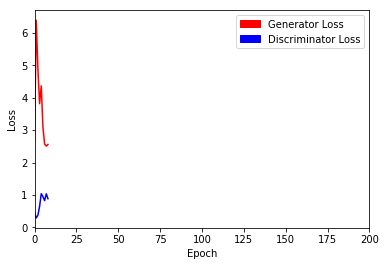

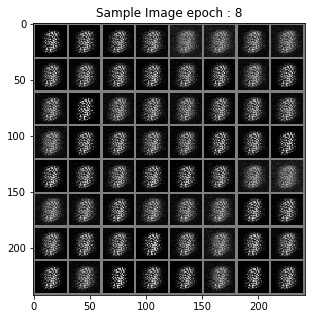

> Epoch : 10 Batch : 19 / 235 Loss_D : 0.8676973581314087 Loss_G : 1.891420602798462
> Epoch : 10 Batch : 39 / 235 Loss_D : 1.269796371459961 Loss_G : 1.9619873762130737
> Epoch : 10 Batch : 59 / 235 Loss_D : 1.5352349281311035 Loss_G : 1.9706021547317505
> Epoch : 10 Batch : 79 / 235 Loss_D : 1.0899112224578857 Loss_G : 3.2406952381134033
> Epoch : 10 Batch : 99 / 235 Loss_D : 0.9319696426391602 Loss_G : 2.6198816299438477
> Epoch : 10 Batch : 119 / 235 Loss_D : 0.2942180931568146 Loss_G : 3.288435697555542
> Epoch : 10 Batch : 139 / 235 Loss_D : 0.13441500067710876 Loss_G : 3.5411994457244873
> Epoch : 10 Batch : 159 / 235 Loss_D : 1.7402102947235107 Loss_G : 2.4164493083953857
> Epoch : 10 Batch : 179 / 235 Loss_D : 1.4311938285827637 Loss_G : 2.263314723968506
> Epoch : 10 Batch : 199 / 235 Loss_D : 0.7258245944976807 Loss_G : 3.1329612731933594
> Epoch : 10 Batch : 219 / 235 Loss_D : 0.4923751950263977 Loss_G : 3.934751510620117


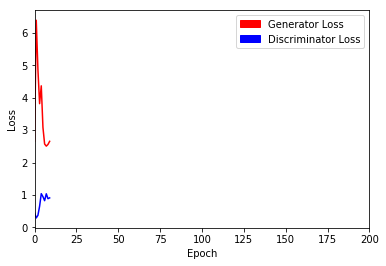

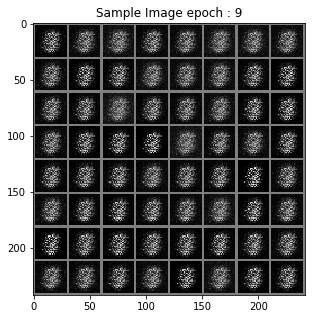

> Epoch : 11 Batch : 19 / 235 Loss_D : 1.0481151342391968 Loss_G : 2.695592164993286
> Epoch : 11 Batch : 39 / 235 Loss_D : 0.8489900827407837 Loss_G : 2.339662790298462
> Epoch : 11 Batch : 59 / 235 Loss_D : 0.6915140151977539 Loss_G : 2.622222900390625
> Epoch : 11 Batch : 79 / 235 Loss_D : 1.2123160362243652 Loss_G : 2.5735111236572266
> Epoch : 11 Batch : 99 / 235 Loss_D : 1.0979716777801514 Loss_G : 4.598543167114258
> Epoch : 11 Batch : 119 / 235 Loss_D : 1.2161296606063843 Loss_G : 1.2776062488555908
> Epoch : 11 Batch : 139 / 235 Loss_D : 0.4104585647583008 Loss_G : 2.1535911560058594
> Epoch : 11 Batch : 159 / 235 Loss_D : 0.870090901851654 Loss_G : 1.9315415620803833
> Epoch : 11 Batch : 179 / 235 Loss_D : 2.4095683097839355 Loss_G : 0.6483418941497803
> Epoch : 11 Batch : 199 / 235 Loss_D : 0.5269994735717773 Loss_G : 1.652737021446228
> Epoch : 11 Batch : 219 / 235 Loss_D : 0.3271429240703583 Loss_G : 2.08076810836792


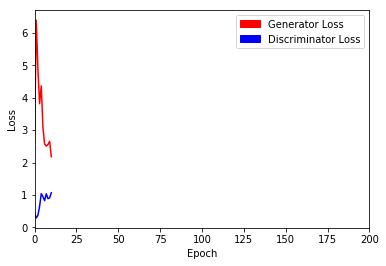

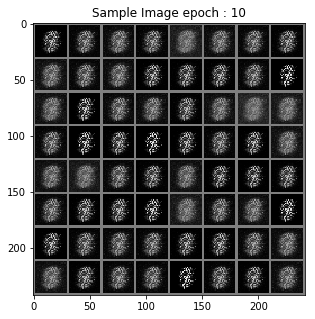

> Epoch : 12 Batch : 19 / 235 Loss_D : 0.8964732885360718 Loss_G : 1.3288977146148682
> Epoch : 12 Batch : 39 / 235 Loss_D : 0.41142067313194275 Loss_G : 2.1719794273376465
> Epoch : 12 Batch : 59 / 235 Loss_D : 0.9169981479644775 Loss_G : 1.6481599807739258
> Epoch : 12 Batch : 79 / 235 Loss_D : 0.6655871868133545 Loss_G : 2.0816004276275635
> Epoch : 12 Batch : 99 / 235 Loss_D : 0.9746524095535278 Loss_G : 2.286194086074829
> Epoch : 12 Batch : 119 / 235 Loss_D : 0.1509702503681183 Loss_G : 3.6609790325164795
> Epoch : 12 Batch : 139 / 235 Loss_D : 1.1378884315490723 Loss_G : 2.6207659244537354
> Epoch : 12 Batch : 159 / 235 Loss_D : 0.645850658416748 Loss_G : 2.7543063163757324
> Epoch : 12 Batch : 179 / 235 Loss_D : 1.207818865776062 Loss_G : 2.5685858726501465
> Epoch : 12 Batch : 199 / 235 Loss_D : 0.7583335638046265 Loss_G : 2.8268160820007324
> Epoch : 12 Batch : 219 / 235 Loss_D : 0.9462059736251831 Loss_G : 1.9422149658203125


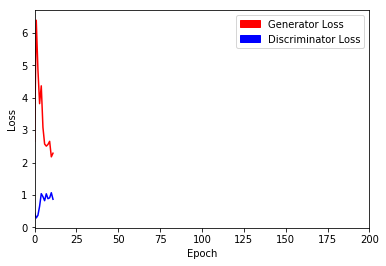

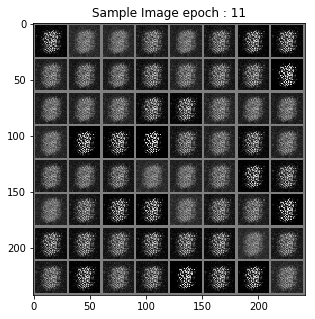

> Epoch : 13 Batch : 19 / 235 Loss_D : 0.4954782724380493 Loss_G : 1.9475018978118896
> Epoch : 13 Batch : 39 / 235 Loss_D : 1.5422022342681885 Loss_G : 1.2176002264022827
> Epoch : 13 Batch : 59 / 235 Loss_D : 0.7486120462417603 Loss_G : 2.208617687225342
> Epoch : 13 Batch : 79 / 235 Loss_D : 0.29508036375045776 Loss_G : 2.7003703117370605
> Epoch : 13 Batch : 99 / 235 Loss_D : 0.5336644053459167 Loss_G : 2.5311532020568848
> Epoch : 13 Batch : 119 / 235 Loss_D : 0.17797353863716125 Loss_G : 3.472904682159424
> Epoch : 13 Batch : 139 / 235 Loss_D : 0.9616997241973877 Loss_G : 1.9864578247070312
> Epoch : 13 Batch : 159 / 235 Loss_D : 0.6826726198196411 Loss_G : 2.4141902923583984
> Epoch : 13 Batch : 179 / 235 Loss_D : 0.2064695805311203 Loss_G : 3.4663515090942383
> Epoch : 13 Batch : 199 / 235 Loss_D : 0.44662654399871826 Loss_G : 4.4255828857421875
> Epoch : 13 Batch : 219 / 235 Loss_D : 1.5499365329742432 Loss_G : 3.999897003173828


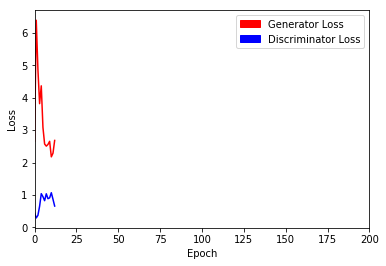

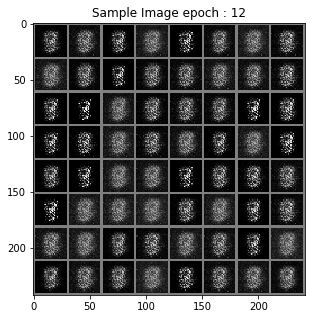

> Epoch : 14 Batch : 19 / 235 Loss_D : 1.8237308263778687 Loss_G : 2.621025323867798
> Epoch : 14 Batch : 39 / 235 Loss_D : 1.3524917364120483 Loss_G : 1.0925722122192383
> Epoch : 14 Batch : 59 / 235 Loss_D : 0.8709366321563721 Loss_G : 1.2621259689331055
> Epoch : 14 Batch : 79 / 235 Loss_D : 0.6523401141166687 Loss_G : 1.6000564098358154
> Epoch : 14 Batch : 99 / 235 Loss_D : 0.4558837413787842 Loss_G : 2.1762218475341797
> Epoch : 14 Batch : 119 / 235 Loss_D : 0.5524560213088989 Loss_G : 1.7893598079681396
> Epoch : 14 Batch : 139 / 235 Loss_D : 0.8822739124298096 Loss_G : 1.9507687091827393
> Epoch : 14 Batch : 159 / 235 Loss_D : 1.3749173879623413 Loss_G : 1.4809505939483643
> Epoch : 14 Batch : 179 / 235 Loss_D : 0.8063232898712158 Loss_G : 1.878251075744629
> Epoch : 14 Batch : 199 / 235 Loss_D : 0.7035856246948242 Loss_G : 2.3178045749664307
> Epoch : 14 Batch : 219 / 235 Loss_D : 0.46204692125320435 Loss_G : 3.1356921195983887


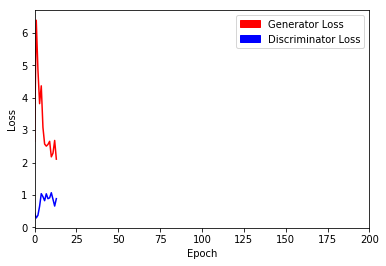

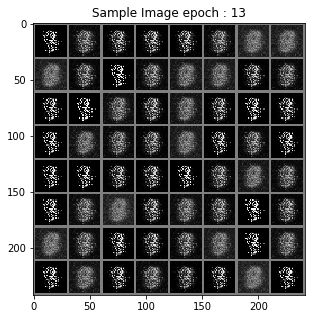

> Epoch : 15 Batch : 19 / 235 Loss_D : 0.710512638092041 Loss_G : 3.2391512393951416
> Epoch : 15 Batch : 39 / 235 Loss_D : 0.9268311858177185 Loss_G : 1.6397181749343872
> Epoch : 15 Batch : 59 / 235 Loss_D : 0.2358229160308838 Loss_G : 3.128509759902954
> Epoch : 15 Batch : 79 / 235 Loss_D : 0.29518452286720276 Loss_G : 2.9049298763275146
> Epoch : 15 Batch : 99 / 235 Loss_D : 0.7609146237373352 Loss_G : 2.305283308029175
> Epoch : 15 Batch : 119 / 235 Loss_D : 1.4516220092773438 Loss_G : 1.673856258392334
> Epoch : 15 Batch : 139 / 235 Loss_D : 0.4752180278301239 Loss_G : 2.7726058959960938
> Epoch : 15 Batch : 159 / 235 Loss_D : 0.23962882161140442 Loss_G : 3.4151711463928223
> Epoch : 15 Batch : 179 / 235 Loss_D : 0.6973854303359985 Loss_G : 2.1562399864196777
> Epoch : 15 Batch : 199 / 235 Loss_D : 0.8882948160171509 Loss_G : 2.7038888931274414
> Epoch : 15 Batch : 219 / 235 Loss_D : 0.75943922996521 Loss_G : 1.915675401687622


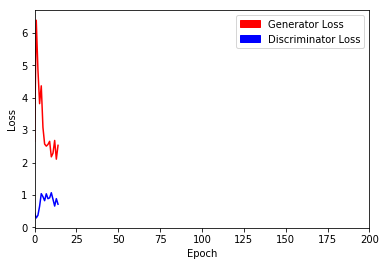

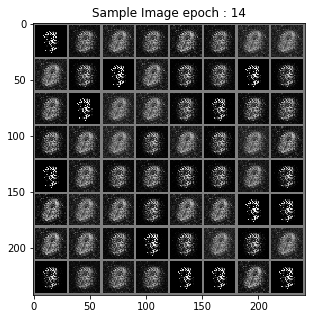

> Epoch : 16 Batch : 19 / 235 Loss_D : 0.65878826379776 Loss_G : 2.431520462036133
> Epoch : 16 Batch : 39 / 235 Loss_D : 0.32002997398376465 Loss_G : 2.9492998123168945
> Epoch : 16 Batch : 59 / 235 Loss_D : 0.6762630939483643 Loss_G : 2.2085671424865723
> Epoch : 16 Batch : 79 / 235 Loss_D : 1.5469942092895508 Loss_G : 2.7735466957092285
> Epoch : 16 Batch : 99 / 235 Loss_D : 1.2861015796661377 Loss_G : 2.5602893829345703
> Epoch : 16 Batch : 119 / 235 Loss_D : 1.1725523471832275 Loss_G : 1.9328832626342773
> Epoch : 16 Batch : 139 / 235 Loss_D : 0.3089970648288727 Loss_G : 3.1674907207489014
> Epoch : 16 Batch : 159 / 235 Loss_D : 0.5581309795379639 Loss_G : 1.9712234735488892
> Epoch : 16 Batch : 179 / 235 Loss_D : 1.0529530048370361 Loss_G : 1.2006251811981201
> Epoch : 16 Batch : 199 / 235 Loss_D : 0.9991114735603333 Loss_G : 1.2747522592544556
> Epoch : 16 Batch : 219 / 235 Loss_D : 0.43908727169036865 Loss_G : 2.228062152862549


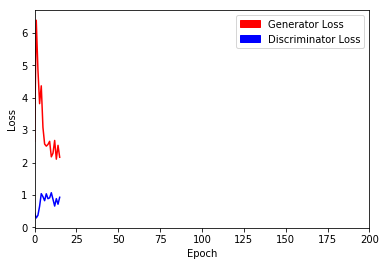

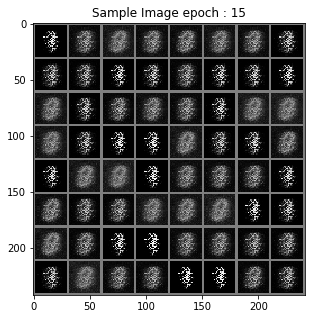

> Epoch : 17 Batch : 19 / 235 Loss_D : 0.6855675578117371 Loss_G : 1.6801882982254028
> Epoch : 17 Batch : 39 / 235 Loss_D : 0.9942178130149841 Loss_G : 1.3308660984039307
> Epoch : 17 Batch : 59 / 235 Loss_D : 0.5748410224914551 Loss_G : 1.5926148891448975
> Epoch : 17 Batch : 79 / 235 Loss_D : 0.24256324768066406 Loss_G : 2.7891674041748047
> Epoch : 17 Batch : 99 / 235 Loss_D : 0.3237987160682678 Loss_G : 2.2516040802001953
> Epoch : 17 Batch : 119 / 235 Loss_D : 0.6384355425834656 Loss_G : 1.9961397647857666
> Epoch : 17 Batch : 139 / 235 Loss_D : 0.6790554523468018 Loss_G : 2.8421168327331543
> Epoch : 17 Batch : 159 / 235 Loss_D : 0.49986299872398376 Loss_G : 2.467017412185669
> Epoch : 17 Batch : 179 / 235 Loss_D : 0.6761282682418823 Loss_G : 2.6702303886413574
> Epoch : 17 Batch : 199 / 235 Loss_D : 1.0476288795471191 Loss_G : 2.262871742248535
> Epoch : 17 Batch : 219 / 235 Loss_D : 0.38774701952934265 Loss_G : 2.2819063663482666


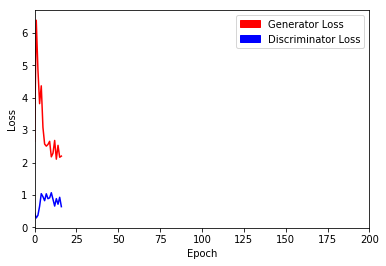

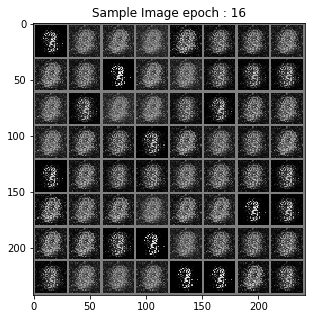

> Epoch : 18 Batch : 19 / 235 Loss_D : 0.8402007222175598 Loss_G : 2.230506420135498
> Epoch : 18 Batch : 39 / 235 Loss_D : 0.7904199361801147 Loss_G : 2.5863804817199707
> Epoch : 18 Batch : 59 / 235 Loss_D : 0.64056396484375 Loss_G : 2.1182615756988525
> Epoch : 18 Batch : 79 / 235 Loss_D : 0.29637908935546875 Loss_G : 3.0069921016693115
> Epoch : 18 Batch : 99 / 235 Loss_D : 0.8168332576751709 Loss_G : 3.036846876144409
> Epoch : 18 Batch : 119 / 235 Loss_D : 1.62919020652771 Loss_G : 3.2393970489501953
> Epoch : 18 Batch : 139 / 235 Loss_D : 1.2389577627182007 Loss_G : 5.011979103088379
> Epoch : 18 Batch : 159 / 235 Loss_D : 0.6665204763412476 Loss_G : 5.027758598327637
> Epoch : 18 Batch : 179 / 235 Loss_D : 5.3728108406066895 Loss_G : 3.066471815109253
> Epoch : 18 Batch : 199 / 235 Loss_D : 0.2968844175338745 Loss_G : 4.394637584686279
> Epoch : 18 Batch : 219 / 235 Loss_D : 0.054957907646894455 Loss_G : 5.004080772399902


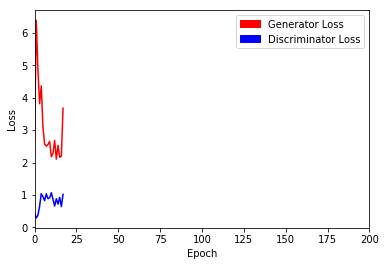

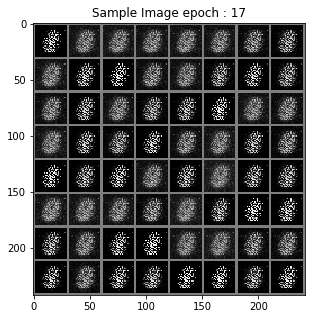

> Epoch : 19 Batch : 19 / 235 Loss_D : 0.9150794148445129 Loss_G : 4.368090629577637
> Epoch : 19 Batch : 39 / 235 Loss_D : 5.154234886169434 Loss_G : 2.7563636302948
> Epoch : 19 Batch : 59 / 235 Loss_D : 1.2770615816116333 Loss_G : 6.720242500305176
> Epoch : 19 Batch : 79 / 235 Loss_D : 0.28524407744407654 Loss_G : 7.634546279907227
> Epoch : 19 Batch : 99 / 235 Loss_D : 0.9172811508178711 Loss_G : 8.949850082397461
> Epoch : 19 Batch : 119 / 235 Loss_D : 1.6192176342010498 Loss_G : 7.984172344207764
> Epoch : 19 Batch : 139 / 235 Loss_D : 0.7117639780044556 Loss_G : 9.621788024902344
> Epoch : 19 Batch : 159 / 235 Loss_D : 8.290786743164062 Loss_G : 4.102062702178955
> Epoch : 19 Batch : 179 / 235 Loss_D : 0.30985480546951294 Loss_G : 5.707098960876465
> Epoch : 19 Batch : 199 / 235 Loss_D : 0.47876718640327454 Loss_G : 4.350214004516602
> Epoch : 19 Batch : 219 / 235 Loss_D : 0.5969516038894653 Loss_G : 8.984750747680664


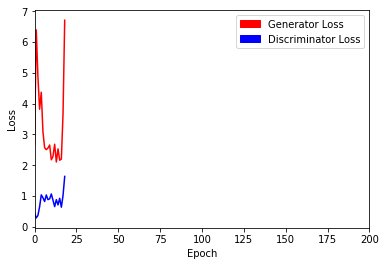

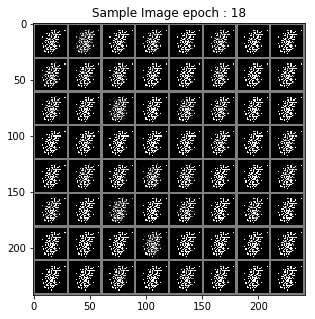

> Epoch : 20 Batch : 19 / 235 Loss_D : 0.6531065702438354 Loss_G : 12.970812797546387
> Epoch : 20 Batch : 39 / 235 Loss_D : 0.1276378035545349 Loss_G : 14.240669250488281
> Epoch : 20 Batch : 59 / 235 Loss_D : 1.0262707471847534 Loss_G : 12.427998542785645
> Epoch : 20 Batch : 79 / 235 Loss_D : 0.2151067703962326 Loss_G : 9.771394729614258
> Epoch : 20 Batch : 99 / 235 Loss_D : 0.16279533505439758 Loss_G : 3.7097675800323486
> Epoch : 20 Batch : 119 / 235 Loss_D : 0.5583429336547852 Loss_G : 4.207492828369141
> Epoch : 20 Batch : 139 / 235 Loss_D : 0.3521552085876465 Loss_G : 5.5297980308532715
> Epoch : 20 Batch : 159 / 235 Loss_D : 0.40828028321266174 Loss_G : 4.624389171600342
> Epoch : 20 Batch : 179 / 235 Loss_D : 0.3536447286605835 Loss_G : 4.919050216674805
> Epoch : 20 Batch : 199 / 235 Loss_D : 0.45867398381233215 Loss_G : 4.78134298324585
> Epoch : 20 Batch : 219 / 235 Loss_D : 0.6599380970001221 Loss_G : 2.9355227947235107


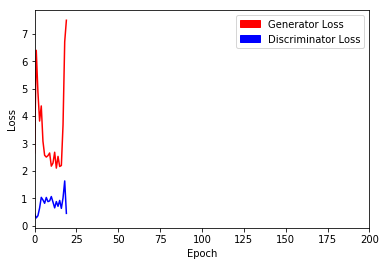

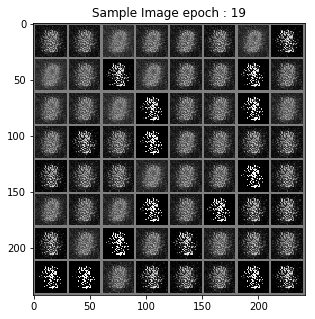

> Epoch : 21 Batch : 19 / 235 Loss_D : 0.4901687502861023 Loss_G : 1.64286470413208
> Epoch : 21 Batch : 39 / 235 Loss_D : 0.8550397157669067 Loss_G : 2.933051109313965
> Epoch : 21 Batch : 59 / 235 Loss_D : 1.409373164176941 Loss_G : 2.046635150909424
> Epoch : 21 Batch : 79 / 235 Loss_D : 1.76372230052948 Loss_G : 1.6798226833343506
> Epoch : 21 Batch : 99 / 235 Loss_D : 0.9273017644882202 Loss_G : 3.5018997192382812
> Epoch : 21 Batch : 119 / 235 Loss_D : 0.3962264955043793 Loss_G : 5.016878128051758
> Epoch : 21 Batch : 139 / 235 Loss_D : 0.324849009513855 Loss_G : 5.675779342651367
> Epoch : 21 Batch : 159 / 235 Loss_D : 0.5481471419334412 Loss_G : 5.755914688110352
> Epoch : 21 Batch : 179 / 235 Loss_D : 3.2057266235351562 Loss_G : 2.95859956741333
> Epoch : 21 Batch : 199 / 235 Loss_D : 0.18665415048599243 Loss_G : 7.8244829177856445
> Epoch : 21 Batch : 219 / 235 Loss_D : 2.163604259490967 Loss_G : 3.807605028152466


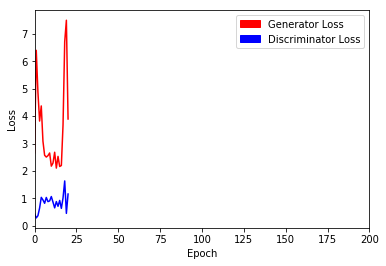

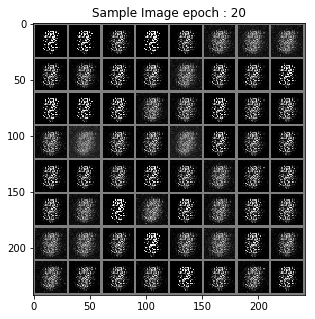

> Epoch : 22 Batch : 19 / 235 Loss_D : 0.531996488571167 Loss_G : 4.403277397155762
> Epoch : 22 Batch : 39 / 235 Loss_D : 1.6355125904083252 Loss_G : 4.130604267120361
> Epoch : 22 Batch : 59 / 235 Loss_D : 1.5694212913513184 Loss_G : 4.330802917480469
> Epoch : 22 Batch : 79 / 235 Loss_D : 0.4844740629196167 Loss_G : 5.13184118270874
> Epoch : 22 Batch : 99 / 235 Loss_D : 1.0729848146438599 Loss_G : 2.9909048080444336
> Epoch : 22 Batch : 119 / 235 Loss_D : 1.1086881160736084 Loss_G : 2.674609661102295
> Epoch : 22 Batch : 139 / 235 Loss_D : 0.40132829546928406 Loss_G : 3.3224129676818848
> Epoch : 22 Batch : 159 / 235 Loss_D : 1.077361822128296 Loss_G : 1.6728570461273193
> Epoch : 22 Batch : 179 / 235 Loss_D : 1.2256841659545898 Loss_G : 1.9282546043395996
> Epoch : 22 Batch : 199 / 235 Loss_D : 0.3834259808063507 Loss_G : 3.0622153282165527
> Epoch : 22 Batch : 219 / 235 Loss_D : 0.48625418543815613 Loss_G : 2.765583038330078


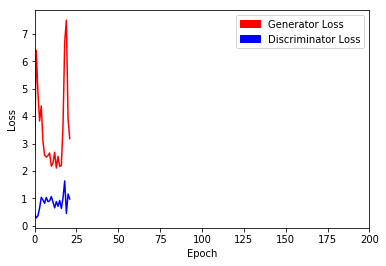

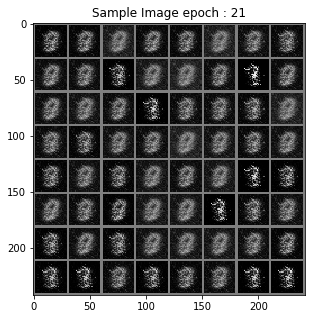

> Epoch : 23 Batch : 19 / 235 Loss_D : 0.7700493931770325 Loss_G : 2.2902534008026123
> Epoch : 23 Batch : 39 / 235 Loss_D : 0.35012581944465637 Loss_G : 2.992889404296875
> Epoch : 23 Batch : 59 / 235 Loss_D : 0.786270260810852 Loss_G : 1.8997479677200317
> Epoch : 23 Batch : 79 / 235 Loss_D : 0.8063636422157288 Loss_G : 2.18705153465271
> Epoch : 23 Batch : 99 / 235 Loss_D : 1.4602181911468506 Loss_G : 1.5887963771820068
> Epoch : 23 Batch : 119 / 235 Loss_D : 1.893190622329712 Loss_G : 2.0224387645721436
> Epoch : 23 Batch : 139 / 235 Loss_D : 0.7983267307281494 Loss_G : 1.8289446830749512
> Epoch : 23 Batch : 159 / 235 Loss_D : 0.4486148953437805 Loss_G : 2.49404239654541
> Epoch : 23 Batch : 179 / 235 Loss_D : 0.6115659475326538 Loss_G : 2.5035033226013184
> Epoch : 23 Batch : 199 / 235 Loss_D : 0.5637302994728088 Loss_G : 2.120969772338867
> Epoch : 23 Batch : 219 / 235 Loss_D : 0.5027739405632019 Loss_G : 2.7883667945861816


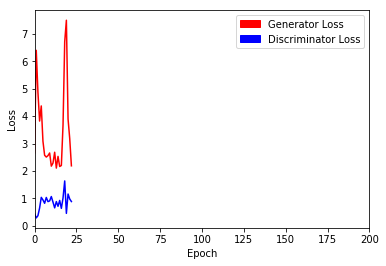

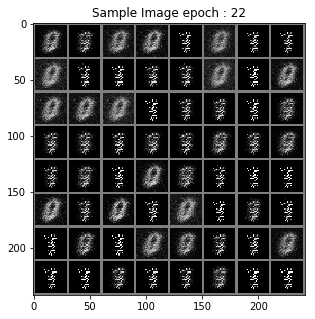

> Epoch : 24 Batch : 19 / 235 Loss_D : 0.620323896408081 Loss_G : 2.7662129402160645
> Epoch : 24 Batch : 39 / 235 Loss_D : 0.613646388053894 Loss_G : 2.5567336082458496
> Epoch : 24 Batch : 59 / 235 Loss_D : 0.8991298675537109 Loss_G : 2.617189407348633
> Epoch : 24 Batch : 79 / 235 Loss_D : 0.40671420097351074 Loss_G : 3.378718614578247
> Epoch : 24 Batch : 99 / 235 Loss_D : 0.34196075797080994 Loss_G : 3.0222010612487793
> Epoch : 24 Batch : 119 / 235 Loss_D : 0.4522061347961426 Loss_G : 3.3224916458129883
> Epoch : 24 Batch : 139 / 235 Loss_D : 0.3005281686782837 Loss_G : 3.1098272800445557
> Epoch : 24 Batch : 159 / 235 Loss_D : 0.45012789964675903 Loss_G : 2.9490456581115723
> Epoch : 24 Batch : 179 / 235 Loss_D : 0.42517808079719543 Loss_G : 2.905653476715088
> Epoch : 24 Batch : 199 / 235 Loss_D : 0.5300581455230713 Loss_G : 2.5962412357330322
> Epoch : 24 Batch : 219 / 235 Loss_D : 0.6107144355773926 Loss_G : 1.9259268045425415


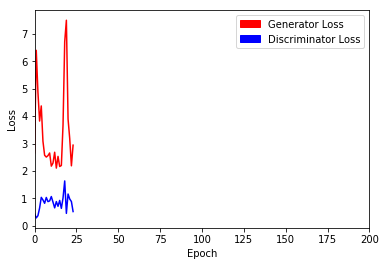

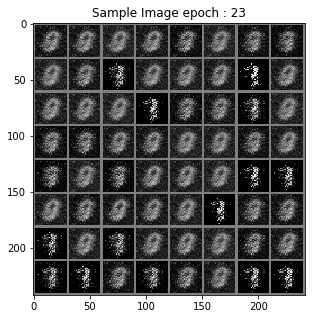

> Epoch : 25 Batch : 19 / 235 Loss_D : 0.8257708549499512 Loss_G : 2.5807201862335205
> Epoch : 25 Batch : 39 / 235 Loss_D : 1.271923542022705 Loss_G : 1.940866231918335
> Epoch : 25 Batch : 59 / 235 Loss_D : 0.7202737331390381 Loss_G : 2.493699789047241
> Epoch : 25 Batch : 79 / 235 Loss_D : 0.37236279249191284 Loss_G : 3.0334315299987793
> Epoch : 25 Batch : 99 / 235 Loss_D : 0.26647448539733887 Loss_G : 5.488724708557129
> Epoch : 25 Batch : 119 / 235 Loss_D : 0.6128741502761841 Loss_G : 6.345439910888672
> Epoch : 25 Batch : 139 / 235 Loss_D : 0.6909767985343933 Loss_G : 4.737782955169678
> Epoch : 25 Batch : 159 / 235 Loss_D : 0.6463444232940674 Loss_G : 4.387454032897949
> Epoch : 25 Batch : 179 / 235 Loss_D : 0.46403807401657104 Loss_G : 3.4612715244293213
> Epoch : 25 Batch : 199 / 235 Loss_D : 0.3430272042751312 Loss_G : 4.933358669281006
> Epoch : 25 Batch : 219 / 235 Loss_D : 1.1671009063720703 Loss_G : 4.993293762207031


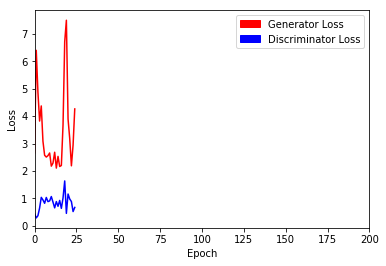

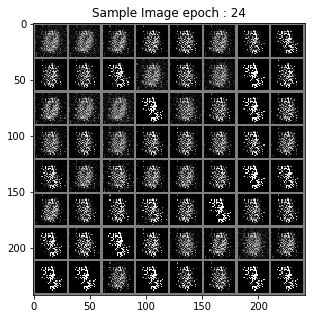

> Epoch : 26 Batch : 19 / 235 Loss_D : 0.2227320671081543 Loss_G : 5.736262798309326
> Epoch : 26 Batch : 39 / 235 Loss_D : 0.2519042193889618 Loss_G : 8.210156440734863
> Epoch : 26 Batch : 59 / 235 Loss_D : 0.566754162311554 Loss_G : 7.016288757324219
> Epoch : 26 Batch : 79 / 235 Loss_D : 0.3954275846481323 Loss_G : 6.093770980834961
> Epoch : 26 Batch : 99 / 235 Loss_D : 0.7737535238265991 Loss_G : 6.604678153991699
> Epoch : 26 Batch : 119 / 235 Loss_D : 1.015421748161316 Loss_G : 5.332157611846924
> Epoch : 26 Batch : 139 / 235 Loss_D : 0.7654146552085876 Loss_G : 4.298666000366211
> Epoch : 26 Batch : 159 / 235 Loss_D : 1.077321171760559 Loss_G : 3.4278724193573
> Epoch : 26 Batch : 179 / 235 Loss_D : 0.36365610361099243 Loss_G : 4.618172645568848
> Epoch : 26 Batch : 199 / 235 Loss_D : 0.49703994393348694 Loss_G : 4.247053146362305
> Epoch : 26 Batch : 219 / 235 Loss_D : 0.40910470485687256 Loss_G : 3.883950710296631


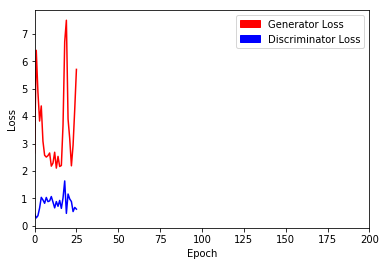

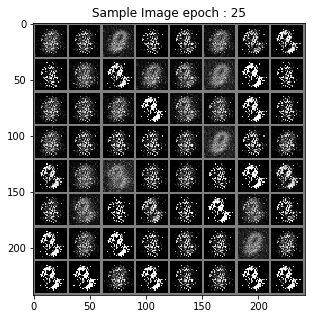

> Epoch : 27 Batch : 19 / 235 Loss_D : 0.7645987868309021 Loss_G : 4.246670722961426
> Epoch : 27 Batch : 39 / 235 Loss_D : 1.4184868335723877 Loss_G : 2.7763757705688477
> Epoch : 27 Batch : 59 / 235 Loss_D : 0.3191221356391907 Loss_G : 5.329510688781738
> Epoch : 27 Batch : 79 / 235 Loss_D : 1.1879770755767822 Loss_G : 4.596231460571289
> Epoch : 27 Batch : 99 / 235 Loss_D : 0.4738950729370117 Loss_G : 4.371182441711426
> Epoch : 27 Batch : 119 / 235 Loss_D : 0.45417508482933044 Loss_G : 5.397418022155762
> Epoch : 27 Batch : 139 / 235 Loss_D : 0.7932121753692627 Loss_G : 5.167425632476807
> Epoch : 27 Batch : 159 / 235 Loss_D : 1.308183193206787 Loss_G : 4.641640663146973
> Epoch : 27 Batch : 179 / 235 Loss_D : 0.20158347487449646 Loss_G : 4.5305562019348145
> Epoch : 27 Batch : 199 / 235 Loss_D : 0.3261834979057312 Loss_G : 4.162978649139404
> Epoch : 27 Batch : 219 / 235 Loss_D : 1.2642641067504883 Loss_G : 4.033831596374512


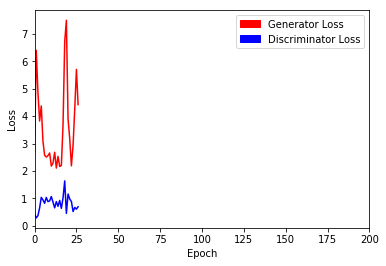

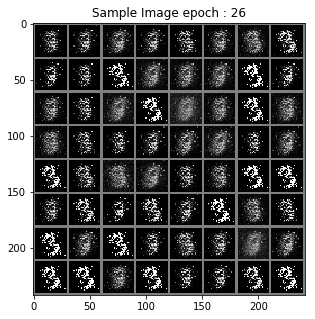

> Epoch : 28 Batch : 19 / 235 Loss_D : 0.7201143503189087 Loss_G : 2.533017158508301
> Epoch : 28 Batch : 39 / 235 Loss_D : 0.4627537727355957 Loss_G : 2.828278064727783
> Epoch : 28 Batch : 59 / 235 Loss_D : 0.7482488751411438 Loss_G : 2.4782724380493164
> Epoch : 28 Batch : 79 / 235 Loss_D : 0.15177050232887268 Loss_G : 3.97011661529541
> Epoch : 28 Batch : 99 / 235 Loss_D : 0.34698426723480225 Loss_G : 3.4826550483703613
> Epoch : 28 Batch : 119 / 235 Loss_D : 0.399711936712265 Loss_G : 3.277238607406616
> Epoch : 28 Batch : 139 / 235 Loss_D : 1.4418554306030273 Loss_G : 3.1575100421905518
> Epoch : 28 Batch : 159 / 235 Loss_D : 0.5816596746444702 Loss_G : 3.0668649673461914
> Epoch : 28 Batch : 179 / 235 Loss_D : 0.9613711833953857 Loss_G : 2.347045421600342
> Epoch : 28 Batch : 199 / 235 Loss_D : 0.30364248156547546 Loss_G : 3.5114574432373047
> Epoch : 28 Batch : 219 / 235 Loss_D : 0.20959293842315674 Loss_G : 3.298985242843628


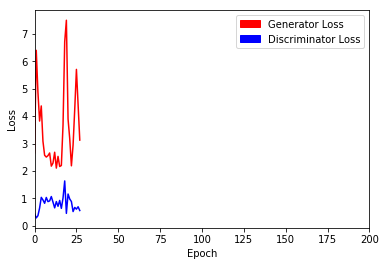

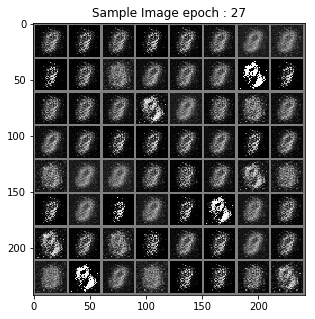

> Epoch : 29 Batch : 19 / 235 Loss_D : 1.006753921508789 Loss_G : 1.3770420551300049
> Epoch : 29 Batch : 39 / 235 Loss_D : 0.4465197026729584 Loss_G : 3.1319580078125
> Epoch : 29 Batch : 59 / 235 Loss_D : 1.294386625289917 Loss_G : 4.96759557723999
> Epoch : 29 Batch : 79 / 235 Loss_D : 1.3387949466705322 Loss_G : 2.3243179321289062
> Epoch : 29 Batch : 99 / 235 Loss_D : 1.6462724208831787 Loss_G : 3.60929012298584
> Epoch : 29 Batch : 119 / 235 Loss_D : 0.6874277591705322 Loss_G : 4.7829694747924805
> Epoch : 29 Batch : 139 / 235 Loss_D : 0.3909047842025757 Loss_G : 3.715001106262207
> Epoch : 29 Batch : 159 / 235 Loss_D : 0.8108569979667664 Loss_G : 4.935416221618652
> Epoch : 29 Batch : 179 / 235 Loss_D : 2.7044715881347656 Loss_G : 2.900053024291992
> Epoch : 29 Batch : 199 / 235 Loss_D : 0.19481143355369568 Loss_G : 5.2369585037231445
> Epoch : 29 Batch : 219 / 235 Loss_D : 0.7171728014945984 Loss_G : 2.9349873065948486


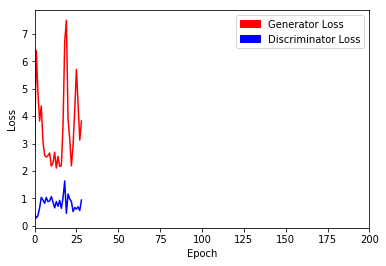

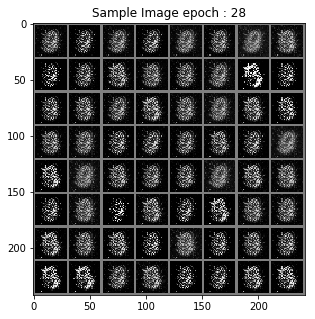

> Epoch : 30 Batch : 19 / 235 Loss_D : 1.1604421138763428 Loss_G : 2.9993512630462646
> Epoch : 30 Batch : 39 / 235 Loss_D : 1.0751256942749023 Loss_G : 2.781782865524292
> Epoch : 30 Batch : 59 / 235 Loss_D : 0.16162937879562378 Loss_G : 4.295670032501221
> Epoch : 30 Batch : 79 / 235 Loss_D : 0.41525018215179443 Loss_G : 3.564941644668579
> Epoch : 30 Batch : 99 / 235 Loss_D : 1.9250433444976807 Loss_G : 2.231069564819336
> Epoch : 30 Batch : 119 / 235 Loss_D : 0.6317787170410156 Loss_G : 3.4149813652038574
> Epoch : 30 Batch : 139 / 235 Loss_D : 0.20036378502845764 Loss_G : 3.759876251220703
> Epoch : 30 Batch : 159 / 235 Loss_D : 0.31038254499435425 Loss_G : 3.418468475341797
> Epoch : 30 Batch : 179 / 235 Loss_D : 0.8378512859344482 Loss_G : 3.4275403022766113
> Epoch : 30 Batch : 199 / 235 Loss_D : 0.6869566440582275 Loss_G : 2.547917604446411
> Epoch : 30 Batch : 219 / 235 Loss_D : 0.34958136081695557 Loss_G : 3.2523069381713867


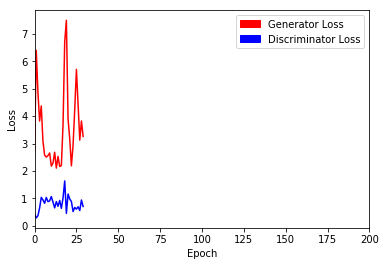

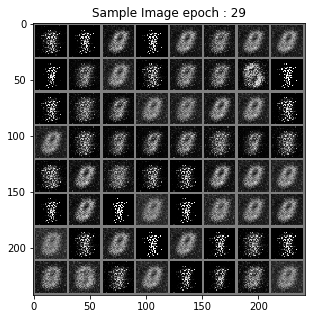

> Epoch : 31 Batch : 19 / 235 Loss_D : 1.2960009574890137 Loss_G : 2.9557783603668213
> Epoch : 31 Batch : 39 / 235 Loss_D : 0.44308528304100037 Loss_G : 3.1763124465942383
> Epoch : 31 Batch : 59 / 235 Loss_D : 0.6987415552139282 Loss_G : 3.2344958782196045
> Epoch : 31 Batch : 79 / 235 Loss_D : 0.6391723155975342 Loss_G : 3.945920467376709
> Epoch : 31 Batch : 99 / 235 Loss_D : 0.7918189764022827 Loss_G : 4.767636299133301
> Epoch : 31 Batch : 119 / 235 Loss_D : 0.7721807360649109 Loss_G : 4.238726615905762
> Epoch : 31 Batch : 139 / 235 Loss_D : 1.6189044713974 Loss_G : 4.408969402313232
> Epoch : 31 Batch : 159 / 235 Loss_D : 0.3970772624015808 Loss_G : 3.7003064155578613
> Epoch : 31 Batch : 179 / 235 Loss_D : 0.38571739196777344 Loss_G : 3.240067958831787
> Epoch : 31 Batch : 199 / 235 Loss_D : 1.2245264053344727 Loss_G : 2.7318551540374756
> Epoch : 31 Batch : 219 / 235 Loss_D : 1.0725669860839844 Loss_G : 3.5302910804748535


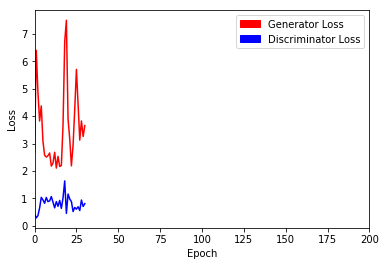

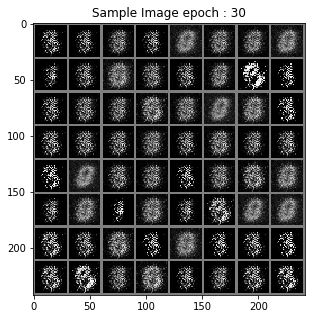

> Epoch : 32 Batch : 19 / 235 Loss_D : 0.7981749176979065 Loss_G : 3.093608856201172
> Epoch : 32 Batch : 39 / 235 Loss_D : 1.1221429109573364 Loss_G : 3.588960647583008
> Epoch : 32 Batch : 59 / 235 Loss_D : 0.7774694561958313 Loss_G : 3.3831212520599365
> Epoch : 32 Batch : 79 / 235 Loss_D : 0.5646923780441284 Loss_G : 2.665557384490967
> Epoch : 32 Batch : 99 / 235 Loss_D : 0.6163721084594727 Loss_G : 3.406806468963623
> Epoch : 32 Batch : 119 / 235 Loss_D : 0.3167535364627838 Loss_G : 4.843438148498535
> Epoch : 32 Batch : 139 / 235 Loss_D : 0.6145073175430298 Loss_G : 3.9411888122558594
> Epoch : 32 Batch : 159 / 235 Loss_D : 1.8716206550598145 Loss_G : 2.0260324478149414
> Epoch : 32 Batch : 179 / 235 Loss_D : 0.11994405835866928 Loss_G : 3.90867280960083
> Epoch : 32 Batch : 199 / 235 Loss_D : 0.21037964522838593 Loss_G : 3.135519027709961
> Epoch : 32 Batch : 219 / 235 Loss_D : 0.23599669337272644 Loss_G : 3.024277687072754


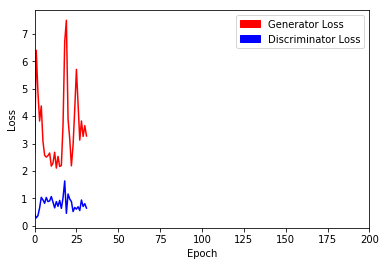

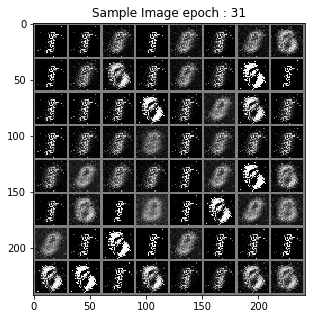

> Epoch : 33 Batch : 19 / 235 Loss_D : 0.3718116283416748 Loss_G : 2.9925270080566406
> Epoch : 33 Batch : 39 / 235 Loss_D : 0.4849286675453186 Loss_G : 2.720911979675293
> Epoch : 33 Batch : 59 / 235 Loss_D : 0.7517746686935425 Loss_G : 2.8201067447662354
> Epoch : 33 Batch : 79 / 235 Loss_D : 0.5830154418945312 Loss_G : 2.9643592834472656
> Epoch : 33 Batch : 99 / 235 Loss_D : 0.41768646240234375 Loss_G : 3.643815040588379
> Epoch : 33 Batch : 119 / 235 Loss_D : 0.2871231138706207 Loss_G : 3.624901056289673
> Epoch : 33 Batch : 139 / 235 Loss_D : 0.5852555632591248 Loss_G : 2.6045010089874268
> Epoch : 33 Batch : 159 / 235 Loss_D : 1.0037423372268677 Loss_G : 1.8500018119812012
> Epoch : 33 Batch : 179 / 235 Loss_D : 0.669579803943634 Loss_G : 2.1825056076049805
> Epoch : 33 Batch : 199 / 235 Loss_D : 0.2968708872795105 Loss_G : 3.4944944381713867
> Epoch : 33 Batch : 219 / 235 Loss_D : 0.5103570818901062 Loss_G : 2.392232894897461


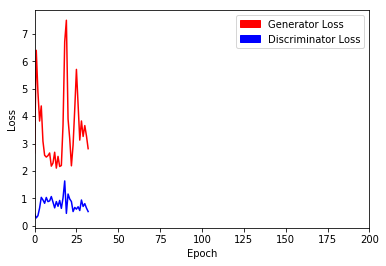

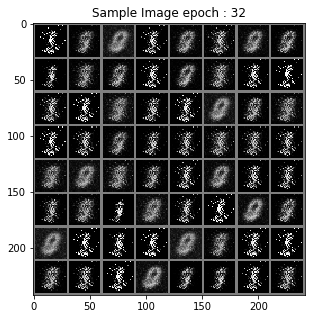

> Epoch : 34 Batch : 19 / 235 Loss_D : 0.44584882259368896 Loss_G : 2.384824275970459
> Epoch : 34 Batch : 39 / 235 Loss_D : 0.5388281345367432 Loss_G : 2.999262571334839
> Epoch : 34 Batch : 59 / 235 Loss_D : 0.31391581892967224 Loss_G : 3.7854442596435547
> Epoch : 34 Batch : 79 / 235 Loss_D : 0.2705915868282318 Loss_G : 3.8315844535827637
> Epoch : 34 Batch : 99 / 235 Loss_D : 0.5654023885726929 Loss_G : 3.571885108947754
> Epoch : 34 Batch : 119 / 235 Loss_D : 0.3830568790435791 Loss_G : 3.6256911754608154
> Epoch : 34 Batch : 139 / 235 Loss_D : 0.4559810161590576 Loss_G : 2.9881739616394043
> Epoch : 34 Batch : 159 / 235 Loss_D : 0.7272753715515137 Loss_G : 3.8429994583129883
> Epoch : 34 Batch : 179 / 235 Loss_D : 0.2861747443675995 Loss_G : 3.800849676132202
> Epoch : 34 Batch : 199 / 235 Loss_D : 0.5145151019096375 Loss_G : 5.12200927734375
> Epoch : 34 Batch : 219 / 235 Loss_D : 0.8658884763717651 Loss_G : 2.391679286956787


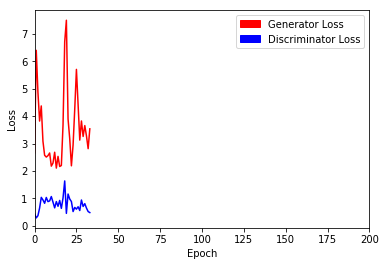

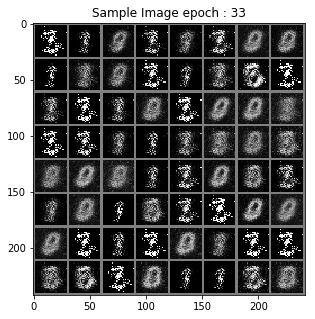

> Epoch : 35 Batch : 19 / 235 Loss_D : 0.39017176628112793 Loss_G : 2.572442054748535
> Epoch : 35 Batch : 39 / 235 Loss_D : 0.4114324450492859 Loss_G : 3.2861287593841553
> Epoch : 35 Batch : 59 / 235 Loss_D : 0.45481282472610474 Loss_G : 2.423710346221924
> Epoch : 35 Batch : 79 / 235 Loss_D : 0.2853756546974182 Loss_G : 4.451797962188721
> Epoch : 35 Batch : 99 / 235 Loss_D : 0.4214318096637726 Loss_G : 4.961765289306641
> Epoch : 35 Batch : 119 / 235 Loss_D : 0.9578561186790466 Loss_G : 2.11940860748291
> Epoch : 35 Batch : 139 / 235 Loss_D : 0.5818215608596802 Loss_G : 3.8007400035858154
> Epoch : 35 Batch : 159 / 235 Loss_D : 0.9271887540817261 Loss_G : 2.868180274963379
> Epoch : 35 Batch : 179 / 235 Loss_D : 0.3960305452346802 Loss_G : 3.88602876663208
> Epoch : 35 Batch : 199 / 235 Loss_D : 0.4259961247444153 Loss_G : 4.587186336517334
> Epoch : 35 Batch : 219 / 235 Loss_D : 0.6705547571182251 Loss_G : 3.9815940856933594


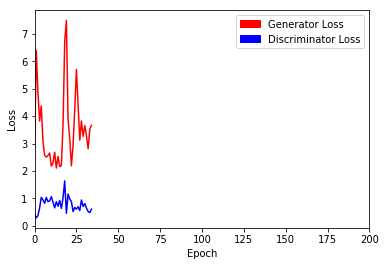

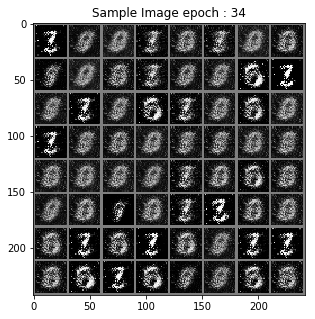

> Epoch : 36 Batch : 19 / 235 Loss_D : 0.6544331312179565 Loss_G : 4.003969669342041
> Epoch : 36 Batch : 39 / 235 Loss_D : 0.5839899182319641 Loss_G : 3.627717971801758
> Epoch : 36 Batch : 59 / 235 Loss_D : 0.7705954313278198 Loss_G : 3.409775495529175
> Epoch : 36 Batch : 79 / 235 Loss_D : 0.960920512676239 Loss_G : 4.7361907958984375
> Epoch : 36 Batch : 99 / 235 Loss_D : 0.7002272605895996 Loss_G : 3.768181562423706
> Epoch : 36 Batch : 119 / 235 Loss_D : 0.5413578152656555 Loss_G : 3.6885976791381836
> Epoch : 36 Batch : 139 / 235 Loss_D : 0.5108727216720581 Loss_G : 3.8555595874786377
> Epoch : 36 Batch : 159 / 235 Loss_D : 0.4874051511287689 Loss_G : 3.6838488578796387
> Epoch : 36 Batch : 179 / 235 Loss_D : 1.3707882165908813 Loss_G : 3.282634973526001
> Epoch : 36 Batch : 199 / 235 Loss_D : 0.9329656362533569 Loss_G : 2.388798952102661
> Epoch : 36 Batch : 219 / 235 Loss_D : 0.18899135291576385 Loss_G : 3.6609764099121094


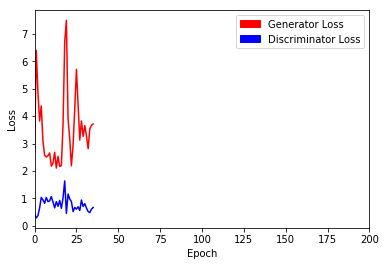

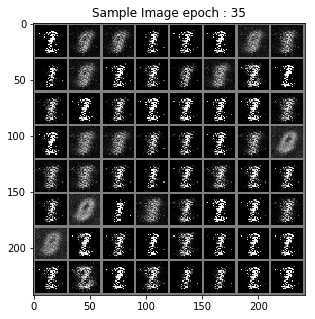

> Epoch : 37 Batch : 19 / 235 Loss_D : 0.4902670383453369 Loss_G : 3.302396774291992
> Epoch : 37 Batch : 39 / 235 Loss_D : 0.9847145080566406 Loss_G : 2.8496923446655273
> Epoch : 37 Batch : 59 / 235 Loss_D : 0.8083032965660095 Loss_G : 2.5032572746276855
> Epoch : 37 Batch : 79 / 235 Loss_D : 0.2585332989692688 Loss_G : 2.962684392929077
> Epoch : 37 Batch : 99 / 235 Loss_D : 0.3564559519290924 Loss_G : 3.042060375213623
> Epoch : 37 Batch : 119 / 235 Loss_D : 0.5591340661048889 Loss_G : 2.6187753677368164
> Epoch : 37 Batch : 139 / 235 Loss_D : 0.3114135265350342 Loss_G : 3.7407655715942383
> Epoch : 37 Batch : 159 / 235 Loss_D : 0.45787757635116577 Loss_G : 2.2902979850769043
> Epoch : 37 Batch : 179 / 235 Loss_D : 0.8180047273635864 Loss_G : 2.1369504928588867
> Epoch : 37 Batch : 199 / 235 Loss_D : 0.47461172938346863 Loss_G : 2.637770652770996
> Epoch : 37 Batch : 219 / 235 Loss_D : 0.5513688921928406 Loss_G : 2.9951930046081543


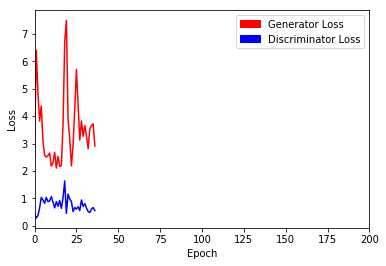

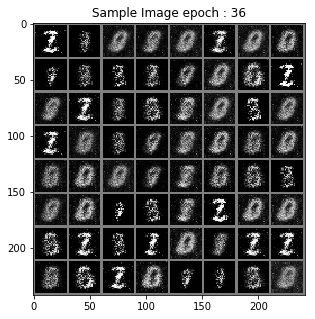

> Epoch : 38 Batch : 19 / 235 Loss_D : 0.49265164136886597 Loss_G : 2.725086212158203
> Epoch : 38 Batch : 39 / 235 Loss_D : 0.6622074246406555 Loss_G : 2.234591245651245
> Epoch : 38 Batch : 59 / 235 Loss_D : 0.45641082525253296 Loss_G : 2.7763125896453857
> Epoch : 38 Batch : 79 / 235 Loss_D : 0.5328752994537354 Loss_G : 3.2735037803649902
> Epoch : 38 Batch : 99 / 235 Loss_D : 0.5255693793296814 Loss_G : 4.01446533203125
> Epoch : 38 Batch : 119 / 235 Loss_D : 0.5817972421646118 Loss_G : 2.5095932483673096
> Epoch : 38 Batch : 139 / 235 Loss_D : 0.3831818699836731 Loss_G : 3.289134979248047
> Epoch : 38 Batch : 159 / 235 Loss_D : 0.44738730788230896 Loss_G : 3.395780086517334
> Epoch : 38 Batch : 179 / 235 Loss_D : 0.8624593019485474 Loss_G : 2.417127847671509
> Epoch : 38 Batch : 199 / 235 Loss_D : 0.17102327942848206 Loss_G : 4.3546013832092285
> Epoch : 38 Batch : 219 / 235 Loss_D : 0.30850332975387573 Loss_G : 3.676175355911255


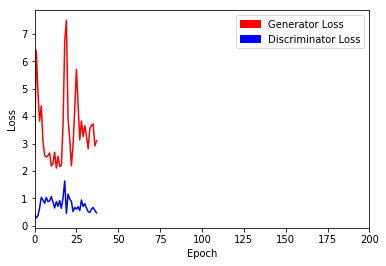

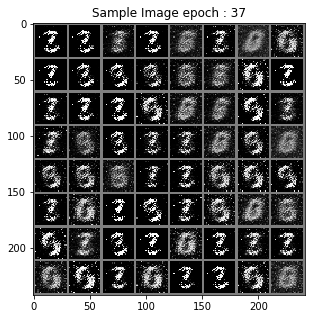

> Epoch : 39 Batch : 19 / 235 Loss_D : 0.4341204762458801 Loss_G : 3.242387294769287
> Epoch : 39 Batch : 39 / 235 Loss_D : 0.3554607033729553 Loss_G : 4.0926313400268555
> Epoch : 39 Batch : 59 / 235 Loss_D : 0.35226860642433167 Loss_G : 3.3777966499328613
> Epoch : 39 Batch : 79 / 235 Loss_D : 0.3132780194282532 Loss_G : 2.6974785327911377
> Epoch : 39 Batch : 99 / 235 Loss_D : 0.2663193643093109 Loss_G : 3.663292169570923
> Epoch : 39 Batch : 119 / 235 Loss_D : 0.5191381573677063 Loss_G : 3.3334243297576904
> Epoch : 39 Batch : 139 / 235 Loss_D : 0.5153199434280396 Loss_G : 4.417055130004883
> Epoch : 39 Batch : 159 / 235 Loss_D : 0.32037562131881714 Loss_G : 2.987668037414551
> Epoch : 39 Batch : 179 / 235 Loss_D : 0.4601288437843323 Loss_G : 2.474547863006592
> Epoch : 39 Batch : 199 / 235 Loss_D : 0.6195898056030273 Loss_G : 2.812717914581299
> Epoch : 39 Batch : 219 / 235 Loss_D : 0.6220964193344116 Loss_G : 2.8653273582458496


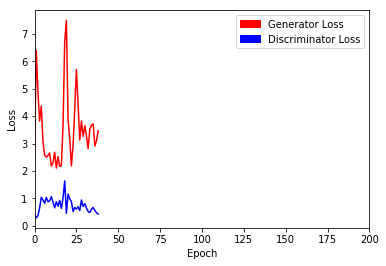

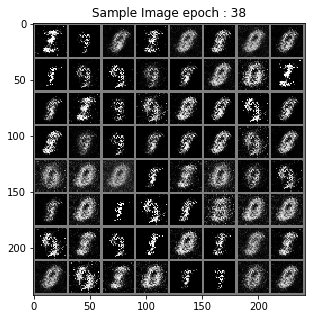

> Epoch : 40 Batch : 19 / 235 Loss_D : 0.38697049021720886 Loss_G : 3.6750903129577637
> Epoch : 40 Batch : 39 / 235 Loss_D : 0.3775346875190735 Loss_G : 4.271183967590332
> Epoch : 40 Batch : 59 / 235 Loss_D : 0.2554604411125183 Loss_G : 3.6876816749572754
> Epoch : 40 Batch : 79 / 235 Loss_D : 0.25326263904571533 Loss_G : 4.354684352874756
> Epoch : 40 Batch : 99 / 235 Loss_D : 0.32825878262519836 Loss_G : 3.3846826553344727
> Epoch : 40 Batch : 119 / 235 Loss_D : 0.401120126247406 Loss_G : 5.461485862731934
> Epoch : 40 Batch : 139 / 235 Loss_D : 0.6663721799850464 Loss_G : 3.402785301208496
> Epoch : 40 Batch : 159 / 235 Loss_D : 0.2688990831375122 Loss_G : 4.255374908447266
> Epoch : 40 Batch : 179 / 235 Loss_D : 0.271066814661026 Loss_G : 4.423793792724609
> Epoch : 40 Batch : 199 / 235 Loss_D : 0.23181259632110596 Loss_G : 4.563554763793945
> Epoch : 40 Batch : 219 / 235 Loss_D : 0.19827671349048615 Loss_G : 5.493947982788086


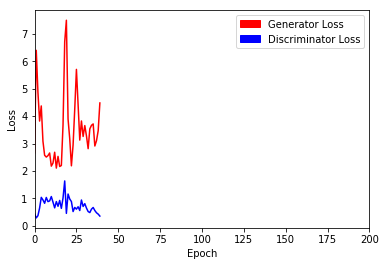

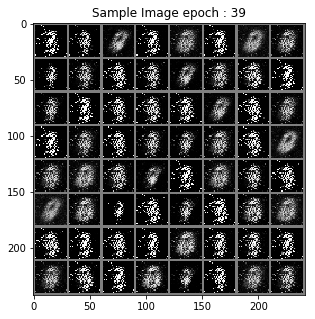

> Epoch : 41 Batch : 19 / 235 Loss_D : 0.19076290726661682 Loss_G : 4.984836578369141
> Epoch : 41 Batch : 39 / 235 Loss_D : 0.5350239276885986 Loss_G : 5.6263628005981445
> Epoch : 41 Batch : 59 / 235 Loss_D : 0.35428857803344727 Loss_G : 3.859689235687256
> Epoch : 41 Batch : 79 / 235 Loss_D : 0.13533836603164673 Loss_G : 5.811388969421387
> Epoch : 41 Batch : 99 / 235 Loss_D : 0.21642562747001648 Loss_G : 5.961549758911133
> Epoch : 41 Batch : 119 / 235 Loss_D : 1.9113619327545166 Loss_G : 7.947273254394531
> Epoch : 41 Batch : 139 / 235 Loss_D : 0.4565429091453552 Loss_G : 10.94214153289795
> Epoch : 41 Batch : 159 / 235 Loss_D : 0.6844783425331116 Loss_G : 8.584529876708984
> Epoch : 41 Batch : 179 / 235 Loss_D : 0.5290376543998718 Loss_G : 7.0716681480407715
> Epoch : 41 Batch : 199 / 235 Loss_D : 1.517073631286621 Loss_G : 6.664125442504883
> Epoch : 41 Batch : 219 / 235 Loss_D : 0.39563414454460144 Loss_G : 7.754763603210449


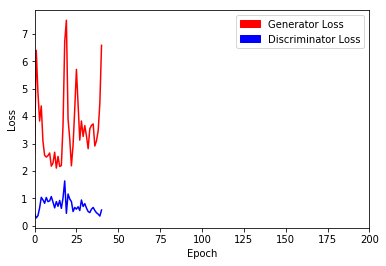

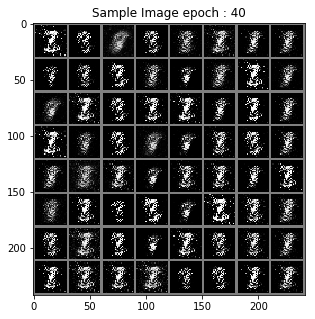

> Epoch : 42 Batch : 19 / 235 Loss_D : 0.4788706302642822 Loss_G : 4.861920356750488
> Epoch : 42 Batch : 39 / 235 Loss_D : 0.28798770904541016 Loss_G : 5.059778213500977
> Epoch : 42 Batch : 59 / 235 Loss_D : 0.21491897106170654 Loss_G : 6.514944076538086
> Epoch : 42 Batch : 79 / 235 Loss_D : 0.12934944033622742 Loss_G : 6.56709098815918
> Epoch : 42 Batch : 99 / 235 Loss_D : 0.31288856267929077 Loss_G : 5.695705413818359
> Epoch : 42 Batch : 119 / 235 Loss_D : 0.5569786429405212 Loss_G : 5.202038764953613
> Epoch : 42 Batch : 139 / 235 Loss_D : 0.2544482350349426 Loss_G : 5.364483833312988
> Epoch : 42 Batch : 159 / 235 Loss_D : 0.608665943145752 Loss_G : 6.662003517150879
> Epoch : 42 Batch : 179 / 235 Loss_D : 0.33465129137039185 Loss_G : 4.8896074295043945
> Epoch : 42 Batch : 199 / 235 Loss_D : 0.1610083281993866 Loss_G : 5.115154266357422
> Epoch : 42 Batch : 219 / 235 Loss_D : 0.3035936951637268 Loss_G : 4.773212432861328


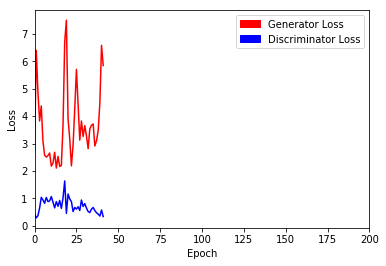

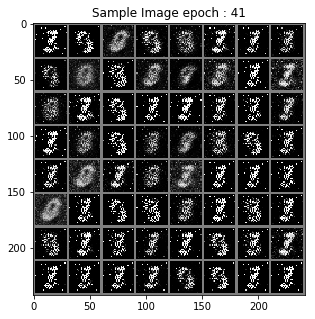

> Epoch : 43 Batch : 19 / 235 Loss_D : 0.2626214623451233 Loss_G : 3.997161388397217
> Epoch : 43 Batch : 39 / 235 Loss_D : 0.26856935024261475 Loss_G : 4.687572002410889
> Epoch : 43 Batch : 59 / 235 Loss_D : 0.1768607795238495 Loss_G : 5.251816749572754
> Epoch : 43 Batch : 79 / 235 Loss_D : 0.21671587228775024 Loss_G : 4.847331523895264
> Epoch : 43 Batch : 99 / 235 Loss_D : 0.23120750486850739 Loss_G : 5.3202409744262695
> Epoch : 43 Batch : 119 / 235 Loss_D : 0.16906848549842834 Loss_G : 4.583984375
> Epoch : 43 Batch : 139 / 235 Loss_D : 0.4902070164680481 Loss_G : 5.764980316162109
> Epoch : 43 Batch : 159 / 235 Loss_D : 0.17170313000679016 Loss_G : 5.44874906539917
> Epoch : 43 Batch : 179 / 235 Loss_D : 0.28442132472991943 Loss_G : 5.37470817565918
> Epoch : 43 Batch : 199 / 235 Loss_D : 0.49042364954948425 Loss_G : 4.10946798324585
> Epoch : 43 Batch : 219 / 235 Loss_D : 0.37184134125709534 Loss_G : 5.6479902267456055


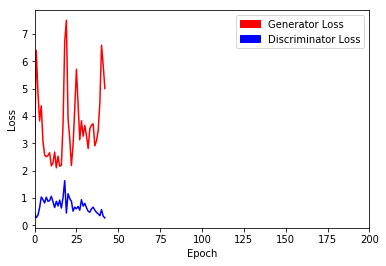

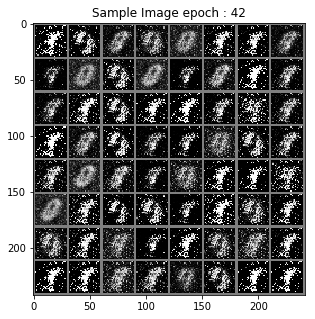

> Epoch : 44 Batch : 19 / 235 Loss_D : 0.25665023922920227 Loss_G : 6.860381126403809
> Epoch : 44 Batch : 39 / 235 Loss_D : 0.24314884841442108 Loss_G : 5.969720363616943
> Epoch : 44 Batch : 59 / 235 Loss_D : 0.6738980412483215 Loss_G : 5.102586269378662
> Epoch : 44 Batch : 79 / 235 Loss_D : 0.7955957055091858 Loss_G : 7.324672222137451
> Epoch : 44 Batch : 99 / 235 Loss_D : 0.28547602891921997 Loss_G : 5.638484954833984
> Epoch : 44 Batch : 119 / 235 Loss_D : 0.5551154613494873 Loss_G : 3.82267427444458
> Epoch : 44 Batch : 139 / 235 Loss_D : 0.745256781578064 Loss_G : 4.275704383850098
> Epoch : 44 Batch : 159 / 235 Loss_D : 0.1343277245759964 Loss_G : 3.4939093589782715
> Epoch : 44 Batch : 179 / 235 Loss_D : 0.6080225706100464 Loss_G : 4.9087677001953125
> Epoch : 44 Batch : 199 / 235 Loss_D : 0.5363056659698486 Loss_G : 3.8365087509155273
> Epoch : 44 Batch : 219 / 235 Loss_D : 0.4597551226615906 Loss_G : 4.139468669891357


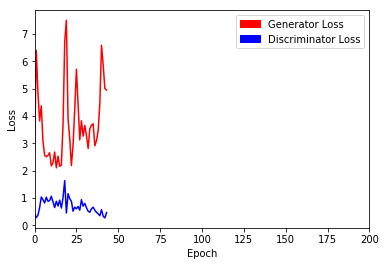

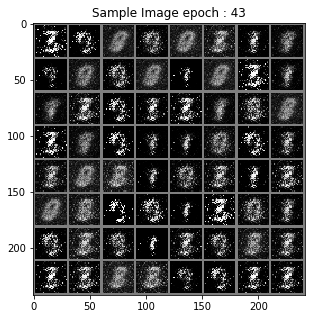

> Epoch : 45 Batch : 19 / 235 Loss_D : 0.3384239077568054 Loss_G : 3.429802417755127
> Epoch : 45 Batch : 39 / 235 Loss_D : 0.4599361717700958 Loss_G : 3.016240119934082
> Epoch : 45 Batch : 59 / 235 Loss_D : 0.5245814919471741 Loss_G : 3.374685764312744
> Epoch : 45 Batch : 79 / 235 Loss_D : 0.3593611717224121 Loss_G : 2.6048059463500977
> Epoch : 45 Batch : 99 / 235 Loss_D : 0.3697431683540344 Loss_G : 2.4526076316833496
> Epoch : 45 Batch : 119 / 235 Loss_D : 0.31020060181617737 Loss_G : 3.449178695678711
> Epoch : 45 Batch : 139 / 235 Loss_D : 0.3691675662994385 Loss_G : 3.884763717651367
> Epoch : 45 Batch : 159 / 235 Loss_D : 0.6207399368286133 Loss_G : 3.774648666381836
> Epoch : 45 Batch : 179 / 235 Loss_D : 0.24085471034049988 Loss_G : 4.998327255249023
> Epoch : 45 Batch : 199 / 235 Loss_D : 0.3361954689025879 Loss_G : 4.965614318847656
> Epoch : 45 Batch : 219 / 235 Loss_D : 0.3113635778427124 Loss_G : 5.391162395477295


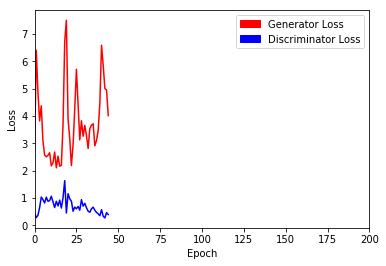

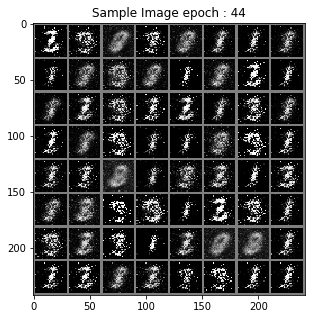

> Epoch : 46 Batch : 19 / 235 Loss_D : 0.43496114015579224 Loss_G : 4.835501670837402
> Epoch : 46 Batch : 39 / 235 Loss_D : 0.3996202051639557 Loss_G : 4.454166412353516
> Epoch : 46 Batch : 59 / 235 Loss_D : 0.5204730033874512 Loss_G : 2.8861284255981445
> Epoch : 46 Batch : 79 / 235 Loss_D : 0.5267231464385986 Loss_G : 4.681097984313965
> Epoch : 46 Batch : 99 / 235 Loss_D : 0.5130342841148376 Loss_G : 4.014670372009277
> Epoch : 46 Batch : 119 / 235 Loss_D : 0.25606662034988403 Loss_G : 3.7379064559936523
> Epoch : 46 Batch : 139 / 235 Loss_D : 0.33728790283203125 Loss_G : 2.926564931869507
> Epoch : 46 Batch : 159 / 235 Loss_D : 0.32076650857925415 Loss_G : 2.8475608825683594
> Epoch : 46 Batch : 179 / 235 Loss_D : 0.2945084273815155 Loss_G : 2.589310884475708
> Epoch : 46 Batch : 199 / 235 Loss_D : 0.22640880942344666 Loss_G : 3.150595188140869
> Epoch : 46 Batch : 219 / 235 Loss_D : 0.33791518211364746 Loss_G : 2.8663148880004883


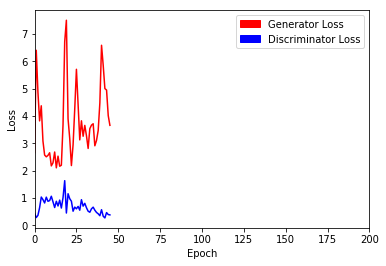

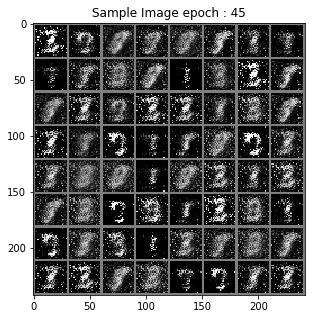

> Epoch : 47 Batch : 19 / 235 Loss_D : 0.2607385516166687 Loss_G : 4.052225112915039
> Epoch : 47 Batch : 39 / 235 Loss_D : 0.2296087145805359 Loss_G : 3.9916210174560547
> Epoch : 47 Batch : 59 / 235 Loss_D : 0.550603985786438 Loss_G : 3.1591763496398926
> Epoch : 47 Batch : 79 / 235 Loss_D : 0.9274584650993347 Loss_G : 4.81440544128418
> Epoch : 47 Batch : 99 / 235 Loss_D : 0.4484357237815857 Loss_G : 4.346942901611328
> Epoch : 47 Batch : 119 / 235 Loss_D : 0.28676173090934753 Loss_G : 5.46957540512085
> Epoch : 47 Batch : 139 / 235 Loss_D : 0.41922467947006226 Loss_G : 3.893165111541748
> Epoch : 47 Batch : 159 / 235 Loss_D : 0.3918657898902893 Loss_G : 3.38394832611084
> Epoch : 47 Batch : 179 / 235 Loss_D : 0.2349504977464676 Loss_G : 3.392263889312744
> Epoch : 47 Batch : 199 / 235 Loss_D : 0.5017364025115967 Loss_G : 2.230379581451416
> Epoch : 47 Batch : 219 / 235 Loss_D : 1.0651066303253174 Loss_G : 2.6395747661590576


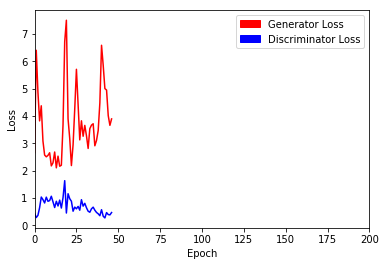

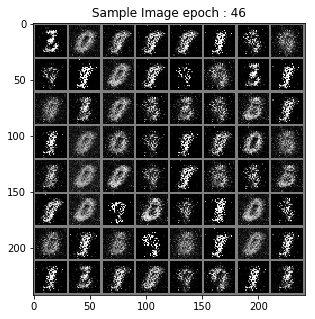

> Epoch : 48 Batch : 19 / 235 Loss_D : 0.296332448720932 Loss_G : 3.5206785202026367
> Epoch : 48 Batch : 39 / 235 Loss_D : 0.11747947335243225 Loss_G : 3.9802770614624023
> Epoch : 48 Batch : 59 / 235 Loss_D : 0.31797105073928833 Loss_G : 3.901392936706543
> Epoch : 48 Batch : 79 / 235 Loss_D : 0.7802882194519043 Loss_G : 4.259257793426514
> Epoch : 48 Batch : 99 / 235 Loss_D : 0.2826627194881439 Loss_G : 3.3762216567993164
> Epoch : 48 Batch : 119 / 235 Loss_D : 0.316108375787735 Loss_G : 4.37040901184082
> Epoch : 48 Batch : 139 / 235 Loss_D : 0.38873428106307983 Loss_G : 4.031329154968262
> Epoch : 48 Batch : 159 / 235 Loss_D : 0.36931756138801575 Loss_G : 5.692709445953369
> Epoch : 48 Batch : 179 / 235 Loss_D : 0.29979628324508667 Loss_G : 3.9674878120422363
> Epoch : 48 Batch : 199 / 235 Loss_D : 0.30722230672836304 Loss_G : 4.26338005065918
> Epoch : 48 Batch : 219 / 235 Loss_D : 0.606813907623291 Loss_G : 3.7732033729553223


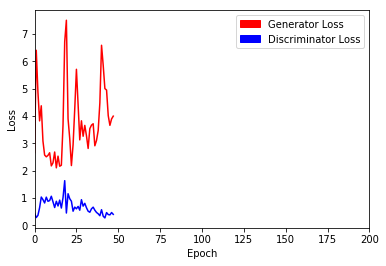

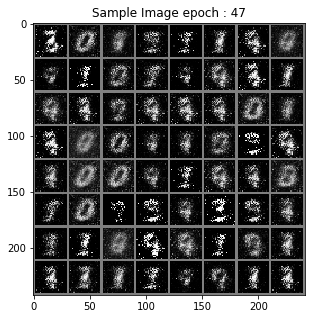

> Epoch : 49 Batch : 19 / 235 Loss_D : 0.3809378147125244 Loss_G : 3.2783567905426025
> Epoch : 49 Batch : 39 / 235 Loss_D : 0.46843409538269043 Loss_G : 3.1340346336364746
> Epoch : 49 Batch : 59 / 235 Loss_D : 0.37360668182373047 Loss_G : 3.1846063137054443
> Epoch : 49 Batch : 79 / 235 Loss_D : 0.4295824468135834 Loss_G : 3.075465679168701
> Epoch : 49 Batch : 99 / 235 Loss_D : 0.2534894347190857 Loss_G : 3.2552833557128906
> Epoch : 49 Batch : 119 / 235 Loss_D : 0.29001131653785706 Loss_G : 2.8346524238586426
> Epoch : 49 Batch : 139 / 235 Loss_D : 0.2455175817012787 Loss_G : 3.3175508975982666
> Epoch : 49 Batch : 159 / 235 Loss_D : 0.4985555410385132 Loss_G : 3.920647144317627
> Epoch : 49 Batch : 179 / 235 Loss_D : 0.43497443199157715 Loss_G : 4.439823627471924
> Epoch : 49 Batch : 199 / 235 Loss_D : 0.47905799746513367 Loss_G : 2.9019808769226074
> Epoch : 49 Batch : 219 / 235 Loss_D : 0.6598052978515625 Loss_G : 3.5320849418640137


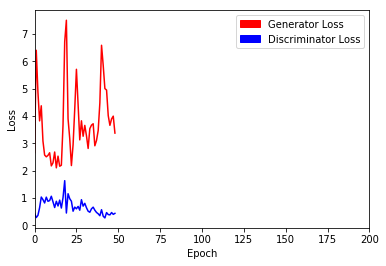

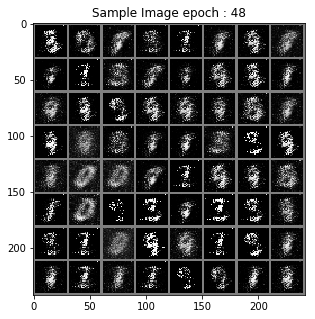

> Epoch : 50 Batch : 19 / 235 Loss_D : 0.21834877133369446 Loss_G : 3.9330904483795166
> Epoch : 50 Batch : 39 / 235 Loss_D : 0.32032838463783264 Loss_G : 4.392221450805664
> Epoch : 50 Batch : 59 / 235 Loss_D : 0.7395539283752441 Loss_G : 4.087789535522461
> Epoch : 50 Batch : 79 / 235 Loss_D : 0.575103759765625 Loss_G : 4.145031929016113
> Epoch : 50 Batch : 99 / 235 Loss_D : 0.4309951663017273 Loss_G : 3.1039345264434814
> Epoch : 50 Batch : 119 / 235 Loss_D : 0.35214483737945557 Loss_G : 3.2335076332092285
> Epoch : 50 Batch : 139 / 235 Loss_D : 0.4293038249015808 Loss_G : 3.835601568222046
> Epoch : 50 Batch : 159 / 235 Loss_D : 0.27441465854644775 Loss_G : 3.266443967819214
> Epoch : 50 Batch : 179 / 235 Loss_D : 0.5166373252868652 Loss_G : 3.243314266204834
> Epoch : 50 Batch : 199 / 235 Loss_D : 0.36124473810195923 Loss_G : 2.8832247257232666
> Epoch : 50 Batch : 219 / 235 Loss_D : 0.3804311752319336 Loss_G : 2.7061829566955566


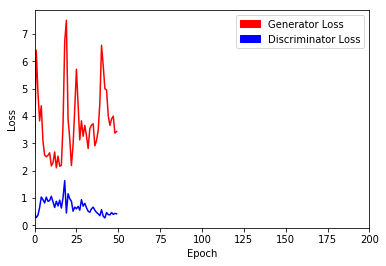

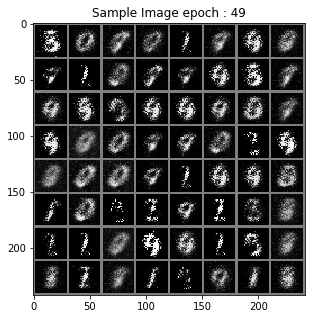

> Epoch : 51 Batch : 19 / 235 Loss_D : 0.2782578468322754 Loss_G : 4.068781852722168
> Epoch : 51 Batch : 39 / 235 Loss_D : 0.28661876916885376 Loss_G : 3.5128989219665527
> Epoch : 51 Batch : 59 / 235 Loss_D : 0.23172736167907715 Loss_G : 4.655385971069336
> Epoch : 51 Batch : 79 / 235 Loss_D : 0.4555758535861969 Loss_G : 3.7465572357177734
> Epoch : 51 Batch : 99 / 235 Loss_D : 0.500029981136322 Loss_G : 3.0210318565368652
> Epoch : 51 Batch : 119 / 235 Loss_D : 0.2005612552165985 Loss_G : 3.9798803329467773
> Epoch : 51 Batch : 139 / 235 Loss_D : 0.17832696437835693 Loss_G : 4.06089448928833
> Epoch : 51 Batch : 159 / 235 Loss_D : 0.29413485527038574 Loss_G : 3.335634231567383
> Epoch : 51 Batch : 179 / 235 Loss_D : 0.43018585443496704 Loss_G : 3.637346029281616
> Epoch : 51 Batch : 199 / 235 Loss_D : 0.33237195014953613 Loss_G : 4.373218536376953
> Epoch : 51 Batch : 219 / 235 Loss_D : 0.36296817660331726 Loss_G : 5.089658260345459


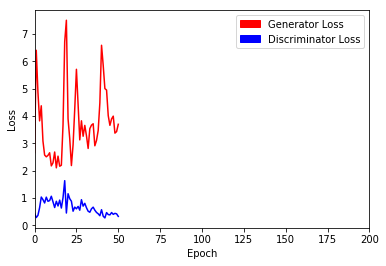

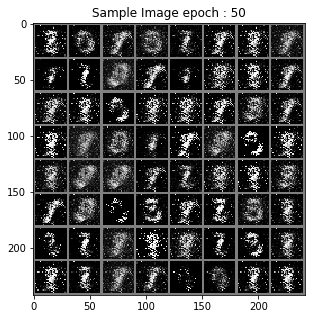

> Epoch : 52 Batch : 19 / 235 Loss_D : 0.30240434408187866 Loss_G : 5.515360355377197
> Epoch : 52 Batch : 39 / 235 Loss_D : 0.4452989101409912 Loss_G : 6.040363788604736
> Epoch : 52 Batch : 59 / 235 Loss_D : 0.49073439836502075 Loss_G : 7.477690696716309
> Epoch : 52 Batch : 79 / 235 Loss_D : 0.4780759811401367 Loss_G : 5.397833824157715
> Epoch : 52 Batch : 99 / 235 Loss_D : 0.8945953249931335 Loss_G : 3.5793333053588867
> Epoch : 52 Batch : 119 / 235 Loss_D : 0.5361031293869019 Loss_G : 4.757976531982422
> Epoch : 52 Batch : 139 / 235 Loss_D : 0.49455827474594116 Loss_G : 5.544095993041992
> Epoch : 52 Batch : 159 / 235 Loss_D : 0.25633904337882996 Loss_G : 5.100713729858398
> Epoch : 52 Batch : 179 / 235 Loss_D : 0.2986711263656616 Loss_G : 6.600825786590576
> Epoch : 52 Batch : 199 / 235 Loss_D : 0.7666440010070801 Loss_G : 6.672471046447754
> Epoch : 52 Batch : 219 / 235 Loss_D : 0.45224249362945557 Loss_G : 5.087800979614258


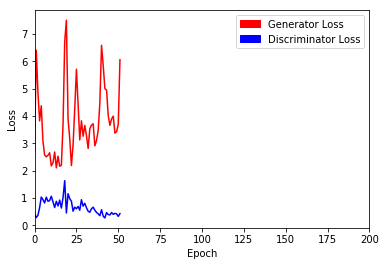

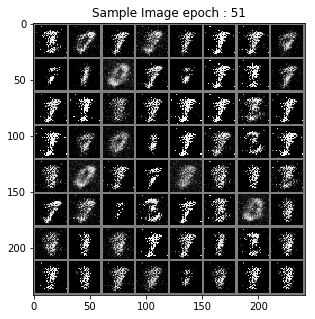

> Epoch : 53 Batch : 19 / 235 Loss_D : 0.7191800475120544 Loss_G : 5.965432167053223
> Epoch : 53 Batch : 39 / 235 Loss_D : 0.5318090319633484 Loss_G : 7.22862434387207
> Epoch : 53 Batch : 59 / 235 Loss_D : 0.26455026865005493 Loss_G : 5.723649024963379
> Epoch : 53 Batch : 79 / 235 Loss_D : 0.6487288475036621 Loss_G : 7.539970874786377
> Epoch : 53 Batch : 99 / 235 Loss_D : 0.4628311097621918 Loss_G : 4.994478225708008
> Epoch : 53 Batch : 119 / 235 Loss_D : 0.3138957619667053 Loss_G : 5.594402313232422
> Epoch : 53 Batch : 139 / 235 Loss_D : 0.6069965958595276 Loss_G : 3.765064239501953
> Epoch : 53 Batch : 159 / 235 Loss_D : 0.48727482557296753 Loss_G : 4.17837381362915
> Epoch : 53 Batch : 179 / 235 Loss_D : 0.8544549942016602 Loss_G : 4.428004264831543
> Epoch : 53 Batch : 199 / 235 Loss_D : 0.5293721556663513 Loss_G : 3.3870115280151367
> Epoch : 53 Batch : 219 / 235 Loss_D : 0.3001798987388611 Loss_G : 5.255682945251465


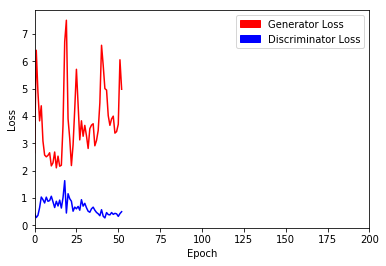

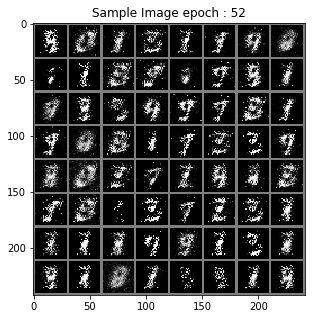

> Epoch : 54 Batch : 19 / 235 Loss_D : 0.4914746880531311 Loss_G : 4.3773908615112305
> Epoch : 54 Batch : 39 / 235 Loss_D : 0.6141020655632019 Loss_G : 4.223438739776611
> Epoch : 54 Batch : 59 / 235 Loss_D : 0.5146563649177551 Loss_G : 3.360537052154541
> Epoch : 54 Batch : 79 / 235 Loss_D : 0.3558986186981201 Loss_G : 4.439299583435059
> Epoch : 54 Batch : 99 / 235 Loss_D : 0.32451266050338745 Loss_G : 4.666979789733887
> Epoch : 54 Batch : 119 / 235 Loss_D : 0.42207619547843933 Loss_G : 5.0114240646362305
> Epoch : 54 Batch : 139 / 235 Loss_D : 0.26336467266082764 Loss_G : 4.332414627075195
> Epoch : 54 Batch : 159 / 235 Loss_D : 0.29934465885162354 Loss_G : 5.303007125854492
> Epoch : 54 Batch : 179 / 235 Loss_D : 0.5100648999214172 Loss_G : 4.840508460998535
> Epoch : 54 Batch : 199 / 235 Loss_D : 0.7684492468833923 Loss_G : 3.5463383197784424
> Epoch : 54 Batch : 219 / 235 Loss_D : 0.6741141080856323 Loss_G : 1.9789278507232666


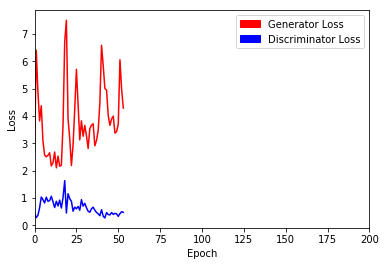

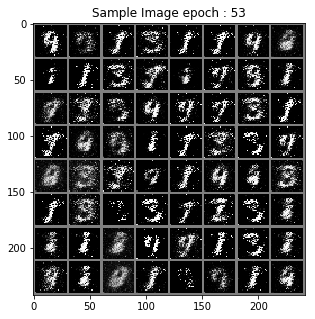

> Epoch : 55 Batch : 19 / 235 Loss_D : 0.26123136281967163 Loss_G : 4.199384689331055
> Epoch : 55 Batch : 39 / 235 Loss_D : 0.19858868420124054 Loss_G : 4.618592262268066
> Epoch : 55 Batch : 59 / 235 Loss_D : 0.18215997517108917 Loss_G : 3.3322911262512207
> Epoch : 55 Batch : 79 / 235 Loss_D : 0.2911054491996765 Loss_G : 3.8294100761413574
> Epoch : 55 Batch : 99 / 235 Loss_D : 0.28550073504447937 Loss_G : 4.194242477416992
> Epoch : 55 Batch : 119 / 235 Loss_D : 0.19280873239040375 Loss_G : 3.1075243949890137
> Epoch : 55 Batch : 139 / 235 Loss_D : 0.25372645258903503 Loss_G : 3.661728858947754
> Epoch : 55 Batch : 159 / 235 Loss_D : 0.2217094898223877 Loss_G : 3.9937143325805664
> Epoch : 55 Batch : 179 / 235 Loss_D : 0.19233214855194092 Loss_G : 4.18303108215332
> Epoch : 55 Batch : 199 / 235 Loss_D : 0.15806394815444946 Loss_G : 5.392959117889404
> Epoch : 55 Batch : 219 / 235 Loss_D : 0.25951117277145386 Loss_G : 6.143787860870361


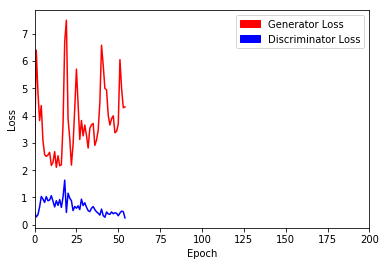

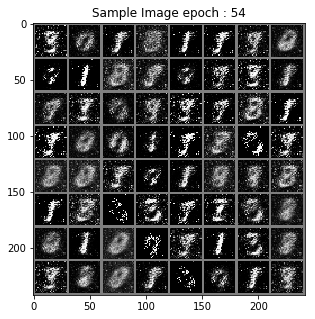

> Epoch : 56 Batch : 19 / 235 Loss_D : 0.22357559204101562 Loss_G : 4.7276411056518555
> Epoch : 56 Batch : 39 / 235 Loss_D : 0.33292603492736816 Loss_G : 4.125918865203857
> Epoch : 56 Batch : 59 / 235 Loss_D : 0.1600053608417511 Loss_G : 3.2783617973327637
> Epoch : 56 Batch : 79 / 235 Loss_D : 0.29300791025161743 Loss_G : 4.7033233642578125
> Epoch : 56 Batch : 99 / 235 Loss_D : 0.35336869955062866 Loss_G : 4.167737007141113
> Epoch : 56 Batch : 119 / 235 Loss_D : 0.44198715686798096 Loss_G : 3.5218043327331543
> Epoch : 56 Batch : 139 / 235 Loss_D : 0.2231910526752472 Loss_G : 4.404653072357178
> Epoch : 56 Batch : 159 / 235 Loss_D : 0.29551562666893005 Loss_G : 5.180164337158203
> Epoch : 56 Batch : 179 / 235 Loss_D : 0.2581656575202942 Loss_G : 4.69741678237915
> Epoch : 56 Batch : 199 / 235 Loss_D : 0.37568435072898865 Loss_G : 3.270265579223633
> Epoch : 56 Batch : 219 / 235 Loss_D : 0.3958214819431305 Loss_G : 3.0399727821350098


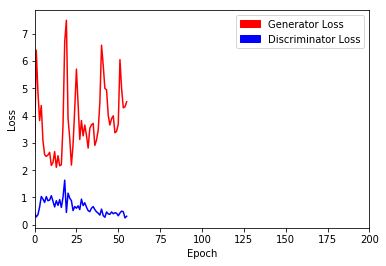

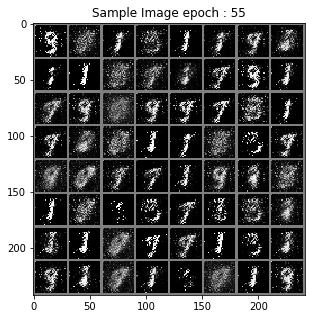

> Epoch : 57 Batch : 19 / 235 Loss_D : 0.3618467152118683 Loss_G : 4.271231174468994
> Epoch : 57 Batch : 39 / 235 Loss_D : 0.18043065071105957 Loss_G : 4.855184555053711
> Epoch : 57 Batch : 59 / 235 Loss_D : 0.15604496002197266 Loss_G : 6.455564975738525
> Epoch : 57 Batch : 79 / 235 Loss_D : 0.40927430987358093 Loss_G : 3.751702070236206
> Epoch : 57 Batch : 99 / 235 Loss_D : 0.4688071012496948 Loss_G : 4.64468240737915
> Epoch : 57 Batch : 119 / 235 Loss_D : 0.3474733531475067 Loss_G : 4.419545650482178
> Epoch : 57 Batch : 139 / 235 Loss_D : 0.2850046753883362 Loss_G : 4.798495769500732
> Epoch : 57 Batch : 159 / 235 Loss_D : 0.11494304239749908 Loss_G : 5.105321884155273
> Epoch : 57 Batch : 179 / 235 Loss_D : 0.16398800909519196 Loss_G : 6.157814979553223
> Epoch : 57 Batch : 199 / 235 Loss_D : 0.20441535115242004 Loss_G : 7.268795967102051
> Epoch : 57 Batch : 219 / 235 Loss_D : 0.4899951219558716 Loss_G : 5.3650360107421875


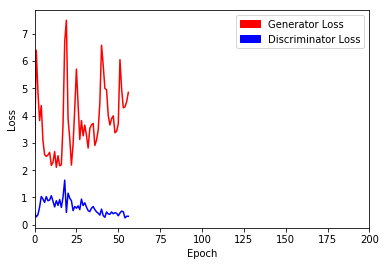

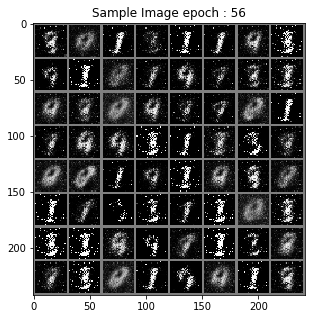

> Epoch : 58 Batch : 19 / 235 Loss_D : 0.3035287857055664 Loss_G : 3.978764533996582
> Epoch : 58 Batch : 39 / 235 Loss_D : 0.1752617210149765 Loss_G : 5.625268936157227
> Epoch : 58 Batch : 59 / 235 Loss_D : 0.4746468663215637 Loss_G : 4.665834903717041
> Epoch : 58 Batch : 79 / 235 Loss_D : 0.2430950403213501 Loss_G : 5.732729911804199
> Epoch : 58 Batch : 99 / 235 Loss_D : 0.4882613718509674 Loss_G : 4.143342018127441
> Epoch : 58 Batch : 119 / 235 Loss_D : 0.4157954454421997 Loss_G : 3.5053508281707764
> Epoch : 58 Batch : 139 / 235 Loss_D : 0.3755800127983093 Loss_G : 4.87785530090332
> Epoch : 58 Batch : 159 / 235 Loss_D : 0.33023494482040405 Loss_G : 5.006906032562256
> Epoch : 58 Batch : 179 / 235 Loss_D : 0.6021358966827393 Loss_G : 4.157451152801514
> Epoch : 58 Batch : 199 / 235 Loss_D : 0.4896972179412842 Loss_G : 4.709861755371094
> Epoch : 58 Batch : 219 / 235 Loss_D : 0.4184645414352417 Loss_G : 4.471776485443115


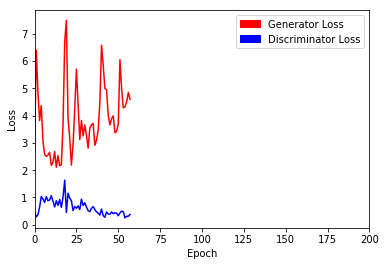

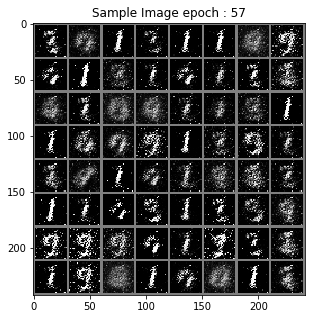

> Epoch : 59 Batch : 19 / 235 Loss_D : 0.3867945075035095 Loss_G : 6.0713114738464355
> Epoch : 59 Batch : 39 / 235 Loss_D : 0.8141660690307617 Loss_G : 4.692044258117676
> Epoch : 59 Batch : 59 / 235 Loss_D : 0.8587666153907776 Loss_G : 5.889956474304199
> Epoch : 59 Batch : 79 / 235 Loss_D : 0.33344149589538574 Loss_G : 6.641872406005859
> Epoch : 59 Batch : 99 / 235 Loss_D : 0.547821044921875 Loss_G : 4.496028900146484
> Epoch : 59 Batch : 119 / 235 Loss_D : 0.45500868558883667 Loss_G : 4.293525695800781
> Epoch : 59 Batch : 139 / 235 Loss_D : 0.4387314021587372 Loss_G : 4.099263668060303
> Epoch : 59 Batch : 159 / 235 Loss_D : 0.4408068060874939 Loss_G : 4.821338653564453
> Epoch : 59 Batch : 179 / 235 Loss_D : 0.35921710729599 Loss_G : 4.790805816650391
> Epoch : 59 Batch : 199 / 235 Loss_D : 0.3747977018356323 Loss_G : 5.6151299476623535
> Epoch : 59 Batch : 219 / 235 Loss_D : 0.276029497385025 Loss_G : 5.197379112243652


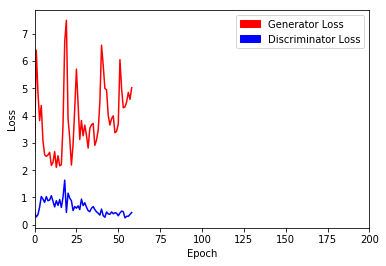

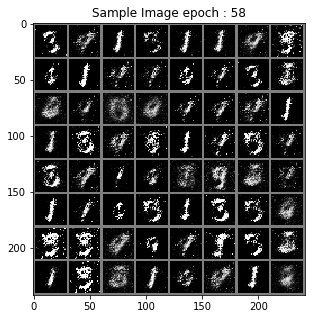

> Epoch : 60 Batch : 19 / 235 Loss_D : 0.7721316814422607 Loss_G : 4.552002429962158
> Epoch : 60 Batch : 39 / 235 Loss_D : 0.5066307187080383 Loss_G : 4.629951000213623
> Epoch : 60 Batch : 59 / 235 Loss_D : 0.452791690826416 Loss_G : 3.095816135406494
> Epoch : 60 Batch : 79 / 235 Loss_D : 0.9720141887664795 Loss_G : 3.1750473976135254
> Epoch : 60 Batch : 99 / 235 Loss_D : 0.5603017807006836 Loss_G : 2.4705514907836914
> Epoch : 60 Batch : 119 / 235 Loss_D : 0.2678295075893402 Loss_G : 2.8051254749298096
> Epoch : 60 Batch : 139 / 235 Loss_D : 0.396492600440979 Loss_G : 4.101558685302734
> Epoch : 60 Batch : 159 / 235 Loss_D : 0.48647379875183105 Loss_G : 3.6862595081329346
> Epoch : 60 Batch : 179 / 235 Loss_D : 0.6836585998535156 Loss_G : 2.724269151687622
> Epoch : 60 Batch : 199 / 235 Loss_D : 0.7661940455436707 Loss_G : 2.585582733154297
> Epoch : 60 Batch : 219 / 235 Loss_D : 0.2707066833972931 Loss_G : 3.8625540733337402


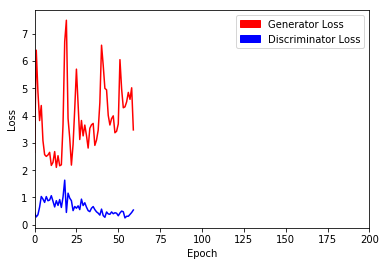

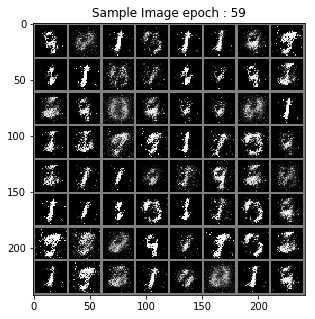

> Epoch : 61 Batch : 19 / 235 Loss_D : 0.2274990677833557 Loss_G : 3.8180084228515625
> Epoch : 61 Batch : 39 / 235 Loss_D : 0.46794402599334717 Loss_G : 3.684540271759033
> Epoch : 61 Batch : 59 / 235 Loss_D : 0.5010521411895752 Loss_G : 3.697255849838257
> Epoch : 61 Batch : 79 / 235 Loss_D : 0.2928168475627899 Loss_G : 3.6871581077575684
> Epoch : 61 Batch : 99 / 235 Loss_D : 0.25124019384384155 Loss_G : 3.2842628955841064
> Epoch : 61 Batch : 119 / 235 Loss_D : 0.27986931800842285 Loss_G : 4.069525718688965
> Epoch : 61 Batch : 139 / 235 Loss_D : 0.4597228765487671 Loss_G : 4.508194923400879
> Epoch : 61 Batch : 159 / 235 Loss_D : 0.4992195665836334 Loss_G : 2.6409289836883545
> Epoch : 61 Batch : 179 / 235 Loss_D : 0.3162093162536621 Loss_G : 3.908541440963745
> Epoch : 61 Batch : 199 / 235 Loss_D : 0.3256939947605133 Loss_G : 3.500941753387451
> Epoch : 61 Batch : 219 / 235 Loss_D : 0.347239226102829 Loss_G : 4.653244972229004


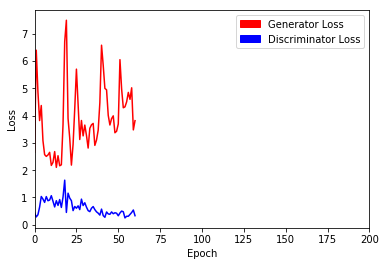

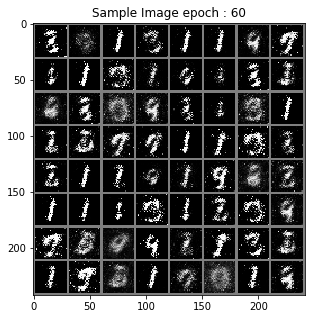

> Epoch : 62 Batch : 19 / 235 Loss_D : 0.2339242696762085 Loss_G : 4.419983863830566
> Epoch : 62 Batch : 39 / 235 Loss_D : 0.6119581460952759 Loss_G : 6.047538757324219
> Epoch : 62 Batch : 59 / 235 Loss_D : 0.26107218861579895 Loss_G : 5.1908278465271
> Epoch : 62 Batch : 79 / 235 Loss_D : 0.31531646847724915 Loss_G : 5.3472900390625
> Epoch : 62 Batch : 99 / 235 Loss_D : 0.27840760350227356 Loss_G : 4.3186869621276855
> Epoch : 62 Batch : 119 / 235 Loss_D : 0.18909190595149994 Loss_G : 4.808343887329102
> Epoch : 62 Batch : 139 / 235 Loss_D : 0.2782723605632782 Loss_G : 4.255016326904297
> Epoch : 62 Batch : 159 / 235 Loss_D : 0.35420113801956177 Loss_G : 3.3150317668914795
> Epoch : 62 Batch : 179 / 235 Loss_D : 0.267814576625824 Loss_G : 5.283045768737793
> Epoch : 62 Batch : 199 / 235 Loss_D : 0.3052484393119812 Loss_G : 4.359771728515625
> Epoch : 62 Batch : 219 / 235 Loss_D : 0.2436237335205078 Loss_G : 6.314344882965088


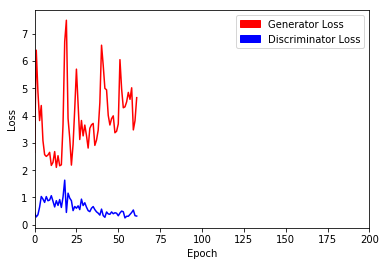

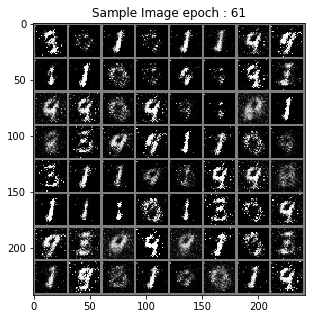

> Epoch : 63 Batch : 19 / 235 Loss_D : 0.31002485752105713 Loss_G : 3.0006723403930664
> Epoch : 63 Batch : 39 / 235 Loss_D : 0.1885482668876648 Loss_G : 3.707449197769165
> Epoch : 63 Batch : 59 / 235 Loss_D : 0.1805429905653 Loss_G : 4.763378620147705
> Epoch : 63 Batch : 79 / 235 Loss_D : 0.3407011032104492 Loss_G : 3.8862812519073486
> Epoch : 63 Batch : 99 / 235 Loss_D : 0.21539649367332458 Loss_G : 3.8372907638549805
> Epoch : 63 Batch : 119 / 235 Loss_D : 0.19679492712020874 Loss_G : 3.2926158905029297
> Epoch : 63 Batch : 139 / 235 Loss_D : 0.3140289783477783 Loss_G : 3.4779739379882812
> Epoch : 63 Batch : 159 / 235 Loss_D : 0.5068395137786865 Loss_G : 3.5427193641662598
> Epoch : 63 Batch : 179 / 235 Loss_D : 0.30928948521614075 Loss_G : 4.213201522827148
> Epoch : 63 Batch : 199 / 235 Loss_D : 0.14705534279346466 Loss_G : 3.458660125732422
> Epoch : 63 Batch : 219 / 235 Loss_D : 0.4243658781051636 Loss_G : 2.532423973083496


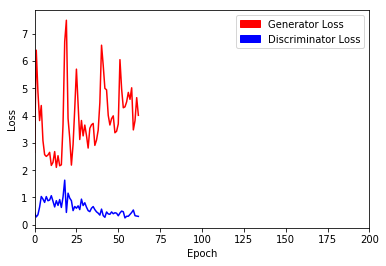

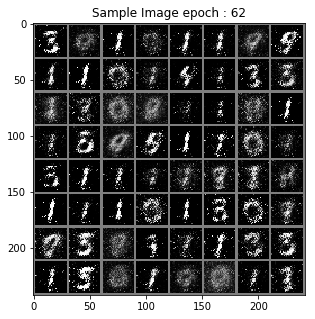

> Epoch : 64 Batch : 19 / 235 Loss_D : 0.3473609983921051 Loss_G : 4.154502868652344
> Epoch : 64 Batch : 39 / 235 Loss_D : 0.22968482971191406 Loss_G : 3.924100875854492
> Epoch : 64 Batch : 59 / 235 Loss_D : 0.1884174346923828 Loss_G : 4.333738803863525
> Epoch : 64 Batch : 79 / 235 Loss_D : 0.16590970754623413 Loss_G : 4.958979606628418
> Epoch : 64 Batch : 99 / 235 Loss_D : 0.3606364130973816 Loss_G : 3.8920931816101074
> Epoch : 64 Batch : 119 / 235 Loss_D : 0.39179113507270813 Loss_G : 5.071887969970703
> Epoch : 64 Batch : 139 / 235 Loss_D : 0.21869973838329315 Loss_G : 4.188394546508789
> Epoch : 64 Batch : 159 / 235 Loss_D : 0.32140976190567017 Loss_G : 3.9884562492370605
> Epoch : 64 Batch : 179 / 235 Loss_D : 0.2669687271118164 Loss_G : 4.484457015991211
> Epoch : 64 Batch : 199 / 235 Loss_D : 0.3236851096153259 Loss_G : 4.820774555206299
> Epoch : 64 Batch : 219 / 235 Loss_D : 0.3341068625450134 Loss_G : 4.77165412902832


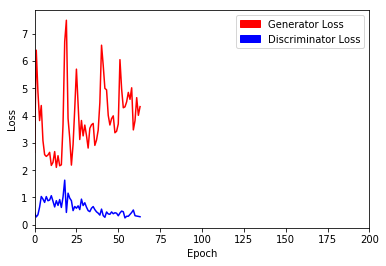

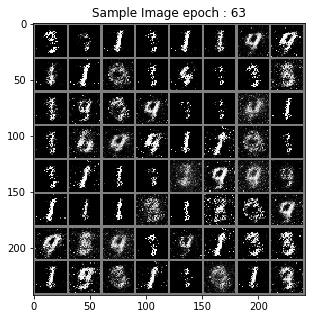

> Epoch : 65 Batch : 19 / 235 Loss_D : 0.31328219175338745 Loss_G : 3.2462480068206787
> Epoch : 65 Batch : 39 / 235 Loss_D : 0.3938133716583252 Loss_G : 4.3504486083984375
> Epoch : 65 Batch : 59 / 235 Loss_D : 0.2567082643508911 Loss_G : 4.481662273406982
> Epoch : 65 Batch : 79 / 235 Loss_D : 0.39111384749412537 Loss_G : 4.363500595092773
> Epoch : 65 Batch : 99 / 235 Loss_D : 0.27881065011024475 Loss_G : 4.608835220336914
> Epoch : 65 Batch : 119 / 235 Loss_D : 0.30376628041267395 Loss_G : 3.9898452758789062
> Epoch : 65 Batch : 139 / 235 Loss_D : 0.2349756360054016 Loss_G : 5.335075855255127
> Epoch : 65 Batch : 159 / 235 Loss_D : 0.22510859370231628 Loss_G : 4.768645286560059
> Epoch : 65 Batch : 179 / 235 Loss_D : 0.18793943524360657 Loss_G : 4.020031929016113
> Epoch : 65 Batch : 199 / 235 Loss_D : 0.165144145488739 Loss_G : 4.287876129150391
> Epoch : 65 Batch : 219 / 235 Loss_D : 0.33624783158302307 Loss_G : 3.2041385173797607


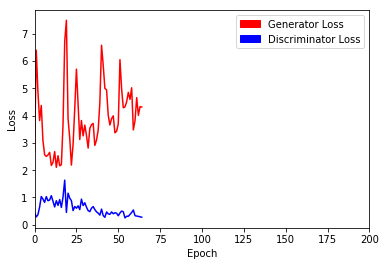

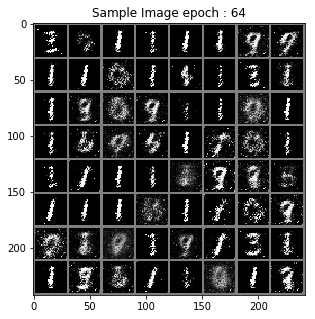

> Epoch : 66 Batch : 19 / 235 Loss_D : 0.2798628807067871 Loss_G : 4.636408805847168
> Epoch : 66 Batch : 39 / 235 Loss_D : 0.2236248254776001 Loss_G : 3.4019877910614014
> Epoch : 66 Batch : 59 / 235 Loss_D : 0.2264896184206009 Loss_G : 3.7859597206115723
> Epoch : 66 Batch : 79 / 235 Loss_D : 0.2887912094593048 Loss_G : 4.2909746170043945
> Epoch : 66 Batch : 99 / 235 Loss_D : 0.365071177482605 Loss_G : 3.7886056900024414
> Epoch : 66 Batch : 119 / 235 Loss_D : 0.3637333810329437 Loss_G : 5.28967809677124
> Epoch : 66 Batch : 139 / 235 Loss_D : 0.324991375207901 Loss_G : 3.966524124145508
> Epoch : 66 Batch : 159 / 235 Loss_D : 0.1798308789730072 Loss_G : 4.880932331085205
> Epoch : 66 Batch : 179 / 235 Loss_D : 0.2843298614025116 Loss_G : 3.8673195838928223
> Epoch : 66 Batch : 199 / 235 Loss_D : 0.2265263944864273 Loss_G : 4.439313888549805
> Epoch : 66 Batch : 219 / 235 Loss_D : 0.24430879950523376 Loss_G : 4.7827558517456055


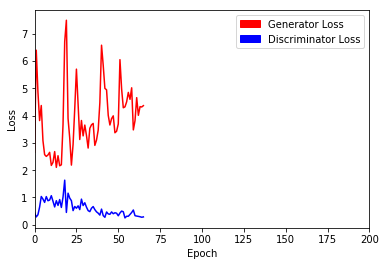

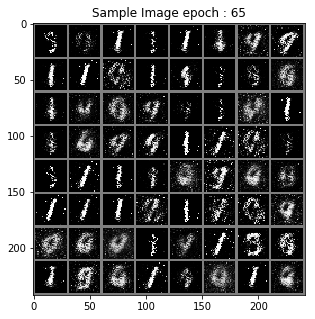

> Epoch : 67 Batch : 19 / 235 Loss_D : 0.24287071824073792 Loss_G : 5.037040710449219
> Epoch : 67 Batch : 39 / 235 Loss_D : 0.4999268352985382 Loss_G : 4.127617835998535
> Epoch : 67 Batch : 59 / 235 Loss_D : 0.14337365329265594 Loss_G : 6.0345964431762695
> Epoch : 67 Batch : 79 / 235 Loss_D : 0.35664626955986023 Loss_G : 5.2744646072387695
> Epoch : 67 Batch : 99 / 235 Loss_D : 0.3223295211791992 Loss_G : 4.9016547203063965
> Epoch : 67 Batch : 119 / 235 Loss_D : 0.38941827416419983 Loss_G : 6.1213226318359375
> Epoch : 67 Batch : 139 / 235 Loss_D : 0.3466092348098755 Loss_G : 3.760831832885742
> Epoch : 67 Batch : 159 / 235 Loss_D : 0.3021031618118286 Loss_G : 4.126724720001221
> Epoch : 67 Batch : 179 / 235 Loss_D : 0.3712654113769531 Loss_G : 3.256596088409424
> Epoch : 67 Batch : 199 / 235 Loss_D : 0.1803380846977234 Loss_G : 4.776283264160156
> Epoch : 67 Batch : 219 / 235 Loss_D : 0.2688961923122406 Loss_G : 3.9468681812286377


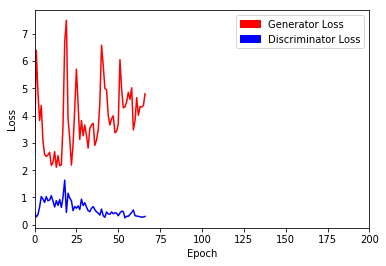

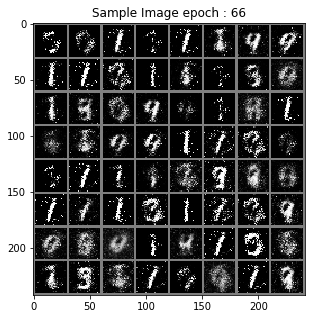

> Epoch : 68 Batch : 19 / 235 Loss_D : 0.27928870916366577 Loss_G : 5.026753902435303
> Epoch : 68 Batch : 39 / 235 Loss_D : 0.43708354234695435 Loss_G : 4.475499629974365
> Epoch : 68 Batch : 59 / 235 Loss_D : 0.2801944613456726 Loss_G : 5.275918960571289
> Epoch : 68 Batch : 79 / 235 Loss_D : 0.5805878639221191 Loss_G : 5.787898063659668
> Epoch : 68 Batch : 99 / 235 Loss_D : 0.2685862183570862 Loss_G : 5.445326805114746
> Epoch : 68 Batch : 119 / 235 Loss_D : 0.429296612739563 Loss_G : 4.313999176025391
> Epoch : 68 Batch : 139 / 235 Loss_D : 0.19215628504753113 Loss_G : 3.742741107940674
> Epoch : 68 Batch : 159 / 235 Loss_D : 0.3411491811275482 Loss_G : 3.31622576713562
> Epoch : 68 Batch : 179 / 235 Loss_D : 0.35949045419692993 Loss_G : 3.024914264678955
> Epoch : 68 Batch : 199 / 235 Loss_D : 0.29939109086990356 Loss_G : 3.8549306392669678
> Epoch : 68 Batch : 219 / 235 Loss_D : 0.3090795576572418 Loss_G : 3.010002613067627


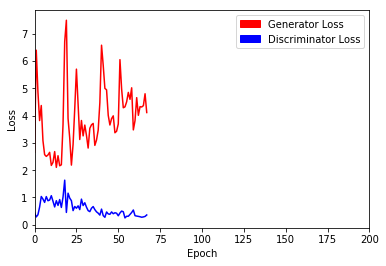

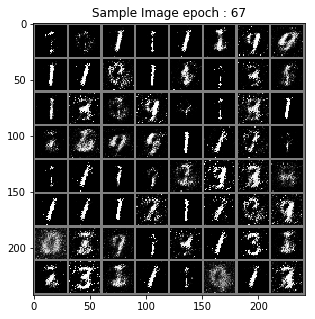

> Epoch : 69 Batch : 19 / 235 Loss_D : 0.21087810397148132 Loss_G : 3.3373231887817383
> Epoch : 69 Batch : 39 / 235 Loss_D : 0.26978015899658203 Loss_G : 4.678769111633301
> Epoch : 69 Batch : 59 / 235 Loss_D : 0.3031802177429199 Loss_G : 3.690701723098755
> Epoch : 69 Batch : 79 / 235 Loss_D : 0.22006741166114807 Loss_G : 4.815411567687988
> Epoch : 69 Batch : 99 / 235 Loss_D : 0.4522147476673126 Loss_G : 4.905474662780762
> Epoch : 69 Batch : 119 / 235 Loss_D : 0.308945894241333 Loss_G : 4.279251575469971
> Epoch : 69 Batch : 139 / 235 Loss_D : 0.4576008915901184 Loss_G : 4.510642051696777
> Epoch : 69 Batch : 159 / 235 Loss_D : 0.1864030659198761 Loss_G : 4.966411590576172
> Epoch : 69 Batch : 179 / 235 Loss_D : 0.20522895455360413 Loss_G : 4.794839859008789
> Epoch : 69 Batch : 199 / 235 Loss_D : 0.4342692196369171 Loss_G : 2.8249564170837402
> Epoch : 69 Batch : 219 / 235 Loss_D : 0.4710213541984558 Loss_G : 2.3496036529541016


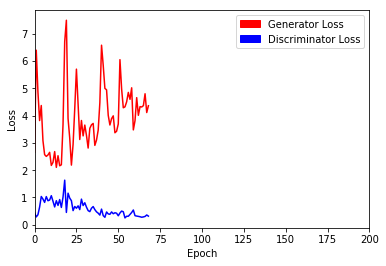

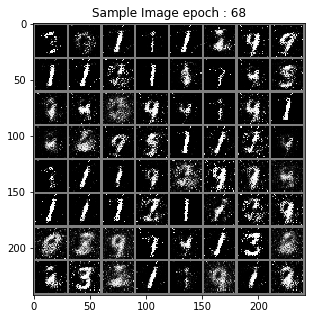

> Epoch : 70 Batch : 19 / 235 Loss_D : 0.26007866859436035 Loss_G : 3.739910125732422
> Epoch : 70 Batch : 39 / 235 Loss_D : 0.3007473349571228 Loss_G : 4.249833106994629
> Epoch : 70 Batch : 59 / 235 Loss_D : 0.14115139842033386 Loss_G : 5.3625593185424805
> Epoch : 70 Batch : 79 / 235 Loss_D : 0.24017775058746338 Loss_G : 4.383187294006348
> Epoch : 70 Batch : 99 / 235 Loss_D : 0.4837770462036133 Loss_G : 4.989311695098877
> Epoch : 70 Batch : 119 / 235 Loss_D : 0.40307527780532837 Loss_G : 4.588759422302246
> Epoch : 70 Batch : 139 / 235 Loss_D : 0.4361746311187744 Loss_G : 3.934816360473633
> Epoch : 70 Batch : 159 / 235 Loss_D : 0.3564518094062805 Loss_G : 3.4768331050872803
> Epoch : 70 Batch : 179 / 235 Loss_D : 0.35867971181869507 Loss_G : 4.11557674407959
> Epoch : 70 Batch : 199 / 235 Loss_D : 0.3103886842727661 Loss_G : 4.237832069396973
> Epoch : 70 Batch : 219 / 235 Loss_D : 0.2599523067474365 Loss_G : 4.630080223083496


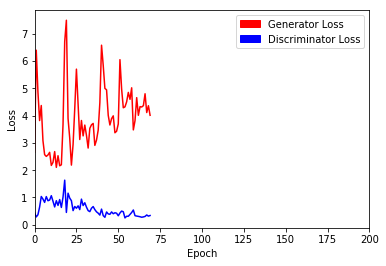

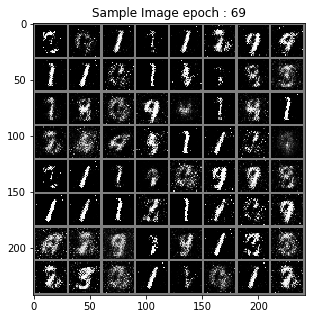

> Epoch : 71 Batch : 19 / 235 Loss_D : 0.475920706987381 Loss_G : 3.572669506072998
> Epoch : 71 Batch : 39 / 235 Loss_D : 0.284612238407135 Loss_G : 4.39609956741333
> Epoch : 71 Batch : 59 / 235 Loss_D : 0.3841865658760071 Loss_G : 2.991649627685547
> Epoch : 71 Batch : 79 / 235 Loss_D : 0.25706666707992554 Loss_G : 3.98567795753479
> Epoch : 71 Batch : 99 / 235 Loss_D : 0.26886072754859924 Loss_G : 3.382589101791382
> Epoch : 71 Batch : 119 / 235 Loss_D : 0.24928228557109833 Loss_G : 3.528918743133545
> Epoch : 71 Batch : 139 / 235 Loss_D : 0.29480087757110596 Loss_G : 4.217660427093506
> Epoch : 71 Batch : 159 / 235 Loss_D : 0.18870417773723602 Loss_G : 4.741968631744385
> Epoch : 71 Batch : 179 / 235 Loss_D : 0.24287714064121246 Loss_G : 3.005302667617798
> Epoch : 71 Batch : 199 / 235 Loss_D : 0.4714224338531494 Loss_G : 4.012199401855469
> Epoch : 71 Batch : 219 / 235 Loss_D : 0.26653754711151123 Loss_G : 4.549856662750244


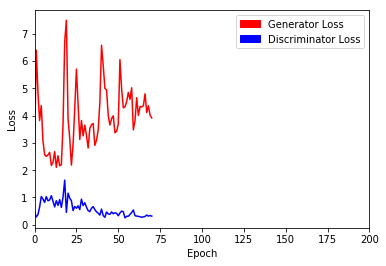

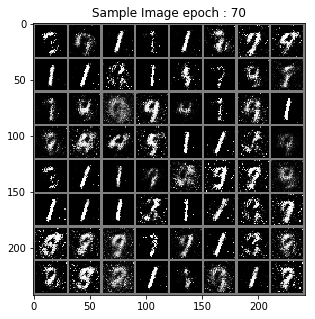

> Epoch : 72 Batch : 19 / 235 Loss_D : 0.2757101058959961 Loss_G : 2.7424869537353516
> Epoch : 72 Batch : 39 / 235 Loss_D : 0.462988942861557 Loss_G : 3.900541305541992
> Epoch : 72 Batch : 59 / 235 Loss_D : 0.2701171636581421 Loss_G : 3.764223575592041
> Epoch : 72 Batch : 79 / 235 Loss_D : 0.16211725771427155 Loss_G : 6.020788192749023
> Epoch : 72 Batch : 99 / 235 Loss_D : 0.22604137659072876 Loss_G : 4.082709312438965
> Epoch : 72 Batch : 119 / 235 Loss_D : 0.42662447690963745 Loss_G : 3.7695541381835938
> Epoch : 72 Batch : 139 / 235 Loss_D : 0.3322451710700989 Loss_G : 3.900998830795288
> Epoch : 72 Batch : 159 / 235 Loss_D : 0.302764356136322 Loss_G : 3.9411277770996094
> Epoch : 72 Batch : 179 / 235 Loss_D : 0.1845698058605194 Loss_G : 4.797638893127441
> Epoch : 72 Batch : 199 / 235 Loss_D : 0.32182246446609497 Loss_G : 5.0389723777771
> Epoch : 72 Batch : 219 / 235 Loss_D : 0.3135782480239868 Loss_G : 3.461308479309082


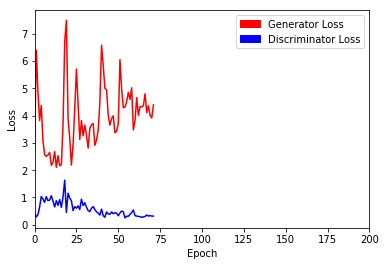

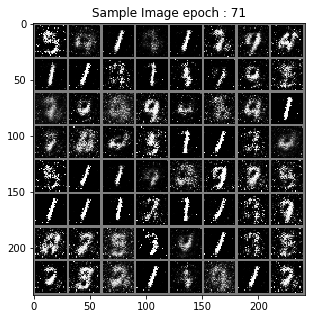

> Epoch : 73 Batch : 19 / 235 Loss_D : 0.33573779463768005 Loss_G : 4.6339826583862305
> Epoch : 73 Batch : 39 / 235 Loss_D : 0.33670398592948914 Loss_G : 3.679140329360962
> Epoch : 73 Batch : 59 / 235 Loss_D : 0.2907392084598541 Loss_G : 3.3521006107330322
> Epoch : 73 Batch : 79 / 235 Loss_D : 0.2455722689628601 Loss_G : 3.9440014362335205
> Epoch : 73 Batch : 99 / 235 Loss_D : 0.2788323760032654 Loss_G : 3.8177847862243652
> Epoch : 73 Batch : 119 / 235 Loss_D : 0.46365073323249817 Loss_G : 3.6188530921936035
> Epoch : 73 Batch : 139 / 235 Loss_D : 0.4545787572860718 Loss_G : 5.4623260498046875
> Epoch : 73 Batch : 159 / 235 Loss_D : 0.44249385595321655 Loss_G : 3.711827278137207
> Epoch : 73 Batch : 179 / 235 Loss_D : 0.4016338586807251 Loss_G : 4.002264022827148
> Epoch : 73 Batch : 199 / 235 Loss_D : 0.3732425570487976 Loss_G : 3.1279098987579346
> Epoch : 73 Batch : 219 / 235 Loss_D : 0.21990731358528137 Loss_G : 3.015733242034912


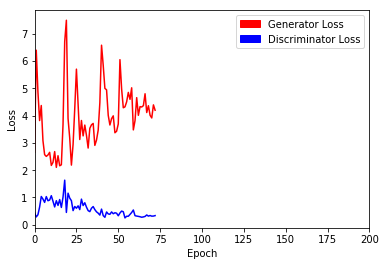

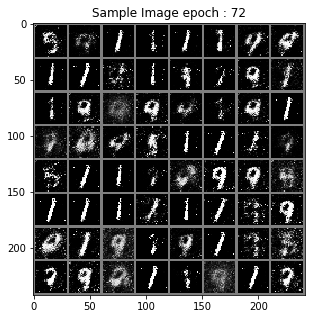

> Epoch : 74 Batch : 19 / 235 Loss_D : 0.3725968897342682 Loss_G : 3.393702983856201
> Epoch : 74 Batch : 39 / 235 Loss_D : 0.25449109077453613 Loss_G : 4.028514862060547
> Epoch : 74 Batch : 59 / 235 Loss_D : 0.49886420369148254 Loss_G : 4.373220920562744
> Epoch : 74 Batch : 79 / 235 Loss_D : 0.22737222909927368 Loss_G : 5.0554609298706055
> Epoch : 74 Batch : 99 / 235 Loss_D : 0.255435049533844 Loss_G : 4.598111152648926
> Epoch : 74 Batch : 119 / 235 Loss_D : 0.4072369933128357 Loss_G : 4.395299911499023
> Epoch : 74 Batch : 139 / 235 Loss_D : 0.39386922121047974 Loss_G : 4.653164863586426
> Epoch : 74 Batch : 159 / 235 Loss_D : 0.4544661343097687 Loss_G : 4.250287055969238
> Epoch : 74 Batch : 179 / 235 Loss_D : 0.3794768154621124 Loss_G : 3.0438876152038574
> Epoch : 74 Batch : 199 / 235 Loss_D : 0.2523781359195709 Loss_G : 3.4370508193969727
> Epoch : 74 Batch : 219 / 235 Loss_D : 0.4753535985946655 Loss_G : 4.395104885101318


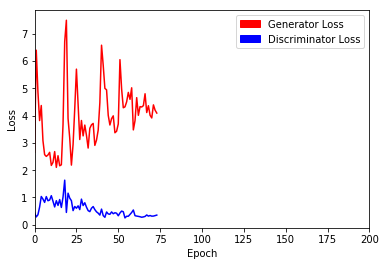

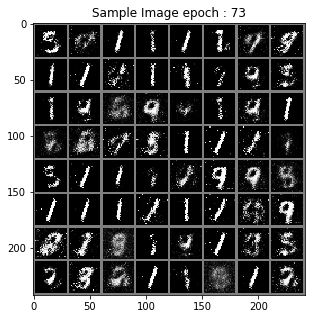

> Epoch : 75 Batch : 19 / 235 Loss_D : 0.33236265182495117 Loss_G : 4.157644748687744
> Epoch : 75 Batch : 39 / 235 Loss_D : 0.35446980595588684 Loss_G : 3.753854513168335
> Epoch : 75 Batch : 59 / 235 Loss_D : 0.2061370611190796 Loss_G : 5.355306625366211
> Epoch : 75 Batch : 79 / 235 Loss_D : 0.5113472938537598 Loss_G : 3.522930145263672
> Epoch : 75 Batch : 99 / 235 Loss_D : 0.32639098167419434 Loss_G : 4.43244743347168
> Epoch : 75 Batch : 119 / 235 Loss_D : 0.3137089014053345 Loss_G : 3.43703293800354
> Epoch : 75 Batch : 139 / 235 Loss_D : 0.4122666120529175 Loss_G : 3.980051040649414
> Epoch : 75 Batch : 159 / 235 Loss_D : 0.34501346945762634 Loss_G : 4.636253833770752
> Epoch : 75 Batch : 179 / 235 Loss_D : 0.39969462156295776 Loss_G : 3.050323009490967
> Epoch : 75 Batch : 199 / 235 Loss_D : 0.37867271900177 Loss_G : 2.791327953338623
> Epoch : 75 Batch : 219 / 235 Loss_D : 0.38537049293518066 Loss_G : 3.2319819927215576


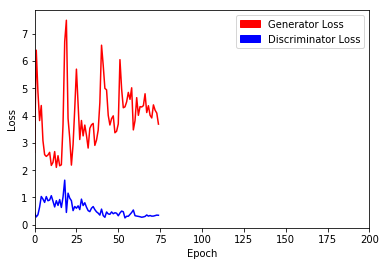

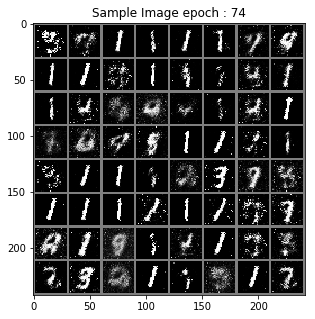

> Epoch : 76 Batch : 19 / 235 Loss_D : 0.27156955003738403 Loss_G : 4.961421012878418
> Epoch : 76 Batch : 39 / 235 Loss_D : 0.41506248712539673 Loss_G : 3.394205331802368
> Epoch : 76 Batch : 59 / 235 Loss_D : 0.2673015594482422 Loss_G : 4.5885772705078125
> Epoch : 76 Batch : 79 / 235 Loss_D : 0.41007789969444275 Loss_G : 3.9665842056274414
> Epoch : 76 Batch : 99 / 235 Loss_D : 0.4120499789714813 Loss_G : 3.3610167503356934
> Epoch : 76 Batch : 119 / 235 Loss_D : 0.344383180141449 Loss_G : 3.8508381843566895
> Epoch : 76 Batch : 139 / 235 Loss_D : 0.3949168026447296 Loss_G : 3.0113298892974854
> Epoch : 76 Batch : 159 / 235 Loss_D : 0.35040342807769775 Loss_G : 2.565951108932495
> Epoch : 76 Batch : 179 / 235 Loss_D : 0.28778907656669617 Loss_G : 2.559300661087036
> Epoch : 76 Batch : 199 / 235 Loss_D : 0.363810658454895 Loss_G : 2.720869541168213
> Epoch : 76 Batch : 219 / 235 Loss_D : 0.41095566749572754 Loss_G : 4.434708118438721


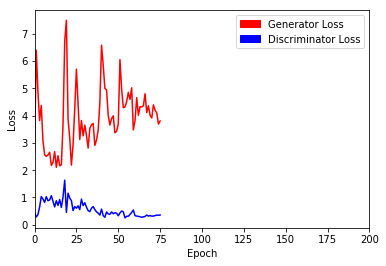

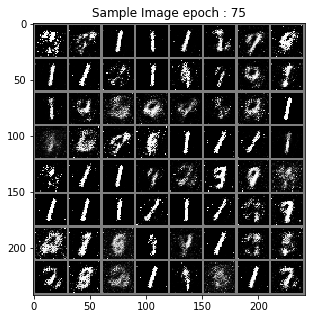

> Epoch : 77 Batch : 19 / 235 Loss_D : 0.4946476221084595 Loss_G : 3.5911526679992676
> Epoch : 77 Batch : 39 / 235 Loss_D : 0.4954766035079956 Loss_G : 4.083494186401367
> Epoch : 77 Batch : 59 / 235 Loss_D : 0.4731407165527344 Loss_G : 3.5993709564208984
> Epoch : 77 Batch : 79 / 235 Loss_D : 0.3393371105194092 Loss_G : 3.512704610824585
> Epoch : 77 Batch : 99 / 235 Loss_D : 0.2989012897014618 Loss_G : 3.225937604904175
> Epoch : 77 Batch : 119 / 235 Loss_D : 0.33174318075180054 Loss_G : 2.8717024326324463
> Epoch : 77 Batch : 139 / 235 Loss_D : 0.36614763736724854 Loss_G : 4.212641716003418
> Epoch : 77 Batch : 159 / 235 Loss_D : 0.4131048023700714 Loss_G : 3.089454174041748
> Epoch : 77 Batch : 179 / 235 Loss_D : 0.2547987997531891 Loss_G : 3.8684771060943604
> Epoch : 77 Batch : 199 / 235 Loss_D : 0.3709099292755127 Loss_G : 3.1115150451660156
> Epoch : 77 Batch : 219 / 235 Loss_D : 0.3342629075050354 Loss_G : 3.4705657958984375


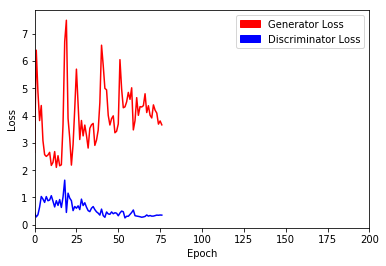

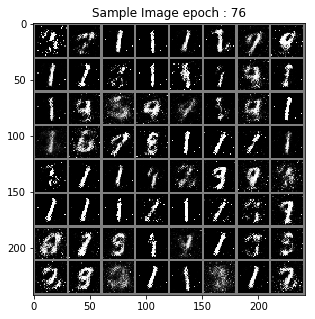

> Epoch : 78 Batch : 19 / 235 Loss_D : 0.6356077790260315 Loss_G : 3.258147716522217
> Epoch : 78 Batch : 39 / 235 Loss_D : 0.31751829385757446 Loss_G : 4.009803771972656
> Epoch : 78 Batch : 59 / 235 Loss_D : 0.2975233793258667 Loss_G : 3.812504768371582
> Epoch : 78 Batch : 79 / 235 Loss_D : 0.2841288447380066 Loss_G : 4.107254505157471
> Epoch : 78 Batch : 99 / 235 Loss_D : 0.3255782723426819 Loss_G : 2.964609146118164
> Epoch : 78 Batch : 119 / 235 Loss_D : 0.48026180267333984 Loss_G : 3.545362949371338
> Epoch : 78 Batch : 139 / 235 Loss_D : 0.3743525743484497 Loss_G : 3.4367594718933105
> Epoch : 78 Batch : 159 / 235 Loss_D : 0.3905768096446991 Loss_G : 3.302025318145752
> Epoch : 78 Batch : 179 / 235 Loss_D : 0.3381379246711731 Loss_G : 2.9501471519470215
> Epoch : 78 Batch : 199 / 235 Loss_D : 0.4377463757991791 Loss_G : 4.643103122711182
> Epoch : 78 Batch : 219 / 235 Loss_D : 0.39131030440330505 Loss_G : 3.3661231994628906


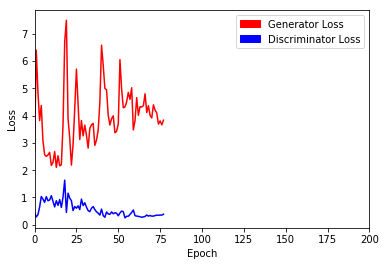

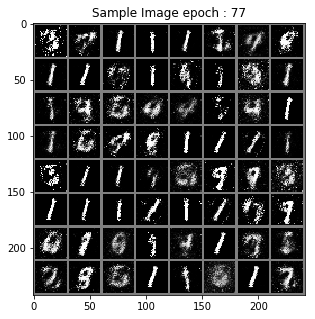

> Epoch : 79 Batch : 19 / 235 Loss_D : 0.5157461166381836 Loss_G : 2.7902073860168457
> Epoch : 79 Batch : 39 / 235 Loss_D : 0.328999400138855 Loss_G : 3.109999179840088
> Epoch : 79 Batch : 59 / 235 Loss_D : 0.42528024315834045 Loss_G : 3.7173585891723633
> Epoch : 79 Batch : 79 / 235 Loss_D : 0.2659144699573517 Loss_G : 5.723779201507568
> Epoch : 79 Batch : 99 / 235 Loss_D : 0.3949697017669678 Loss_G : 5.369024276733398
> Epoch : 79 Batch : 119 / 235 Loss_D : 0.5419148206710815 Loss_G : 3.2315640449523926
> Epoch : 79 Batch : 139 / 235 Loss_D : 0.35795125365257263 Loss_G : 3.97658634185791
> Epoch : 79 Batch : 159 / 235 Loss_D : 0.2752601206302643 Loss_G : 3.3394808769226074
> Epoch : 79 Batch : 179 / 235 Loss_D : 0.22421449422836304 Loss_G : 4.728514671325684
> Epoch : 79 Batch : 199 / 235 Loss_D : 0.5159807205200195 Loss_G : 3.8987083435058594
> Epoch : 79 Batch : 219 / 235 Loss_D : 0.49644583463668823 Loss_G : 3.0956554412841797


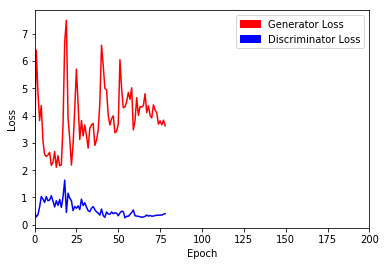

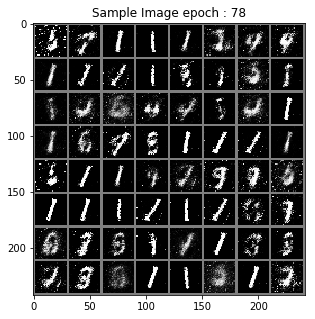

> Epoch : 80 Batch : 19 / 235 Loss_D : 0.3999931812286377 Loss_G : 4.212578296661377
> Epoch : 80 Batch : 39 / 235 Loss_D : 0.35614994168281555 Loss_G : 3.5441970825195312
> Epoch : 80 Batch : 59 / 235 Loss_D : 0.3732615113258362 Loss_G : 3.6912360191345215
> Epoch : 80 Batch : 79 / 235 Loss_D : 0.4009250998497009 Loss_G : 3.2694125175476074
> Epoch : 80 Batch : 99 / 235 Loss_D : 0.25040963292121887 Loss_G : 4.052857398986816
> Epoch : 80 Batch : 119 / 235 Loss_D : 0.5699541568756104 Loss_G : 3.2421934604644775
> Epoch : 80 Batch : 139 / 235 Loss_D : 0.4329671263694763 Loss_G : 3.6658334732055664
> Epoch : 80 Batch : 159 / 235 Loss_D : 0.3939233124256134 Loss_G : 3.301337242126465
> Epoch : 80 Batch : 179 / 235 Loss_D : 0.3384157121181488 Loss_G : 2.8766727447509766
> Epoch : 80 Batch : 199 / 235 Loss_D : 0.42022615671157837 Loss_G : 3.5925512313842773
> Epoch : 80 Batch : 219 / 235 Loss_D : 0.5404952168464661 Loss_G : 3.9556996822357178


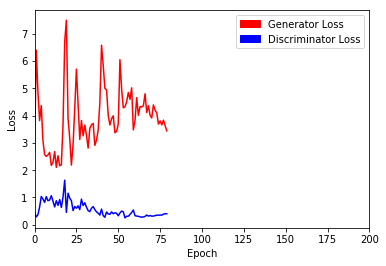

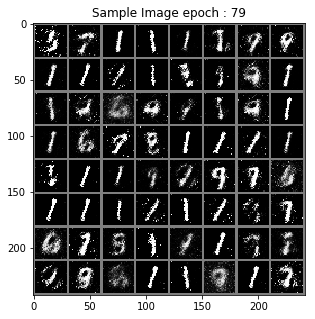

> Epoch : 81 Batch : 19 / 235 Loss_D : 0.5147236585617065 Loss_G : 3.375610828399658
> Epoch : 81 Batch : 39 / 235 Loss_D : 0.41428840160369873 Loss_G : 2.387732982635498
> Epoch : 81 Batch : 59 / 235 Loss_D : 0.5840550065040588 Loss_G : 2.628509998321533
> Epoch : 81 Batch : 79 / 235 Loss_D : 0.247809499502182 Loss_G : 3.4921648502349854
> Epoch : 81 Batch : 99 / 235 Loss_D : 0.3329507112503052 Loss_G : 3.1514267921447754
> Epoch : 81 Batch : 119 / 235 Loss_D : 0.23686954379081726 Loss_G : 4.115899085998535
> Epoch : 81 Batch : 139 / 235 Loss_D : 0.3894102871417999 Loss_G : 3.3383638858795166
> Epoch : 81 Batch : 159 / 235 Loss_D : 0.33280616998672485 Loss_G : 3.96591854095459
> Epoch : 81 Batch : 179 / 235 Loss_D : 0.4065602719783783 Loss_G : 3.3672051429748535
> Epoch : 81 Batch : 199 / 235 Loss_D : 0.3429349660873413 Loss_G : 3.0661163330078125
> Epoch : 81 Batch : 219 / 235 Loss_D : 0.27004474401474 Loss_G : 3.6226189136505127


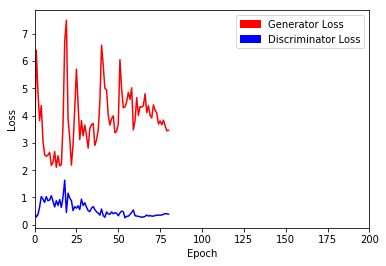

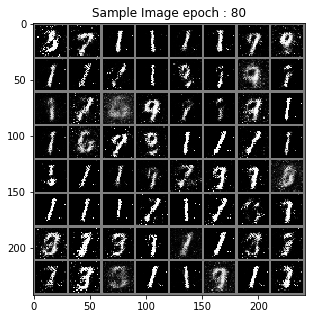

> Epoch : 82 Batch : 19 / 235 Loss_D : 0.475191593170166 Loss_G : 3.7284767627716064
> Epoch : 82 Batch : 39 / 235 Loss_D : 0.5672772526741028 Loss_G : 1.6731226444244385
> Epoch : 82 Batch : 59 / 235 Loss_D : 0.34502899646759033 Loss_G : 3.578911781311035
> Epoch : 82 Batch : 79 / 235 Loss_D : 0.2688540816307068 Loss_G : 3.615710973739624
> Epoch : 82 Batch : 99 / 235 Loss_D : 0.5277606248855591 Loss_G : 2.8138599395751953
> Epoch : 82 Batch : 119 / 235 Loss_D : 0.48247623443603516 Loss_G : 3.9430580139160156
> Epoch : 82 Batch : 139 / 235 Loss_D : 0.3145277500152588 Loss_G : 3.229647159576416
> Epoch : 82 Batch : 159 / 235 Loss_D : 0.35259175300598145 Loss_G : 3.635964870452881
> Epoch : 82 Batch : 179 / 235 Loss_D : 0.2917954921722412 Loss_G : 3.6905312538146973
> Epoch : 82 Batch : 199 / 235 Loss_D : 0.5872169733047485 Loss_G : 3.3879950046539307
> Epoch : 82 Batch : 219 / 235 Loss_D : 0.4934232234954834 Loss_G : 3.0222854614257812


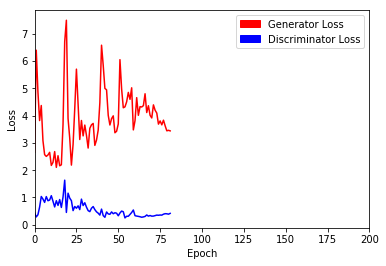

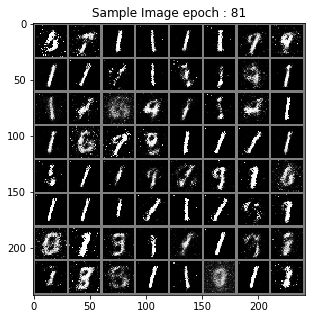

> Epoch : 83 Batch : 19 / 235 Loss_D : 0.4740447700023651 Loss_G : 2.684338331222534
> Epoch : 83 Batch : 39 / 235 Loss_D : 0.3587836027145386 Loss_G : 3.0510895252227783
> Epoch : 83 Batch : 59 / 235 Loss_D : 0.3791124224662781 Loss_G : 3.8377320766448975
> Epoch : 83 Batch : 79 / 235 Loss_D : 0.549690842628479 Loss_G : 3.709348201751709
> Epoch : 83 Batch : 99 / 235 Loss_D : 0.28608840703964233 Loss_G : 4.031617164611816
> Epoch : 83 Batch : 119 / 235 Loss_D : 0.34538495540618896 Loss_G : 3.973043441772461
> Epoch : 83 Batch : 139 / 235 Loss_D : 0.3400542736053467 Loss_G : 2.726322889328003
> Epoch : 83 Batch : 159 / 235 Loss_D : 0.2718218266963959 Loss_G : 3.363825798034668
> Epoch : 83 Batch : 179 / 235 Loss_D : 0.5110651254653931 Loss_G : 2.348719835281372
> Epoch : 83 Batch : 199 / 235 Loss_D : 0.4529682993888855 Loss_G : 3.3265302181243896
> Epoch : 83 Batch : 219 / 235 Loss_D : 0.3005848526954651 Loss_G : 3.1562209129333496


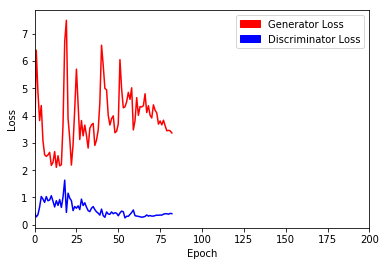

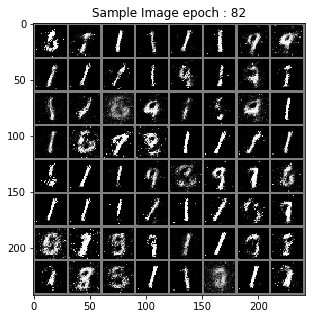

> Epoch : 84 Batch : 19 / 235 Loss_D : 0.575975239276886 Loss_G : 2.743368625640869
> Epoch : 84 Batch : 39 / 235 Loss_D : 0.3819868266582489 Loss_G : 3.6622753143310547
> Epoch : 84 Batch : 59 / 235 Loss_D : 0.4079899787902832 Loss_G : 2.6033170223236084
> Epoch : 84 Batch : 79 / 235 Loss_D : 0.3185044229030609 Loss_G : 3.42913818359375
> Epoch : 84 Batch : 99 / 235 Loss_D : 0.3084254264831543 Loss_G : 2.9435875415802
> Epoch : 84 Batch : 119 / 235 Loss_D : 0.3988751769065857 Loss_G : 3.00268292427063
> Epoch : 84 Batch : 139 / 235 Loss_D : 0.4818382263183594 Loss_G : 2.6998229026794434
> Epoch : 84 Batch : 159 / 235 Loss_D : 0.30935102701187134 Loss_G : 3.3609256744384766
> Epoch : 84 Batch : 179 / 235 Loss_D : 0.5076735019683838 Loss_G : 2.770698070526123
> Epoch : 84 Batch : 199 / 235 Loss_D : 0.3926869034767151 Loss_G : 2.7936058044433594
> Epoch : 84 Batch : 219 / 235 Loss_D : 0.6209455132484436 Loss_G : 3.363797664642334


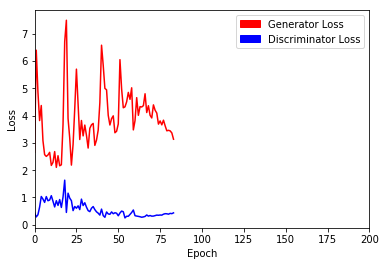

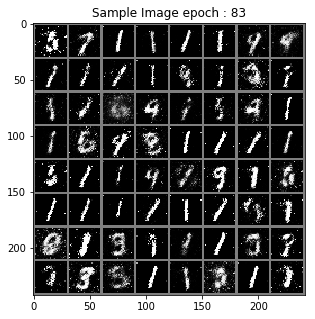

> Epoch : 85 Batch : 19 / 235 Loss_D : 0.457341730594635 Loss_G : 3.737494707107544
> Epoch : 85 Batch : 39 / 235 Loss_D : 0.32095468044281006 Loss_G : 3.18943190574646
> Epoch : 85 Batch : 59 / 235 Loss_D : 0.5347003936767578 Loss_G : 3.1984901428222656
> Epoch : 85 Batch : 79 / 235 Loss_D : 0.3671150803565979 Loss_G : 4.007920265197754
> Epoch : 85 Batch : 99 / 235 Loss_D : 0.46060049533843994 Loss_G : 4.055626392364502
> Epoch : 85 Batch : 119 / 235 Loss_D : 0.47944483160972595 Loss_G : 3.730762004852295
> Epoch : 85 Batch : 139 / 235 Loss_D : 0.44033193588256836 Loss_G : 3.657482624053955
> Epoch : 85 Batch : 159 / 235 Loss_D : 0.4472336173057556 Loss_G : 3.9846115112304688
> Epoch : 85 Batch : 179 / 235 Loss_D : 0.5044585466384888 Loss_G : 3.358346939086914
> Epoch : 85 Batch : 199 / 235 Loss_D : 0.3753776550292969 Loss_G : 3.505873203277588
> Epoch : 85 Batch : 219 / 235 Loss_D : 0.47284674644470215 Loss_G : 3.269705057144165


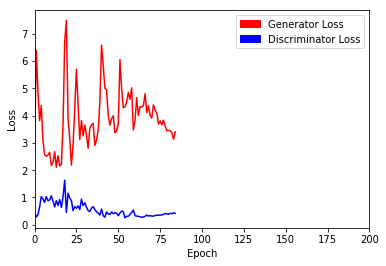

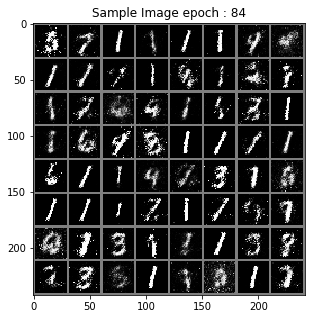

> Epoch : 86 Batch : 19 / 235 Loss_D : 0.4227582812309265 Loss_G : 3.167037010192871
> Epoch : 86 Batch : 39 / 235 Loss_D : 0.5440348386764526 Loss_G : 3.246917963027954
> Epoch : 86 Batch : 59 / 235 Loss_D : 0.44378259778022766 Loss_G : 3.7529311180114746
> Epoch : 86 Batch : 79 / 235 Loss_D : 0.3189951181411743 Loss_G : 3.204698085784912
> Epoch : 86 Batch : 99 / 235 Loss_D : 0.5862321853637695 Loss_G : 3.4440524578094482
> Epoch : 86 Batch : 119 / 235 Loss_D : 0.37613970041275024 Loss_G : 3.864302635192871
> Epoch : 86 Batch : 139 / 235 Loss_D : 0.49775195121765137 Loss_G : 3.517617702484131
> Epoch : 86 Batch : 159 / 235 Loss_D : 0.4449523389339447 Loss_G : 3.2058522701263428
> Epoch : 86 Batch : 179 / 235 Loss_D : 0.4624529480934143 Loss_G : 2.59091854095459
> Epoch : 86 Batch : 199 / 235 Loss_D : 0.3888421356678009 Loss_G : 3.0129873752593994
> Epoch : 86 Batch : 219 / 235 Loss_D : 0.3009285032749176 Loss_G : 3.818300724029541


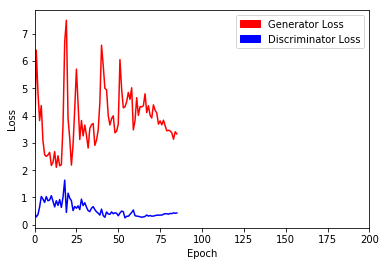

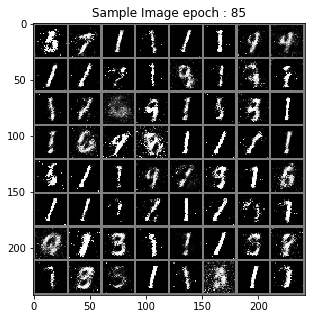

> Epoch : 87 Batch : 19 / 235 Loss_D : 0.5206890106201172 Loss_G : 3.550326347351074
> Epoch : 87 Batch : 39 / 235 Loss_D : 0.4705122113227844 Loss_G : 2.9739067554473877
> Epoch : 87 Batch : 59 / 235 Loss_D : 0.35679155588150024 Loss_G : 3.088466167449951
> Epoch : 87 Batch : 79 / 235 Loss_D : 0.3505239486694336 Loss_G : 3.5830183029174805
> Epoch : 87 Batch : 99 / 235 Loss_D : 0.3589257001876831 Loss_G : 3.3177428245544434
> Epoch : 87 Batch : 119 / 235 Loss_D : 0.3886076807975769 Loss_G : 3.801816940307617
> Epoch : 87 Batch : 139 / 235 Loss_D : 0.29913437366485596 Loss_G : 3.449573516845703
> Epoch : 87 Batch : 159 / 235 Loss_D : 0.5009469389915466 Loss_G : 2.3346383571624756
> Epoch : 87 Batch : 179 / 235 Loss_D : 0.3974926471710205 Loss_G : 3.107877731323242
> Epoch : 87 Batch : 199 / 235 Loss_D : 0.4548923969268799 Loss_G : 4.644828796386719
> Epoch : 87 Batch : 219 / 235 Loss_D : 0.3319784700870514 Loss_G : 3.951326608657837


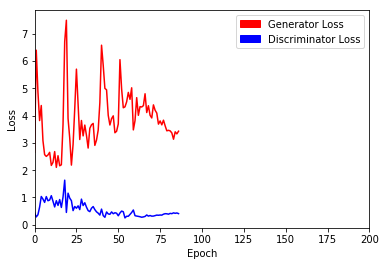

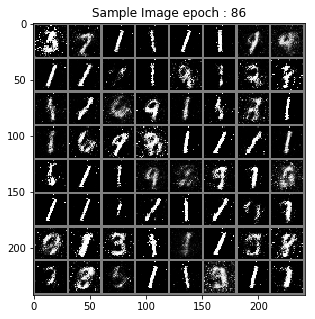

> Epoch : 88 Batch : 19 / 235 Loss_D : 0.46225184202194214 Loss_G : 4.027799606323242
> Epoch : 88 Batch : 39 / 235 Loss_D : 0.504897952079773 Loss_G : 3.7717714309692383
> Epoch : 88 Batch : 59 / 235 Loss_D : 0.43683117628097534 Loss_G : 2.7477707862854004
> Epoch : 88 Batch : 79 / 235 Loss_D : 0.40909460186958313 Loss_G : 2.590851306915283
> Epoch : 88 Batch : 99 / 235 Loss_D : 0.4066477417945862 Loss_G : 3.2132081985473633
> Epoch : 88 Batch : 119 / 235 Loss_D : 0.5619797110557556 Loss_G : 3.1131949424743652
> Epoch : 88 Batch : 139 / 235 Loss_D : 0.4874185025691986 Loss_G : 2.5241198539733887
> Epoch : 88 Batch : 159 / 235 Loss_D : 0.32315030694007874 Loss_G : 3.1607792377471924
> Epoch : 88 Batch : 179 / 235 Loss_D : 0.38586825132369995 Loss_G : 3.6400816440582275
> Epoch : 88 Batch : 199 / 235 Loss_D : 0.3861270248889923 Loss_G : 3.3456850051879883
> Epoch : 88 Batch : 219 / 235 Loss_D : 0.42995303869247437 Loss_G : 2.9749808311462402


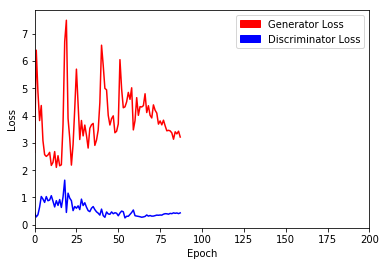

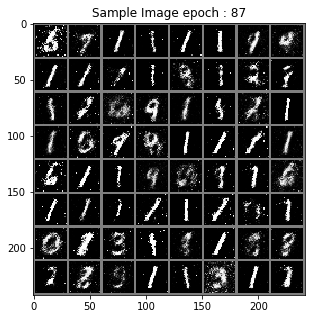

> Epoch : 89 Batch : 19 / 235 Loss_D : 0.3285810351371765 Loss_G : 3.2125234603881836
> Epoch : 89 Batch : 39 / 235 Loss_D : 0.47889190912246704 Loss_G : 2.958777666091919
> Epoch : 89 Batch : 59 / 235 Loss_D : 0.3138604760169983 Loss_G : 3.5922904014587402
> Epoch : 89 Batch : 79 / 235 Loss_D : 0.3075805604457855 Loss_G : 2.8444814682006836
> Epoch : 89 Batch : 99 / 235 Loss_D : 0.6260549426078796 Loss_G : 2.710537910461426
> Epoch : 89 Batch : 119 / 235 Loss_D : 0.4329800009727478 Loss_G : 2.9144139289855957
> Epoch : 89 Batch : 139 / 235 Loss_D : 0.3876412510871887 Loss_G : 2.6168627738952637
> Epoch : 89 Batch : 159 / 235 Loss_D : 0.5672459006309509 Loss_G : 3.346839189529419
> Epoch : 89 Batch : 179 / 235 Loss_D : 0.37907910346984863 Loss_G : 3.2119436264038086
> Epoch : 89 Batch : 199 / 235 Loss_D : 0.43269750475883484 Loss_G : 2.5492708683013916
> Epoch : 89 Batch : 219 / 235 Loss_D : 0.5207095146179199 Loss_G : 2.9128360748291016


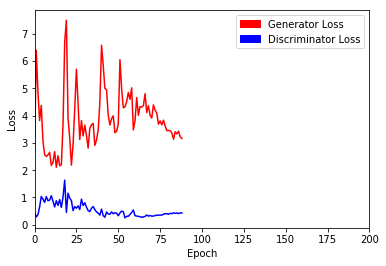

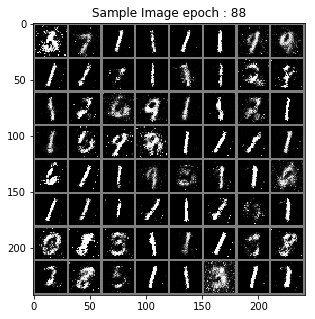

> Epoch : 90 Batch : 19 / 235 Loss_D : 0.4122312068939209 Loss_G : 3.1228039264678955
> Epoch : 90 Batch : 39 / 235 Loss_D : 0.4286649823188782 Loss_G : 2.7206573486328125
> Epoch : 90 Batch : 59 / 235 Loss_D : 0.5106299519538879 Loss_G : 2.684481143951416
> Epoch : 90 Batch : 79 / 235 Loss_D : 0.30190369486808777 Loss_G : 2.5038628578186035
> Epoch : 90 Batch : 99 / 235 Loss_D : 0.41293859481811523 Loss_G : 3.260324239730835
> Epoch : 90 Batch : 119 / 235 Loss_D : 0.680556058883667 Loss_G : 3.4507439136505127
> Epoch : 90 Batch : 139 / 235 Loss_D : 0.3883668780326843 Loss_G : 2.513723373413086
> Epoch : 90 Batch : 159 / 235 Loss_D : 0.5140665769577026 Loss_G : 2.7579522132873535
> Epoch : 90 Batch : 179 / 235 Loss_D : 0.49463075399398804 Loss_G : 3.0604681968688965
> Epoch : 90 Batch : 199 / 235 Loss_D : 0.4312983751296997 Loss_G : 2.6852149963378906
> Epoch : 90 Batch : 219 / 235 Loss_D : 0.48586782813072205 Loss_G : 3.4343035221099854


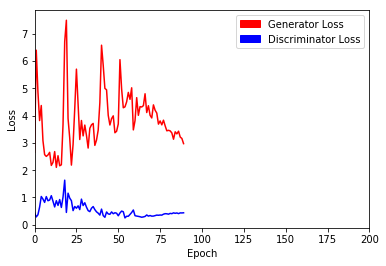

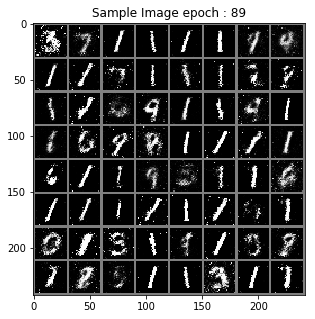

> Epoch : 91 Batch : 19 / 235 Loss_D : 0.35110047459602356 Loss_G : 3.273775577545166
> Epoch : 91 Batch : 39 / 235 Loss_D : 0.4443371891975403 Loss_G : 3.4773266315460205
> Epoch : 91 Batch : 59 / 235 Loss_D : 0.39342185854911804 Loss_G : 2.71840763092041
> Epoch : 91 Batch : 79 / 235 Loss_D : 0.43857789039611816 Loss_G : 2.1104037761688232
> Epoch : 91 Batch : 99 / 235 Loss_D : 0.3217281699180603 Loss_G : 2.9872727394104004
> Epoch : 91 Batch : 119 / 235 Loss_D : 0.4335380792617798 Loss_G : 3.3893802165985107
> Epoch : 91 Batch : 139 / 235 Loss_D : 0.3176201581954956 Loss_G : 3.7743091583251953
> Epoch : 91 Batch : 159 / 235 Loss_D : 0.48253133893013 Loss_G : 2.3985671997070312
> Epoch : 91 Batch : 179 / 235 Loss_D : 0.4177687466144562 Loss_G : 2.7127344608306885
> Epoch : 91 Batch : 199 / 235 Loss_D : 0.3701475262641907 Loss_G : 4.234286308288574
> Epoch : 91 Batch : 219 / 235 Loss_D : 0.43007516860961914 Loss_G : 3.492431879043579


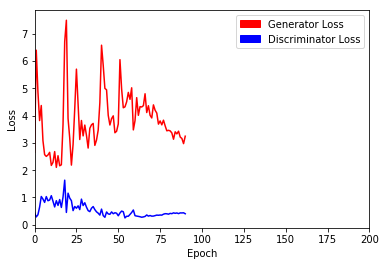

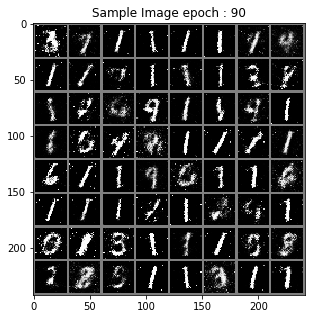

> Epoch : 92 Batch : 19 / 235 Loss_D : 0.3702758550643921 Loss_G : 3.3586835861206055
> Epoch : 92 Batch : 39 / 235 Loss_D : 0.40359392762184143 Loss_G : 2.5591118335723877
> Epoch : 92 Batch : 59 / 235 Loss_D : 0.4023749828338623 Loss_G : 3.1726536750793457
> Epoch : 92 Batch : 79 / 235 Loss_D : 0.31447893381118774 Loss_G : 2.874955177307129
> Epoch : 92 Batch : 99 / 235 Loss_D : 0.325204998254776 Loss_G : 4.502941608428955
> Epoch : 92 Batch : 119 / 235 Loss_D : 0.4410235285758972 Loss_G : 3.101902484893799
> Epoch : 92 Batch : 139 / 235 Loss_D : 0.44945934414863586 Loss_G : 4.052478790283203
> Epoch : 92 Batch : 159 / 235 Loss_D : 0.4893767833709717 Loss_G : 2.9865670204162598
> Epoch : 92 Batch : 179 / 235 Loss_D : 0.4171082377433777 Loss_G : 3.2922465801239014
> Epoch : 92 Batch : 199 / 235 Loss_D : 0.34664595127105713 Loss_G : 3.480498790740967
> Epoch : 92 Batch : 219 / 235 Loss_D : 0.3469609022140503 Loss_G : 2.8468050956726074


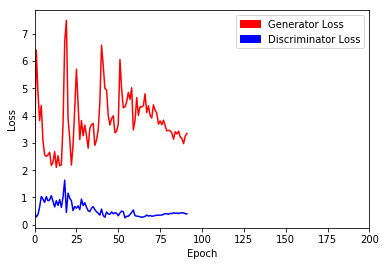

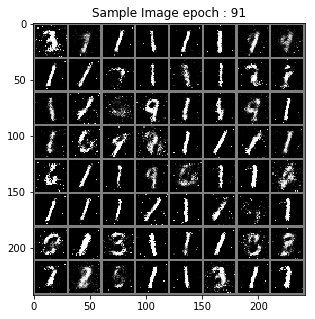

> Epoch : 93 Batch : 19 / 235 Loss_D : 0.434331476688385 Loss_G : 3.475264072418213
> Epoch : 93 Batch : 39 / 235 Loss_D : 0.3398343622684479 Loss_G : 3.78220796585083
> Epoch : 93 Batch : 59 / 235 Loss_D : 0.47186586260795593 Loss_G : 2.6136016845703125
> Epoch : 93 Batch : 79 / 235 Loss_D : 0.511393129825592 Loss_G : 1.677234411239624
> Epoch : 93 Batch : 99 / 235 Loss_D : 0.5659067034721375 Loss_G : 2.6648216247558594
> Epoch : 93 Batch : 119 / 235 Loss_D : 0.44269418716430664 Loss_G : 2.5494275093078613
> Epoch : 93 Batch : 139 / 235 Loss_D : 0.469418466091156 Loss_G : 3.121274948120117
> Epoch : 93 Batch : 159 / 235 Loss_D : 0.3478912115097046 Loss_G : 3.5287208557128906
> Epoch : 93 Batch : 179 / 235 Loss_D : 0.40037715435028076 Loss_G : 2.8753509521484375
> Epoch : 93 Batch : 199 / 235 Loss_D : 0.4707910120487213 Loss_G : 3.437330722808838
> Epoch : 93 Batch : 219 / 235 Loss_D : 0.3250434398651123 Loss_G : 3.596092700958252


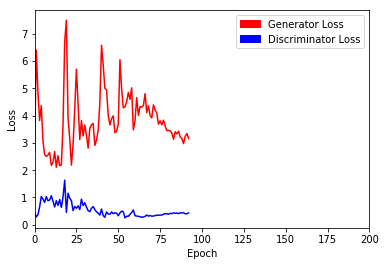

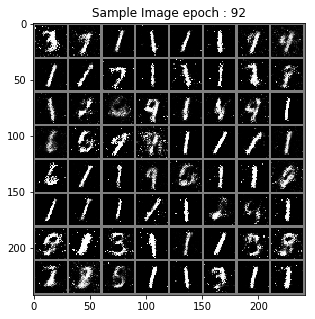

> Epoch : 94 Batch : 19 / 235 Loss_D : 0.47581446170806885 Loss_G : 3.0613389015197754
> Epoch : 94 Batch : 39 / 235 Loss_D : 0.3625640571117401 Loss_G : 2.766946315765381
> Epoch : 94 Batch : 59 / 235 Loss_D : 0.38155442476272583 Loss_G : 2.7517786026000977
> Epoch : 94 Batch : 79 / 235 Loss_D : 0.4908953905105591 Loss_G : 2.8752527236938477
> Epoch : 94 Batch : 99 / 235 Loss_D : 0.4757896959781647 Loss_G : 2.5290513038635254
> Epoch : 94 Batch : 119 / 235 Loss_D : 0.5071780681610107 Loss_G : 2.873528480529785
> Epoch : 94 Batch : 139 / 235 Loss_D : 0.2950182557106018 Loss_G : 3.3947269916534424
> Epoch : 94 Batch : 159 / 235 Loss_D : 0.2884402573108673 Loss_G : 2.897562265396118
> Epoch : 94 Batch : 179 / 235 Loss_D : 0.5956011414527893 Loss_G : 2.6841800212860107
> Epoch : 94 Batch : 199 / 235 Loss_D : 0.6331742405891418 Loss_G : 3.3565354347229004
> Epoch : 94 Batch : 219 / 235 Loss_D : 0.42261672019958496 Loss_G : 2.9200334548950195


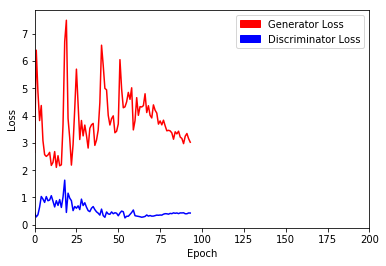

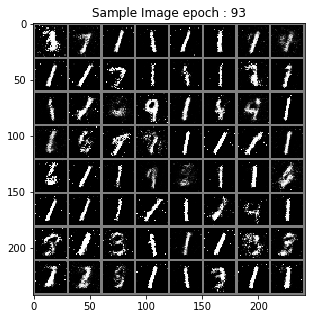

> Epoch : 95 Batch : 19 / 235 Loss_D : 0.3707863390445709 Loss_G : 2.879546880722046
> Epoch : 95 Batch : 39 / 235 Loss_D : 0.5041884183883667 Loss_G : 3.1616740226745605
> Epoch : 95 Batch : 59 / 235 Loss_D : 0.3328890800476074 Loss_G : 2.8117592334747314
> Epoch : 95 Batch : 79 / 235 Loss_D : 0.44827204942703247 Loss_G : 2.7730352878570557
> Epoch : 95 Batch : 99 / 235 Loss_D : 0.27948442101478577 Loss_G : 2.5932650566101074
> Epoch : 95 Batch : 119 / 235 Loss_D : 0.40433207154273987 Loss_G : 3.1985840797424316
> Epoch : 95 Batch : 139 / 235 Loss_D : 0.42169511318206787 Loss_G : 3.237428665161133
> Epoch : 95 Batch : 159 / 235 Loss_D : 0.5539941191673279 Loss_G : 2.873384952545166
> Epoch : 95 Batch : 179 / 235 Loss_D : 0.4815242290496826 Loss_G : 2.6758294105529785
> Epoch : 95 Batch : 199 / 235 Loss_D : 0.502018928527832 Loss_G : 2.831892490386963
> Epoch : 95 Batch : 219 / 235 Loss_D : 0.3739444315433502 Loss_G : 3.0136473178863525


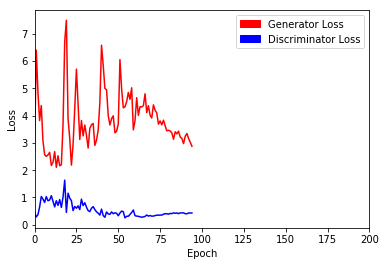

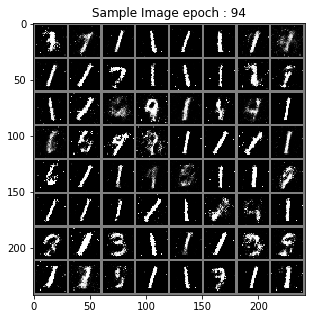

> Epoch : 96 Batch : 19 / 235 Loss_D : 0.4675891101360321 Loss_G : 2.6519742012023926
> Epoch : 96 Batch : 39 / 235 Loss_D : 0.3418791890144348 Loss_G : 3.323822498321533
> Epoch : 96 Batch : 59 / 235 Loss_D : 0.439262330532074 Loss_G : 2.8267266750335693
> Epoch : 96 Batch : 79 / 235 Loss_D : 0.5197358131408691 Loss_G : 2.6687331199645996
> Epoch : 96 Batch : 99 / 235 Loss_D : 0.3683212995529175 Loss_G : 2.652474880218506
> Epoch : 96 Batch : 119 / 235 Loss_D : 0.4913095533847809 Loss_G : 3.3604252338409424
> Epoch : 96 Batch : 139 / 235 Loss_D : 0.4593365788459778 Loss_G : 2.9487457275390625
> Epoch : 96 Batch : 159 / 235 Loss_D : 0.3568190336227417 Loss_G : 2.9353721141815186
> Epoch : 96 Batch : 179 / 235 Loss_D : 0.42762291431427 Loss_G : 3.081639289855957
> Epoch : 96 Batch : 199 / 235 Loss_D : 0.39308083057403564 Loss_G : 2.6124517917633057
> Epoch : 96 Batch : 219 / 235 Loss_D : 0.5788214802742004 Loss_G : 2.3282294273376465


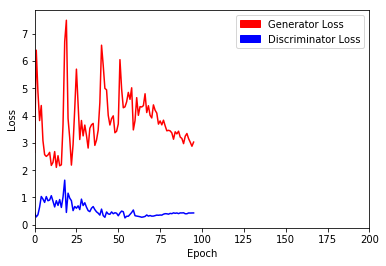

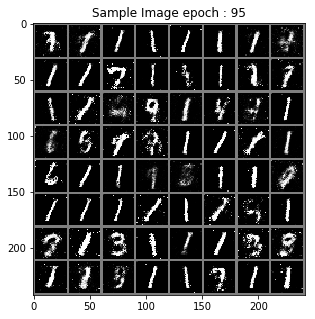

> Epoch : 97 Batch : 19 / 235 Loss_D : 0.37369126081466675 Loss_G : 2.9216055870056152
> Epoch : 97 Batch : 39 / 235 Loss_D : 0.33932629227638245 Loss_G : 2.7321689128875732
> Epoch : 97 Batch : 59 / 235 Loss_D : 0.5140432715415955 Loss_G : 3.1125898361206055
> Epoch : 97 Batch : 79 / 235 Loss_D : 0.4134330153465271 Loss_G : 2.931929111480713
> Epoch : 97 Batch : 99 / 235 Loss_D : 0.4705163836479187 Loss_G : 2.78041410446167
> Epoch : 97 Batch : 119 / 235 Loss_D : 0.49508655071258545 Loss_G : 2.1095008850097656
> Epoch : 97 Batch : 139 / 235 Loss_D : 0.40542519092559814 Loss_G : 3.487499237060547
> Epoch : 97 Batch : 159 / 235 Loss_D : 0.3977088928222656 Loss_G : 3.5961880683898926
> Epoch : 97 Batch : 179 / 235 Loss_D : 0.49214330315589905 Loss_G : 3.329690933227539
> Epoch : 97 Batch : 199 / 235 Loss_D : 0.4280373454093933 Loss_G : 2.555724859237671
> Epoch : 97 Batch : 219 / 235 Loss_D : 0.4800497889518738 Loss_G : 3.046922206878662


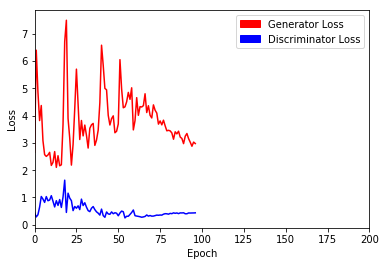

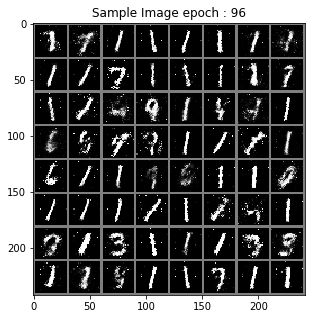

> Epoch : 98 Batch : 19 / 235 Loss_D : 0.42559289932250977 Loss_G : 3.8546559810638428
> Epoch : 98 Batch : 39 / 235 Loss_D : 0.5186595320701599 Loss_G : 2.903994560241699
> Epoch : 98 Batch : 59 / 235 Loss_D : 0.3159063458442688 Loss_G : 3.415065050125122
> Epoch : 98 Batch : 79 / 235 Loss_D : 0.5472986698150635 Loss_G : 3.0678858757019043
> Epoch : 98 Batch : 99 / 235 Loss_D : 0.5288102030754089 Loss_G : 2.634124755859375
> Epoch : 98 Batch : 119 / 235 Loss_D : 0.38391122221946716 Loss_G : 3.237069606781006
> Epoch : 98 Batch : 139 / 235 Loss_D : 0.4550827145576477 Loss_G : 2.6645772457122803
> Epoch : 98 Batch : 159 / 235 Loss_D : 0.43082377314567566 Loss_G : 3.55507230758667
> Epoch : 98 Batch : 179 / 235 Loss_D : 0.4445822536945343 Loss_G : 3.4776926040649414
> Epoch : 98 Batch : 199 / 235 Loss_D : 0.5435569286346436 Loss_G : 2.420849561691284
> Epoch : 98 Batch : 219 / 235 Loss_D : 0.4226643443107605 Loss_G : 3.003762722015381


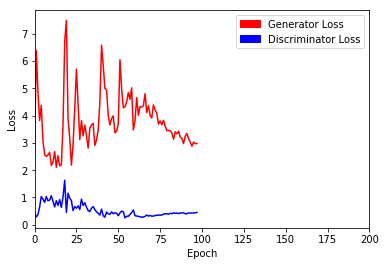

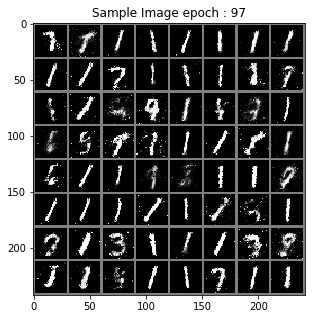

> Epoch : 99 Batch : 19 / 235 Loss_D : 0.7208703756332397 Loss_G : 2.64918851852417
> Epoch : 99 Batch : 39 / 235 Loss_D : 0.352197527885437 Loss_G : 3.0124852657318115
> Epoch : 99 Batch : 59 / 235 Loss_D : 0.4405782222747803 Loss_G : 3.2261877059936523
> Epoch : 99 Batch : 79 / 235 Loss_D : 0.5089459419250488 Loss_G : 2.4651150703430176
> Epoch : 99 Batch : 99 / 235 Loss_D : 0.5097861886024475 Loss_G : 2.7343626022338867
> Epoch : 99 Batch : 119 / 235 Loss_D : 0.4343452751636505 Loss_G : 3.0740628242492676
> Epoch : 99 Batch : 139 / 235 Loss_D : 0.36085161566734314 Loss_G : 2.9647555351257324
> Epoch : 99 Batch : 159 / 235 Loss_D : 0.5881521701812744 Loss_G : 2.60261869430542
> Epoch : 99 Batch : 179 / 235 Loss_D : 0.4455506205558777 Loss_G : 2.4733352661132812
> Epoch : 99 Batch : 199 / 235 Loss_D : 0.45019954442977905 Loss_G : 3.192512273788452
> Epoch : 99 Batch : 219 / 235 Loss_D : 0.45251959562301636 Loss_G : 2.679932117462158


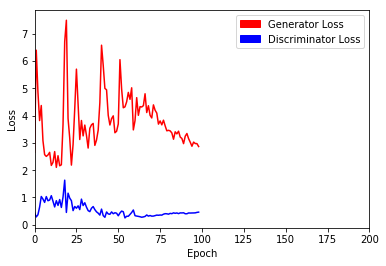

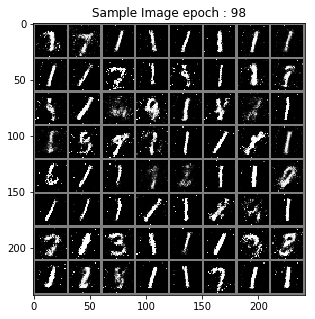

> Epoch : 100 Batch : 19 / 235 Loss_D : 0.3701649606227875 Loss_G : 2.601949691772461
> Epoch : 100 Batch : 39 / 235 Loss_D : 0.4942016005516052 Loss_G : 3.1175193786621094
> Epoch : 100 Batch : 59 / 235 Loss_D : 0.3171096444129944 Loss_G : 2.8547329902648926
> Epoch : 100 Batch : 79 / 235 Loss_D : 0.4434329867362976 Loss_G : 2.705888032913208
> Epoch : 100 Batch : 99 / 235 Loss_D : 0.5314414501190186 Loss_G : 2.580646514892578
> Epoch : 100 Batch : 119 / 235 Loss_D : 0.40144792199134827 Loss_G : 2.897268295288086
> Epoch : 100 Batch : 139 / 235 Loss_D : 0.39216864109039307 Loss_G : 2.759669303894043
> Epoch : 100 Batch : 159 / 235 Loss_D : 0.5343031287193298 Loss_G : 2.5607247352600098
> Epoch : 100 Batch : 179 / 235 Loss_D : 0.3391931653022766 Loss_G : 2.5660388469696045
> Epoch : 100 Batch : 199 / 235 Loss_D : 0.3914238214492798 Loss_G : 2.9933130741119385
> Epoch : 100 Batch : 219 / 235 Loss_D : 0.47593843936920166 Loss_G : 2.0392518043518066


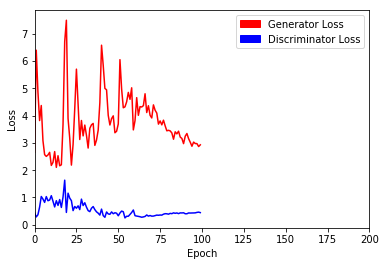

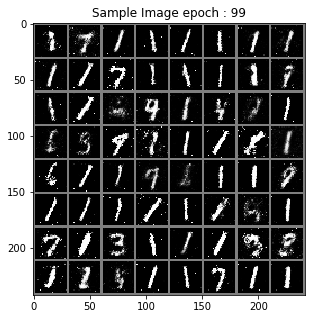

> Epoch : 101 Batch : 19 / 235 Loss_D : 0.4299662113189697 Loss_G : 2.684579849243164
> Epoch : 101 Batch : 39 / 235 Loss_D : 0.42640119791030884 Loss_G : 2.9997942447662354
> Epoch : 101 Batch : 59 / 235 Loss_D : 0.4348582923412323 Loss_G : 3.2073206901550293
> Epoch : 101 Batch : 79 / 235 Loss_D : 0.48048603534698486 Loss_G : 3.7784080505371094
> Epoch : 101 Batch : 99 / 235 Loss_D : 0.41796886920928955 Loss_G : 2.9119083881378174
> Epoch : 101 Batch : 119 / 235 Loss_D : 0.4440823793411255 Loss_G : 2.3104262351989746
> Epoch : 101 Batch : 139 / 235 Loss_D : 0.46838462352752686 Loss_G : 2.870089530944824
> Epoch : 101 Batch : 159 / 235 Loss_D : 0.4855685234069824 Loss_G : 2.754826068878174
> Epoch : 101 Batch : 179 / 235 Loss_D : 0.4980912208557129 Loss_G : 3.375244617462158
> Epoch : 101 Batch : 199 / 235 Loss_D : 0.41825300455093384 Loss_G : 3.4275426864624023
> Epoch : 101 Batch : 219 / 235 Loss_D : 0.45615261793136597 Loss_G : 3.195537567138672


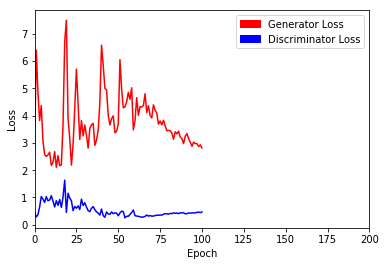

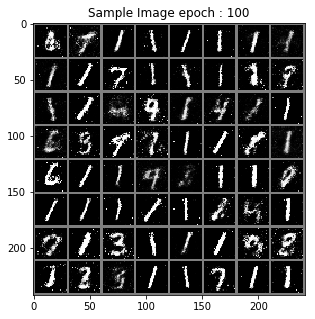

> Epoch : 102 Batch : 19 / 235 Loss_D : 0.4802286624908447 Loss_G : 3.1495771408081055
> Epoch : 102 Batch : 39 / 235 Loss_D : 0.4583568572998047 Loss_G : 2.8674979209899902
> Epoch : 102 Batch : 59 / 235 Loss_D : 0.4289860725402832 Loss_G : 2.894566535949707
> Epoch : 102 Batch : 79 / 235 Loss_D : 0.393965482711792 Loss_G : 2.649590015411377
> Epoch : 102 Batch : 99 / 235 Loss_D : 0.6225696802139282 Loss_G : 3.026589870452881
> Epoch : 102 Batch : 119 / 235 Loss_D : 0.4796450734138489 Loss_G : 3.010570526123047
> Epoch : 102 Batch : 139 / 235 Loss_D : 0.42577746510505676 Loss_G : 2.8170700073242188
> Epoch : 102 Batch : 159 / 235 Loss_D : 0.4838433861732483 Loss_G : 2.9131994247436523
> Epoch : 102 Batch : 179 / 235 Loss_D : 0.46349549293518066 Loss_G : 2.287548303604126
> Epoch : 102 Batch : 199 / 235 Loss_D : 0.3387949466705322 Loss_G : 3.4685468673706055
> Epoch : 102 Batch : 219 / 235 Loss_D : 0.48451656103134155 Loss_G : 2.8702733516693115


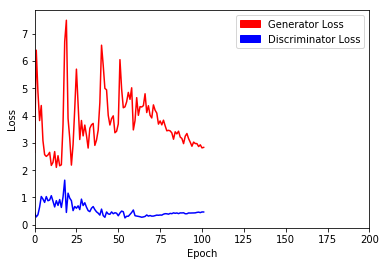

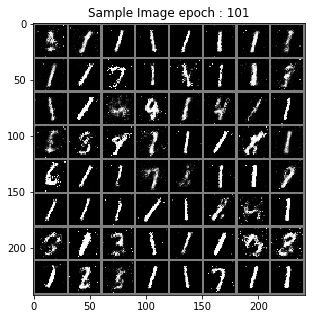

> Epoch : 103 Batch : 19 / 235 Loss_D : 0.46318480372428894 Loss_G : 2.7637689113616943
> Epoch : 103 Batch : 39 / 235 Loss_D : 0.5748497843742371 Loss_G : 2.613489866256714
> Epoch : 103 Batch : 59 / 235 Loss_D : 0.5005186200141907 Loss_G : 2.1012167930603027
> Epoch : 103 Batch : 79 / 235 Loss_D : 0.4795547425746918 Loss_G : 3.0879223346710205
> Epoch : 103 Batch : 99 / 235 Loss_D : 0.4762135148048401 Loss_G : 2.8718974590301514
> Epoch : 103 Batch : 119 / 235 Loss_D : 0.556817889213562 Loss_G : 2.3271262645721436
> Epoch : 103 Batch : 139 / 235 Loss_D : 0.4434249997138977 Loss_G : 2.7512924671173096
> Epoch : 103 Batch : 159 / 235 Loss_D : 0.4877467155456543 Loss_G : 2.521634578704834
> Epoch : 103 Batch : 179 / 235 Loss_D : 0.5268348455429077 Loss_G : 2.7204532623291016
> Epoch : 103 Batch : 199 / 235 Loss_D : 0.4839628040790558 Loss_G : 2.5476980209350586
> Epoch : 103 Batch : 219 / 235 Loss_D : 0.4865496754646301 Loss_G : 3.0526785850524902


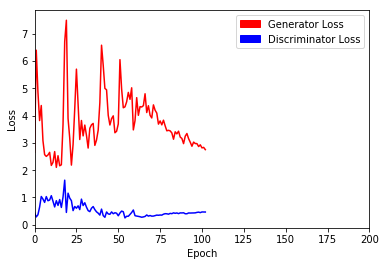

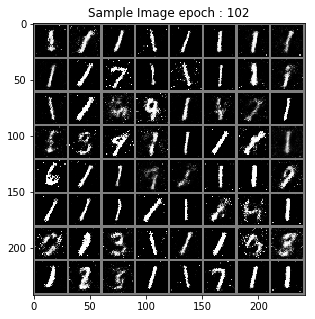

> Epoch : 104 Batch : 19 / 235 Loss_D : 0.47544586658477783 Loss_G : 2.3125908374786377
> Epoch : 104 Batch : 39 / 235 Loss_D : 0.3395431339740753 Loss_G : 3.5578532218933105
> Epoch : 104 Batch : 59 / 235 Loss_D : 0.3998171091079712 Loss_G : 2.5549514293670654
> Epoch : 104 Batch : 79 / 235 Loss_D : 0.514174222946167 Loss_G : 2.51826810836792
> Epoch : 104 Batch : 99 / 235 Loss_D : 0.5013484954833984 Loss_G : 2.3571553230285645
> Epoch : 104 Batch : 119 / 235 Loss_D : 0.49450069665908813 Loss_G : 2.735428810119629
> Epoch : 104 Batch : 139 / 235 Loss_D : 0.5119872093200684 Loss_G : 2.0647246837615967
> Epoch : 104 Batch : 159 / 235 Loss_D : 0.46822866797447205 Loss_G : 2.850958824157715
> Epoch : 104 Batch : 179 / 235 Loss_D : 0.42635685205459595 Loss_G : 2.590822219848633
> Epoch : 104 Batch : 199 / 235 Loss_D : 0.4390994906425476 Loss_G : 2.662721872329712
> Epoch : 104 Batch : 219 / 235 Loss_D : 0.576488733291626 Loss_G : 2.8408756256103516


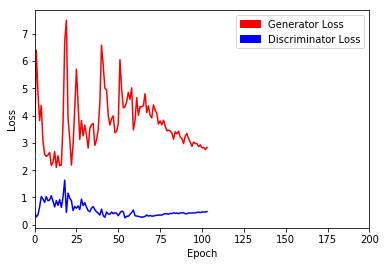

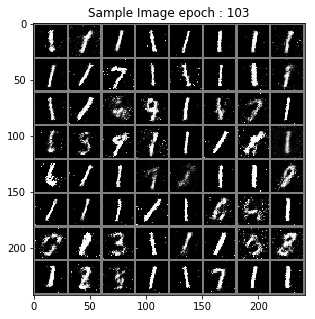

> Epoch : 105 Batch : 19 / 235 Loss_D : 0.5778212547302246 Loss_G : 2.2665657997131348
> Epoch : 105 Batch : 39 / 235 Loss_D : 0.40747135877609253 Loss_G : 2.705763339996338
> Epoch : 105 Batch : 59 / 235 Loss_D : 0.4520936906337738 Loss_G : 2.5222129821777344
> Epoch : 105 Batch : 79 / 235 Loss_D : 0.35438448190689087 Loss_G : 2.8233463764190674
> Epoch : 105 Batch : 99 / 235 Loss_D : 0.3995097875595093 Loss_G : 2.645949125289917
> Epoch : 105 Batch : 119 / 235 Loss_D : 0.33678343892097473 Loss_G : 3.2828001976013184
> Epoch : 105 Batch : 139 / 235 Loss_D : 0.4532930254936218 Loss_G : 2.523794651031494
> Epoch : 105 Batch : 159 / 235 Loss_D : 0.43067431449890137 Loss_G : 2.3386473655700684
> Epoch : 105 Batch : 179 / 235 Loss_D : 0.41939735412597656 Loss_G : 2.8583662509918213
> Epoch : 105 Batch : 199 / 235 Loss_D : 0.40609970688819885 Loss_G : 3.0038955211639404
> Epoch : 105 Batch : 219 / 235 Loss_D : 0.4610339403152466 Loss_G : 2.552915573120117


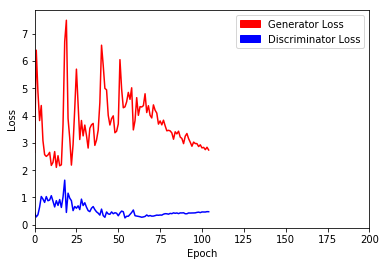

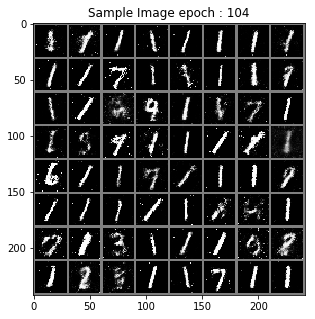

> Epoch : 106 Batch : 19 / 235 Loss_D : 0.4351278841495514 Loss_G : 2.9836671352386475
> Epoch : 106 Batch : 39 / 235 Loss_D : 0.3461582362651825 Loss_G : 3.025636672973633
> Epoch : 106 Batch : 59 / 235 Loss_D : 0.48471784591674805 Loss_G : 2.564218044281006
> Epoch : 106 Batch : 79 / 235 Loss_D : 0.40852516889572144 Loss_G : 2.320646286010742
> Epoch : 106 Batch : 99 / 235 Loss_D : 0.5326050519943237 Loss_G : 3.1439921855926514
> Epoch : 106 Batch : 119 / 235 Loss_D : 0.4378734827041626 Loss_G : 2.879549503326416
> Epoch : 106 Batch : 139 / 235 Loss_D : 0.5114625692367554 Loss_G : 2.9562888145446777
> Epoch : 106 Batch : 159 / 235 Loss_D : 0.5380213260650635 Loss_G : 3.2661828994750977
> Epoch : 106 Batch : 179 / 235 Loss_D : 0.45212486386299133 Loss_G : 2.8346052169799805
> Epoch : 106 Batch : 199 / 235 Loss_D : 0.3767246901988983 Loss_G : 2.720427989959717
> Epoch : 106 Batch : 219 / 235 Loss_D : 0.5146962404251099 Loss_G : 2.351163864135742


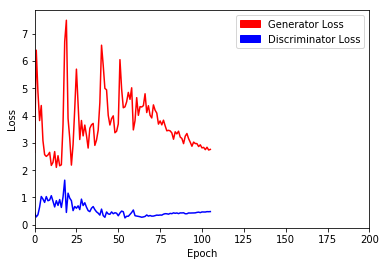

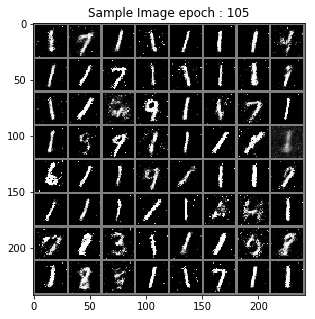

> Epoch : 107 Batch : 19 / 235 Loss_D : 0.49644678831100464 Loss_G : 2.498340606689453
> Epoch : 107 Batch : 39 / 235 Loss_D : 0.5569967031478882 Loss_G : 2.3994030952453613
> Epoch : 107 Batch : 59 / 235 Loss_D : 0.3798229992389679 Loss_G : 3.2080113887786865
> Epoch : 107 Batch : 79 / 235 Loss_D : 0.4582725167274475 Loss_G : 2.9503884315490723
> Epoch : 107 Batch : 99 / 235 Loss_D : 0.5571655035018921 Loss_G : 2.980222702026367
> Epoch : 107 Batch : 119 / 235 Loss_D : 0.4598856568336487 Loss_G : 2.698326826095581
> Epoch : 107 Batch : 139 / 235 Loss_D : 0.45764195919036865 Loss_G : 2.51357364654541
> Epoch : 107 Batch : 159 / 235 Loss_D : 0.42794376611709595 Loss_G : 2.885126829147339
> Epoch : 107 Batch : 179 / 235 Loss_D : 0.4320570230484009 Loss_G : 3.14595103263855
> Epoch : 107 Batch : 199 / 235 Loss_D : 0.5043424367904663 Loss_G : 3.3935294151306152
> Epoch : 107 Batch : 219 / 235 Loss_D : 0.5008922815322876 Loss_G : 2.6700992584228516


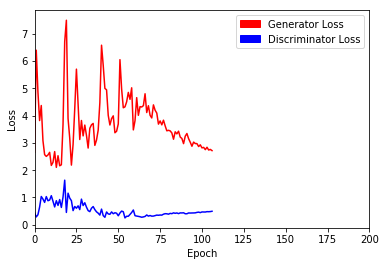

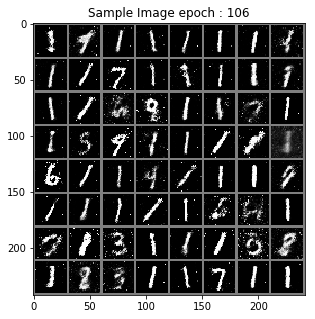

> Epoch : 108 Batch : 19 / 235 Loss_D : 0.5794130563735962 Loss_G : 2.2800397872924805
> Epoch : 108 Batch : 39 / 235 Loss_D : 0.4459243416786194 Loss_G : 2.135850667953491
> Epoch : 108 Batch : 59 / 235 Loss_D : 0.4945232570171356 Loss_G : 2.2247824668884277
> Epoch : 108 Batch : 79 / 235 Loss_D : 0.5396380424499512 Loss_G : 2.6118974685668945
> Epoch : 108 Batch : 99 / 235 Loss_D : 0.5457087755203247 Loss_G : 2.463475465774536
> Epoch : 108 Batch : 119 / 235 Loss_D : 0.5105561017990112 Loss_G : 2.433772563934326
> Epoch : 108 Batch : 139 / 235 Loss_D : 0.4694308638572693 Loss_G : 2.6092493534088135
> Epoch : 108 Batch : 159 / 235 Loss_D : 0.5328810214996338 Loss_G : 2.085573434829712
> Epoch : 108 Batch : 179 / 235 Loss_D : 0.4662437438964844 Loss_G : 2.456449508666992
> Epoch : 108 Batch : 199 / 235 Loss_D : 0.40380677580833435 Loss_G : 3.027845859527588
> Epoch : 108 Batch : 219 / 235 Loss_D : 0.37110474705696106 Loss_G : 3.0443077087402344


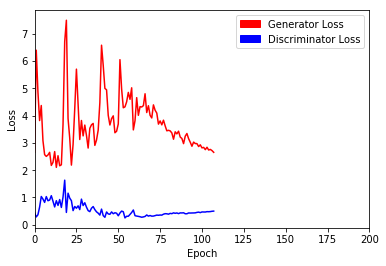

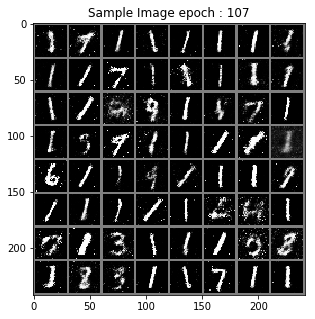

> Epoch : 109 Batch : 19 / 235 Loss_D : 0.46574974060058594 Loss_G : 2.3141260147094727
> Epoch : 109 Batch : 39 / 235 Loss_D : 0.448800265789032 Loss_G : 2.491726875305176
> Epoch : 109 Batch : 59 / 235 Loss_D : 0.5285375118255615 Loss_G : 2.60428524017334
> Epoch : 109 Batch : 79 / 235 Loss_D : 0.5666048526763916 Loss_G : 2.1564254760742188
> Epoch : 109 Batch : 99 / 235 Loss_D : 0.4442371726036072 Loss_G : 2.953706741333008
> Epoch : 109 Batch : 119 / 235 Loss_D : 0.3227907121181488 Loss_G : 3.2019155025482178
> Epoch : 109 Batch : 139 / 235 Loss_D : 0.5821659564971924 Loss_G : 2.959197998046875
> Epoch : 109 Batch : 159 / 235 Loss_D : 0.5456032156944275 Loss_G : 3.0001776218414307
> Epoch : 109 Batch : 179 / 235 Loss_D : 0.550747275352478 Loss_G : 2.90195631980896
> Epoch : 109 Batch : 199 / 235 Loss_D : 0.4939813017845154 Loss_G : 2.496194839477539
> Epoch : 109 Batch : 219 / 235 Loss_D : 0.4335152506828308 Loss_G : 2.450165033340454


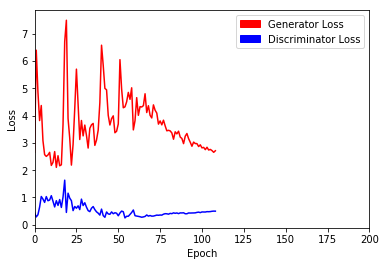

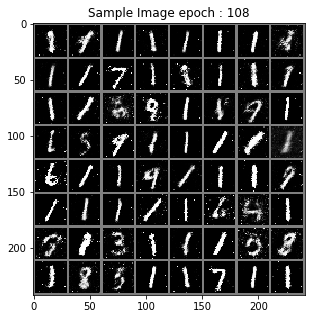

> Epoch : 110 Batch : 19 / 235 Loss_D : 0.4791565537452698 Loss_G : 2.595574378967285
> Epoch : 110 Batch : 39 / 235 Loss_D : 0.5273131132125854 Loss_G : 2.4964418411254883
> Epoch : 110 Batch : 59 / 235 Loss_D : 0.49782028794288635 Loss_G : 2.6145167350769043
> Epoch : 110 Batch : 79 / 235 Loss_D : 0.5636671185493469 Loss_G : 2.5523033142089844
> Epoch : 110 Batch : 99 / 235 Loss_D : 0.4340110123157501 Loss_G : 3.1155951023101807
> Epoch : 110 Batch : 119 / 235 Loss_D : 0.6036458611488342 Loss_G : 2.5387864112854004
> Epoch : 110 Batch : 139 / 235 Loss_D : 0.4462697505950928 Loss_G : 3.0887041091918945
> Epoch : 110 Batch : 159 / 235 Loss_D : 0.4845978617668152 Loss_G : 2.9497008323669434
> Epoch : 110 Batch : 179 / 235 Loss_D : 0.6308410167694092 Loss_G : 2.3714759349823
> Epoch : 110 Batch : 199 / 235 Loss_D : 0.4951924681663513 Loss_G : 2.3226780891418457
> Epoch : 110 Batch : 219 / 235 Loss_D : 0.542701005935669 Loss_G : 2.2314682006835938


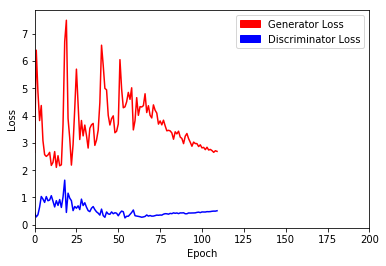

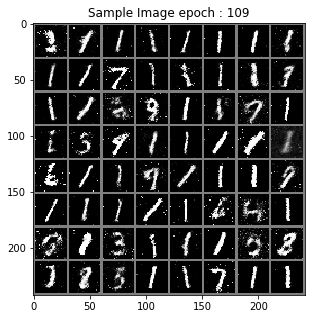

> Epoch : 111 Batch : 19 / 235 Loss_D : 0.4966917037963867 Loss_G : 2.377091407775879
> Epoch : 111 Batch : 39 / 235 Loss_D : 0.511394739151001 Loss_G : 3.302828073501587
> Epoch : 111 Batch : 59 / 235 Loss_D : 0.5464000701904297 Loss_G : 2.2053728103637695
> Epoch : 111 Batch : 79 / 235 Loss_D : 0.5010280013084412 Loss_G : 2.787081480026245
> Epoch : 111 Batch : 99 / 235 Loss_D : 0.4131709337234497 Loss_G : 2.7079668045043945
> Epoch : 111 Batch : 119 / 235 Loss_D : 0.45459240674972534 Loss_G : 2.4841203689575195
> Epoch : 111 Batch : 139 / 235 Loss_D : 0.4635820984840393 Loss_G : 2.578190326690674
> Epoch : 111 Batch : 159 / 235 Loss_D : 0.5375844836235046 Loss_G : 2.4249658584594727
> Epoch : 111 Batch : 179 / 235 Loss_D : 0.4844079613685608 Loss_G : 2.1334595680236816
> Epoch : 111 Batch : 199 / 235 Loss_D : 0.5018815994262695 Loss_G : 2.708416700363159
> Epoch : 111 Batch : 219 / 235 Loss_D : 0.5976248979568481 Loss_G : 2.600827217102051


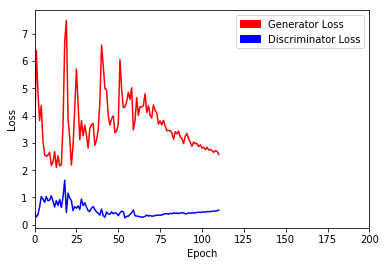

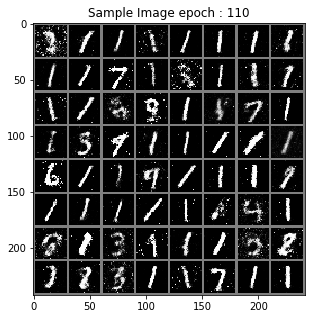

> Epoch : 112 Batch : 19 / 235 Loss_D : 0.566788911819458 Loss_G : 2.1163711547851562
> Epoch : 112 Batch : 39 / 235 Loss_D : 0.3884422779083252 Loss_G : 2.4311163425445557
> Epoch : 112 Batch : 59 / 235 Loss_D : 0.5339698791503906 Loss_G : 2.494513988494873
> Epoch : 112 Batch : 79 / 235 Loss_D : 0.5881759524345398 Loss_G : 2.099733591079712
> Epoch : 112 Batch : 99 / 235 Loss_D : 0.5369440317153931 Loss_G : 2.4642956256866455
> Epoch : 112 Batch : 119 / 235 Loss_D : 0.5817945003509521 Loss_G : 2.4215612411499023
> Epoch : 112 Batch : 139 / 235 Loss_D : 0.5168986320495605 Loss_G : 2.5974135398864746
> Epoch : 112 Batch : 159 / 235 Loss_D : 0.539915919303894 Loss_G : 2.2731432914733887
> Epoch : 112 Batch : 179 / 235 Loss_D : 0.4820777177810669 Loss_G : 2.19244647026062
> Epoch : 112 Batch : 199 / 235 Loss_D : 0.5298862457275391 Loss_G : 2.496438503265381
> Epoch : 112 Batch : 219 / 235 Loss_D : 0.4967260956764221 Loss_G : 2.222423553466797


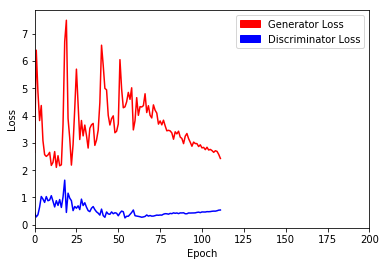

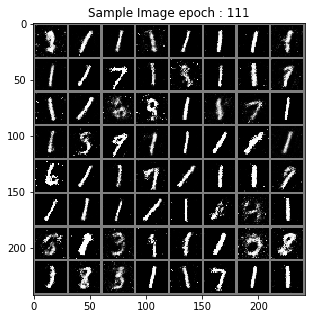

> Epoch : 113 Batch : 19 / 235 Loss_D : 0.587513267993927 Loss_G : 3.037557363510132
> Epoch : 113 Batch : 39 / 235 Loss_D : 0.5130685567855835 Loss_G : 2.134902000427246
> Epoch : 113 Batch : 59 / 235 Loss_D : 0.5473785996437073 Loss_G : 2.3024840354919434
> Epoch : 113 Batch : 79 / 235 Loss_D : 0.5818548202514648 Loss_G : 2.4398865699768066
> Epoch : 113 Batch : 99 / 235 Loss_D : 0.3448473811149597 Loss_G : 3.2137372493743896
> Epoch : 113 Batch : 119 / 235 Loss_D : 0.7194366455078125 Loss_G : 1.914138913154602
> Epoch : 113 Batch : 139 / 235 Loss_D : 0.5433899760246277 Loss_G : 2.3310441970825195
> Epoch : 113 Batch : 159 / 235 Loss_D : 0.5905875563621521 Loss_G : 2.509420394897461
> Epoch : 113 Batch : 179 / 235 Loss_D : 0.5635009407997131 Loss_G : 2.4299111366271973
> Epoch : 113 Batch : 199 / 235 Loss_D : 0.6031744480133057 Loss_G : 2.7586615085601807
> Epoch : 113 Batch : 219 / 235 Loss_D : 0.5718786716461182 Loss_G : 2.458432674407959


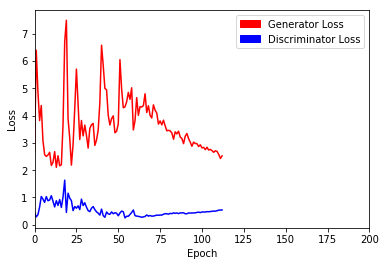

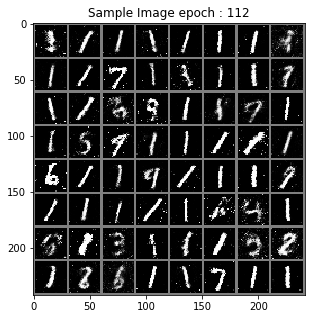

> Epoch : 114 Batch : 19 / 235 Loss_D : 0.5880147814750671 Loss_G : 2.2193217277526855
> Epoch : 114 Batch : 39 / 235 Loss_D : 0.5170869827270508 Loss_G : 2.585383415222168
> Epoch : 114 Batch : 59 / 235 Loss_D : 0.5754435062408447 Loss_G : 2.8082785606384277
> Epoch : 114 Batch : 79 / 235 Loss_D : 0.7326192855834961 Loss_G : 2.2700254917144775
> Epoch : 114 Batch : 99 / 235 Loss_D : 0.47732990980148315 Loss_G : 2.412280559539795
> Epoch : 114 Batch : 119 / 235 Loss_D : 0.5000826716423035 Loss_G : 2.3494672775268555
> Epoch : 114 Batch : 139 / 235 Loss_D : 0.4392987787723541 Loss_G : 3.131226062774658
> Epoch : 114 Batch : 159 / 235 Loss_D : 0.652778148651123 Loss_G : 2.2892165184020996
> Epoch : 114 Batch : 179 / 235 Loss_D : 0.5554753541946411 Loss_G : 2.704636335372925
> Epoch : 114 Batch : 199 / 235 Loss_D : 0.6446666717529297 Loss_G : 2.7381350994110107
> Epoch : 114 Batch : 219 / 235 Loss_D : 0.5728060007095337 Loss_G : 2.5509891510009766


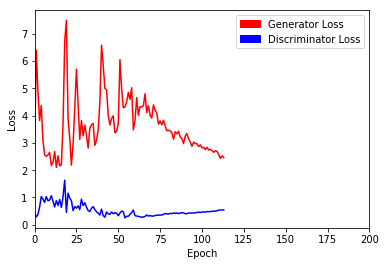

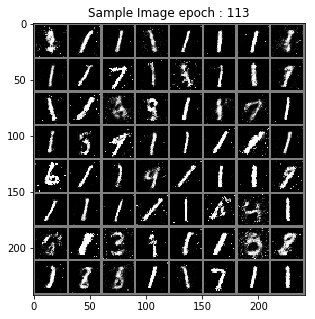

> Epoch : 115 Batch : 19 / 235 Loss_D : 0.5653882026672363 Loss_G : 2.5367283821105957
> Epoch : 115 Batch : 39 / 235 Loss_D : 0.5931311845779419 Loss_G : 2.691908121109009
> Epoch : 115 Batch : 59 / 235 Loss_D : 0.5642666220664978 Loss_G : 2.521432638168335
> Epoch : 115 Batch : 79 / 235 Loss_D : 0.51888507604599 Loss_G : 2.7108922004699707
> Epoch : 115 Batch : 99 / 235 Loss_D : 0.53450608253479 Loss_G : 2.1652145385742188
> Epoch : 115 Batch : 119 / 235 Loss_D : 0.609114408493042 Loss_G : 3.059093952178955
> Epoch : 115 Batch : 139 / 235 Loss_D : 0.5370527505874634 Loss_G : 2.9431605339050293
> Epoch : 115 Batch : 159 / 235 Loss_D : 0.6770326495170593 Loss_G : 2.2066431045532227
> Epoch : 115 Batch : 179 / 235 Loss_D : 0.6122424602508545 Loss_G : 2.0895705223083496
> Epoch : 115 Batch : 199 / 235 Loss_D : 0.5313346982002258 Loss_G : 2.431882381439209
> Epoch : 115 Batch : 219 / 235 Loss_D : 0.6291987895965576 Loss_G : 2.5085339546203613


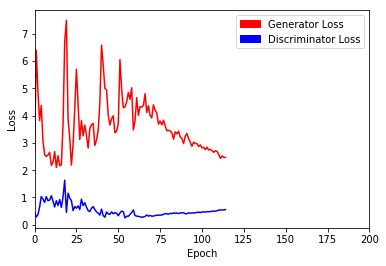

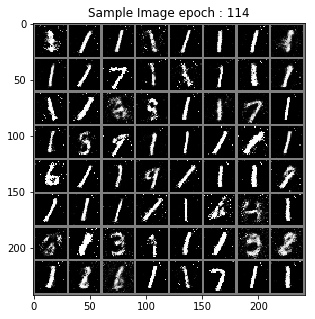

> Epoch : 116 Batch : 19 / 235 Loss_D : 0.5138235688209534 Loss_G : 3.0702221393585205
> Epoch : 116 Batch : 39 / 235 Loss_D : 0.5736978650093079 Loss_G : 2.2487549781799316
> Epoch : 116 Batch : 59 / 235 Loss_D : 0.4439408481121063 Loss_G : 2.867847204208374
> Epoch : 116 Batch : 79 / 235 Loss_D : 0.587134063243866 Loss_G : 1.9774192571640015
> Epoch : 116 Batch : 99 / 235 Loss_D : 0.6261975765228271 Loss_G : 2.403247833251953
> Epoch : 116 Batch : 119 / 235 Loss_D : 0.49770402908325195 Loss_G : 2.8273849487304688
> Epoch : 116 Batch : 139 / 235 Loss_D : 0.4931899607181549 Loss_G : 2.5671567916870117
> Epoch : 116 Batch : 159 / 235 Loss_D : 0.5752524137496948 Loss_G : 2.2286782264709473
> Epoch : 116 Batch : 179 / 235 Loss_D : 0.6012306213378906 Loss_G : 2.6361656188964844
> Epoch : 116 Batch : 199 / 235 Loss_D : 0.5817602276802063 Loss_G : 2.423788547515869
> Epoch : 116 Batch : 219 / 235 Loss_D : 0.5666533708572388 Loss_G : 1.9848194122314453


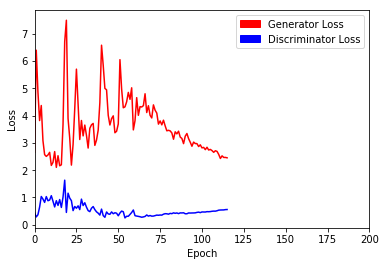

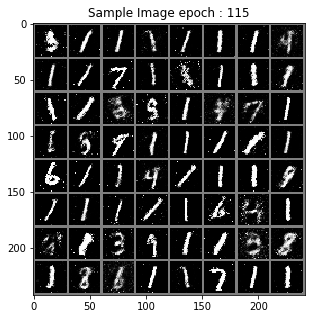

> Epoch : 117 Batch : 19 / 235 Loss_D : 0.6436132788658142 Loss_G : 1.9303044080734253
> Epoch : 117 Batch : 39 / 235 Loss_D : 0.5550399422645569 Loss_G : 1.9785757064819336
> Epoch : 117 Batch : 59 / 235 Loss_D : 0.4560067057609558 Loss_G : 2.7574448585510254
> Epoch : 117 Batch : 79 / 235 Loss_D : 0.5011175870895386 Loss_G : 2.1882362365722656
> Epoch : 117 Batch : 99 / 235 Loss_D : 0.5178077220916748 Loss_G : 2.568171501159668
> Epoch : 117 Batch : 119 / 235 Loss_D : 0.5816258788108826 Loss_G : 2.603290319442749
> Epoch : 117 Batch : 139 / 235 Loss_D : 0.6835401654243469 Loss_G : 1.8792893886566162
> Epoch : 117 Batch : 159 / 235 Loss_D : 0.5477430820465088 Loss_G : 2.001516342163086
> Epoch : 117 Batch : 179 / 235 Loss_D : 0.5834481716156006 Loss_G : 2.4390382766723633
> Epoch : 117 Batch : 199 / 235 Loss_D : 0.615062952041626 Loss_G : 2.163783550262451
> Epoch : 117 Batch : 219 / 235 Loss_D : 0.6418312788009644 Loss_G : 1.989978551864624


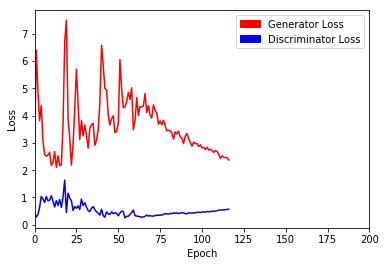

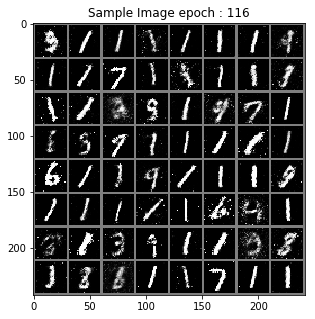

> Epoch : 118 Batch : 19 / 235 Loss_D : 0.6560712456703186 Loss_G : 2.1991889476776123
> Epoch : 118 Batch : 39 / 235 Loss_D : 0.551888108253479 Loss_G : 2.379075050354004
> Epoch : 118 Batch : 59 / 235 Loss_D : 0.530394434928894 Loss_G : 2.7919065952301025
> Epoch : 118 Batch : 79 / 235 Loss_D : 0.7101823091506958 Loss_G : 1.9983751773834229
> Epoch : 118 Batch : 99 / 235 Loss_D : 0.5193039178848267 Loss_G : 2.3603665828704834
> Epoch : 118 Batch : 119 / 235 Loss_D : 0.4499732255935669 Loss_G : 2.9026474952697754
> Epoch : 118 Batch : 139 / 235 Loss_D : 0.5986407399177551 Loss_G : 2.535665512084961
> Epoch : 118 Batch : 159 / 235 Loss_D : 0.5797186493873596 Loss_G : 2.6552796363830566
> Epoch : 118 Batch : 179 / 235 Loss_D : 0.6881431341171265 Loss_G : 2.2915735244750977
> Epoch : 118 Batch : 199 / 235 Loss_D : 0.5206937789916992 Loss_G : 2.354012966156006
> Epoch : 118 Batch : 219 / 235 Loss_D : 0.5913565158843994 Loss_G : 2.598520278930664


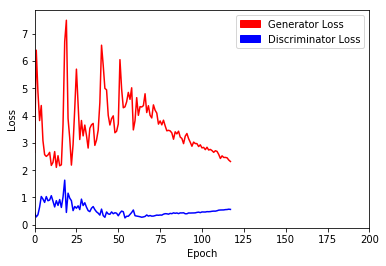

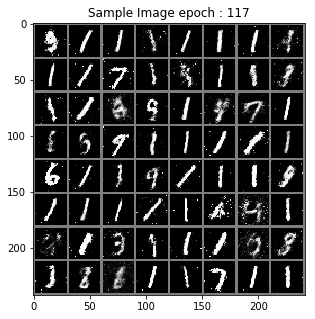

> Epoch : 119 Batch : 19 / 235 Loss_D : 0.5627996921539307 Loss_G : 2.087346315383911
> Epoch : 119 Batch : 39 / 235 Loss_D : 0.46719154715538025 Loss_G : 2.4914324283599854
> Epoch : 119 Batch : 59 / 235 Loss_D : 0.5727234482765198 Loss_G : 2.012873649597168
> Epoch : 119 Batch : 79 / 235 Loss_D : 0.5833760499954224 Loss_G : 2.1653857231140137
> Epoch : 119 Batch : 99 / 235 Loss_D : 0.44518354535102844 Loss_G : 2.117046356201172
> Epoch : 119 Batch : 119 / 235 Loss_D : 0.580075740814209 Loss_G : 2.6381516456604004
> Epoch : 119 Batch : 139 / 235 Loss_D : 0.6071732640266418 Loss_G : 2.0911598205566406
> Epoch : 119 Batch : 159 / 235 Loss_D : 0.5931437015533447 Loss_G : 2.378103017807007
> Epoch : 119 Batch : 179 / 235 Loss_D : 0.5381499528884888 Loss_G : 1.9551472663879395
> Epoch : 119 Batch : 199 / 235 Loss_D : 0.5767532587051392 Loss_G : 1.9007264375686646
> Epoch : 119 Batch : 219 / 235 Loss_D : 0.4822922348976135 Loss_G : 2.5559582710266113


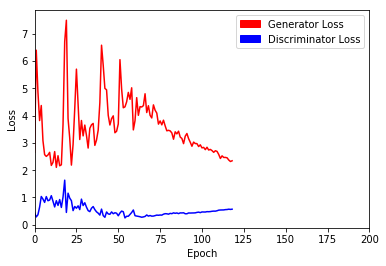

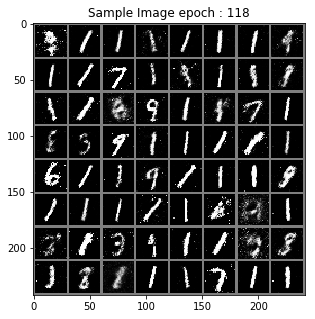

> Epoch : 120 Batch : 19 / 235 Loss_D : 0.5187304019927979 Loss_G : 2.388047695159912
> Epoch : 120 Batch : 39 / 235 Loss_D : 0.644943118095398 Loss_G : 2.0863518714904785
> Epoch : 120 Batch : 59 / 235 Loss_D : 0.5444940328598022 Loss_G : 2.3336119651794434
> Epoch : 120 Batch : 79 / 235 Loss_D : 0.5995792150497437 Loss_G : 2.330629825592041
> Epoch : 120 Batch : 99 / 235 Loss_D : 0.6148678064346313 Loss_G : 2.191427707672119
> Epoch : 120 Batch : 119 / 235 Loss_D : 0.7079366445541382 Loss_G : 2.128746509552002
> Epoch : 120 Batch : 139 / 235 Loss_D : 0.5279762744903564 Loss_G : 2.6336660385131836
> Epoch : 120 Batch : 159 / 235 Loss_D : 0.5094729661941528 Loss_G : 2.5191524028778076
> Epoch : 120 Batch : 179 / 235 Loss_D : 0.5820555686950684 Loss_G : 2.306220054626465
> Epoch : 120 Batch : 199 / 235 Loss_D : 0.5931008458137512 Loss_G : 2.459369659423828
> Epoch : 120 Batch : 219 / 235 Loss_D : 0.5626888275146484 Loss_G : 2.406639575958252


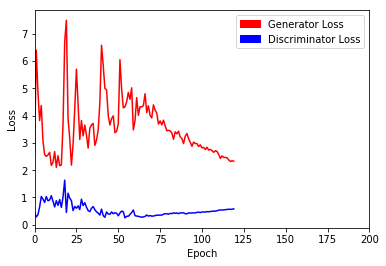

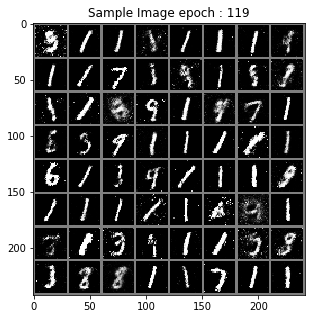

> Epoch : 121 Batch : 19 / 235 Loss_D : 0.5414124727249146 Loss_G : 2.2809181213378906
> Epoch : 121 Batch : 39 / 235 Loss_D : 0.5107817649841309 Loss_G : 2.474931478500366
> Epoch : 121 Batch : 59 / 235 Loss_D : 0.5567261576652527 Loss_G : 2.3950300216674805
> Epoch : 121 Batch : 79 / 235 Loss_D : 0.6573896408081055 Loss_G : 2.0415117740631104
> Epoch : 121 Batch : 99 / 235 Loss_D : 0.5538709163665771 Loss_G : 2.7088797092437744
> Epoch : 121 Batch : 119 / 235 Loss_D : 0.6246010661125183 Loss_G : 2.4859981536865234
> Epoch : 121 Batch : 139 / 235 Loss_D : 0.5891793966293335 Loss_G : 2.5653247833251953
> Epoch : 121 Batch : 159 / 235 Loss_D : 0.6496400833129883 Loss_G : 2.2708213329315186
> Epoch : 121 Batch : 179 / 235 Loss_D : 0.5446922183036804 Loss_G : 2.5749683380126953
> Epoch : 121 Batch : 199 / 235 Loss_D : 0.5059515237808228 Loss_G : 2.6363277435302734
> Epoch : 121 Batch : 219 / 235 Loss_D : 0.6977401971817017 Loss_G : 2.320488691329956


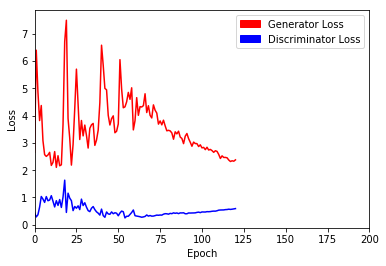

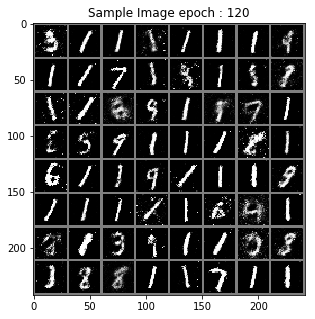

> Epoch : 122 Batch : 19 / 235 Loss_D : 0.6186151504516602 Loss_G : 1.804527997970581
> Epoch : 122 Batch : 39 / 235 Loss_D : 0.515265703201294 Loss_G : 2.7087626457214355
> Epoch : 122 Batch : 59 / 235 Loss_D : 0.7207434177398682 Loss_G : 2.8495216369628906
> Epoch : 122 Batch : 79 / 235 Loss_D : 0.5727396011352539 Loss_G : 2.195239305496216
> Epoch : 122 Batch : 99 / 235 Loss_D : 0.45829248428344727 Loss_G : 2.3190460205078125
> Epoch : 122 Batch : 119 / 235 Loss_D : 0.5966347455978394 Loss_G : 2.682800769805908
> Epoch : 122 Batch : 139 / 235 Loss_D : 0.5574806928634644 Loss_G : 2.655543327331543
> Epoch : 122 Batch : 159 / 235 Loss_D : 0.6413098573684692 Loss_G : 2.1028079986572266
> Epoch : 122 Batch : 179 / 235 Loss_D : 0.5643277168273926 Loss_G : 2.393042802810669
> Epoch : 122 Batch : 199 / 235 Loss_D : 0.6644497513771057 Loss_G : 1.8636610507965088
> Epoch : 122 Batch : 219 / 235 Loss_D : 0.6431551575660706 Loss_G : 1.836960792541504


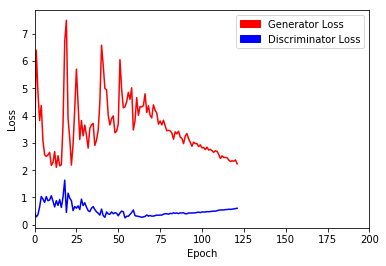

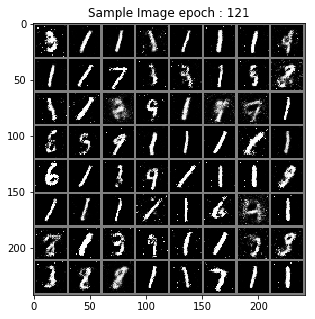

> Epoch : 123 Batch : 19 / 235 Loss_D : 0.6421482563018799 Loss_G : 2.1481263637542725
> Epoch : 123 Batch : 39 / 235 Loss_D : 0.550745964050293 Loss_G : 2.630751371383667
> Epoch : 123 Batch : 59 / 235 Loss_D : 0.6870149374008179 Loss_G : 1.900032877922058
> Epoch : 123 Batch : 79 / 235 Loss_D : 0.6763042211532593 Loss_G : 2.028310775756836
> Epoch : 123 Batch : 99 / 235 Loss_D : 0.6477941274642944 Loss_G : 1.8465337753295898
> Epoch : 123 Batch : 119 / 235 Loss_D : 0.45297789573669434 Loss_G : 2.3610031604766846
> Epoch : 123 Batch : 139 / 235 Loss_D : 0.6257719397544861 Loss_G : 1.9672257900238037
> Epoch : 123 Batch : 159 / 235 Loss_D : 0.6405566930770874 Loss_G : 2.3729259967803955
> Epoch : 123 Batch : 179 / 235 Loss_D : 0.5945316553115845 Loss_G : 2.0683488845825195
> Epoch : 123 Batch : 199 / 235 Loss_D : 0.5677806735038757 Loss_G : 2.495349168777466
> Epoch : 123 Batch : 219 / 235 Loss_D : 0.5512294769287109 Loss_G : 2.1800899505615234


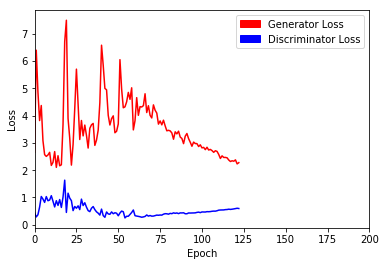

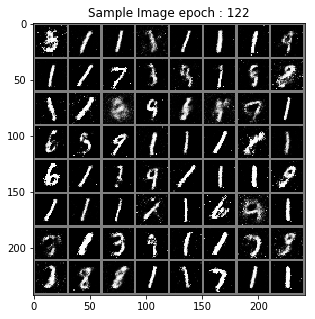

> Epoch : 124 Batch : 19 / 235 Loss_D : 0.5866996645927429 Loss_G : 2.0093536376953125
> Epoch : 124 Batch : 39 / 235 Loss_D : 0.5709590911865234 Loss_G : 2.437098979949951
> Epoch : 124 Batch : 59 / 235 Loss_D : 0.6032773852348328 Loss_G : 2.0909063816070557
> Epoch : 124 Batch : 79 / 235 Loss_D : 0.4883924424648285 Loss_G : 2.4244446754455566
> Epoch : 124 Batch : 99 / 235 Loss_D : 0.6725020408630371 Loss_G : 2.1869194507598877
> Epoch : 124 Batch : 119 / 235 Loss_D : 0.4355473220348358 Loss_G : 2.930387496948242
> Epoch : 124 Batch : 139 / 235 Loss_D : 0.7920182943344116 Loss_G : 1.878849983215332
> Epoch : 124 Batch : 159 / 235 Loss_D : 0.5676933526992798 Loss_G : 2.2466726303100586
> Epoch : 124 Batch : 179 / 235 Loss_D : 0.4768746793270111 Loss_G : 2.1859755516052246
> Epoch : 124 Batch : 199 / 235 Loss_D : 0.6230703592300415 Loss_G : 2.6078603267669678
> Epoch : 124 Batch : 219 / 235 Loss_D : 0.6540833711624146 Loss_G : 2.083409309387207


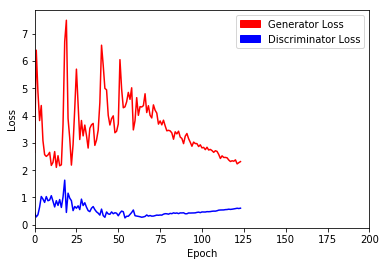

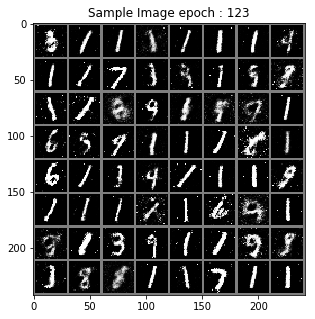

> Epoch : 125 Batch : 19 / 235 Loss_D : 0.588604211807251 Loss_G : 1.8494925498962402
> Epoch : 125 Batch : 39 / 235 Loss_D : 0.6870605945587158 Loss_G : 2.134608745574951
> Epoch : 125 Batch : 59 / 235 Loss_D : 0.5631898641586304 Loss_G : 2.28627347946167
> Epoch : 125 Batch : 79 / 235 Loss_D : 0.6195063591003418 Loss_G : 2.2750213146209717
> Epoch : 125 Batch : 99 / 235 Loss_D : 0.6690475940704346 Loss_G : 2.023737907409668
> Epoch : 125 Batch : 119 / 235 Loss_D : 0.6063206195831299 Loss_G : 2.438606023788452
> Epoch : 125 Batch : 139 / 235 Loss_D : 0.5913466215133667 Loss_G : 2.5202605724334717
> Epoch : 125 Batch : 159 / 235 Loss_D : 0.5860717296600342 Loss_G : 2.309497833251953
> Epoch : 125 Batch : 179 / 235 Loss_D : 0.48756954073905945 Loss_G : 2.3593909740448
> Epoch : 125 Batch : 199 / 235 Loss_D : 0.5959853529930115 Loss_G : 2.578148365020752
> Epoch : 125 Batch : 219 / 235 Loss_D : 0.657602846622467 Loss_G : 1.9743120670318604


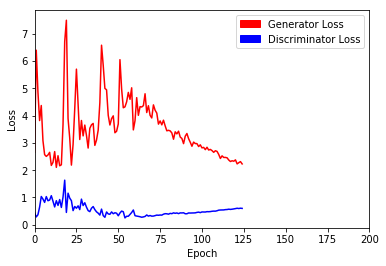

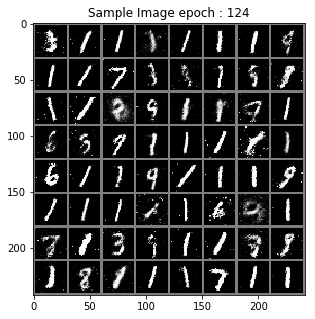

> Epoch : 126 Batch : 19 / 235 Loss_D : 0.5786793231964111 Loss_G : 2.278280735015869
> Epoch : 126 Batch : 39 / 235 Loss_D : 0.5662457942962646 Loss_G : 2.422966957092285
> Epoch : 126 Batch : 59 / 235 Loss_D : 0.6490534543991089 Loss_G : 2.305745840072632
> Epoch : 126 Batch : 79 / 235 Loss_D : 0.577086329460144 Loss_G : 2.403128147125244
> Epoch : 126 Batch : 99 / 235 Loss_D : 0.48866280913352966 Loss_G : 2.801185369491577
> Epoch : 126 Batch : 119 / 235 Loss_D : 0.6302352547645569 Loss_G : 2.149134874343872
> Epoch : 126 Batch : 139 / 235 Loss_D : 0.5773226618766785 Loss_G : 2.0434417724609375
> Epoch : 126 Batch : 159 / 235 Loss_D : 0.5755825638771057 Loss_G : 1.9308985471725464
> Epoch : 126 Batch : 179 / 235 Loss_D : 0.561726987361908 Loss_G : 2.2449886798858643
> Epoch : 126 Batch : 199 / 235 Loss_D : 0.6376681327819824 Loss_G : 1.8739807605743408
> Epoch : 126 Batch : 219 / 235 Loss_D : 0.5239299535751343 Loss_G : 2.2634940147399902


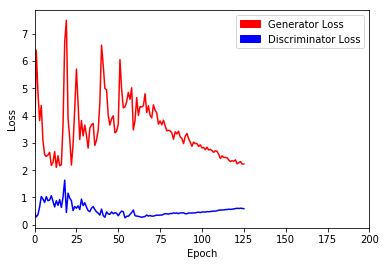

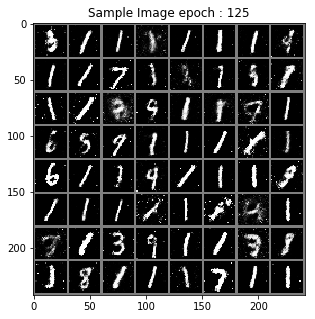

> Epoch : 127 Batch : 19 / 235 Loss_D : 0.5035083889961243 Loss_G : 2.3696749210357666
> Epoch : 127 Batch : 39 / 235 Loss_D : 0.592052698135376 Loss_G : 1.8409415483474731
> Epoch : 127 Batch : 59 / 235 Loss_D : 0.650553822517395 Loss_G : 2.208012342453003
> Epoch : 127 Batch : 79 / 235 Loss_D : 0.6018807888031006 Loss_G : 2.19377064704895
> Epoch : 127 Batch : 99 / 235 Loss_D : 0.5427453517913818 Loss_G : 2.3948605060577393
> Epoch : 127 Batch : 119 / 235 Loss_D : 0.7121516466140747 Loss_G : 1.8853758573532104
> Epoch : 127 Batch : 139 / 235 Loss_D : 0.6657094955444336 Loss_G : 2.2031445503234863
> Epoch : 127 Batch : 159 / 235 Loss_D : 0.5949069857597351 Loss_G : 1.8489539623260498
> Epoch : 127 Batch : 179 / 235 Loss_D : 0.6820353269577026 Loss_G : 1.9331474304199219
> Epoch : 127 Batch : 199 / 235 Loss_D : 0.5825966000556946 Loss_G : 2.1389362812042236
> Epoch : 127 Batch : 219 / 235 Loss_D : 0.6418840885162354 Loss_G : 2.1886277198791504


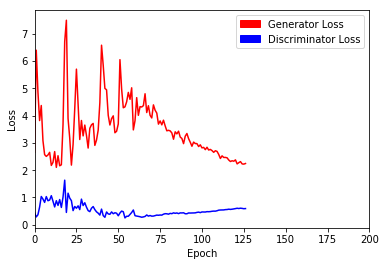

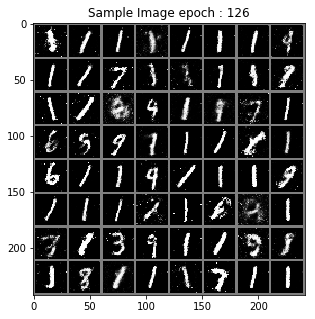

> Epoch : 128 Batch : 19 / 235 Loss_D : 0.6375507116317749 Loss_G : 2.281520366668701
> Epoch : 128 Batch : 39 / 235 Loss_D : 0.56070476770401 Loss_G : 1.7237536907196045
> Epoch : 128 Batch : 59 / 235 Loss_D : 0.5641114115715027 Loss_G : 2.472587823867798
> Epoch : 128 Batch : 79 / 235 Loss_D : 0.6074352264404297 Loss_G : 1.8956329822540283
> Epoch : 128 Batch : 99 / 235 Loss_D : 0.5895360708236694 Loss_G : 2.282555103302002
> Epoch : 128 Batch : 119 / 235 Loss_D : 0.5312759876251221 Loss_G : 2.168217658996582
> Epoch : 128 Batch : 139 / 235 Loss_D : 0.7141594886779785 Loss_G : 2.3264427185058594
> Epoch : 128 Batch : 159 / 235 Loss_D : 0.625475287437439 Loss_G : 2.2452313899993896
> Epoch : 128 Batch : 179 / 235 Loss_D : 0.538825273513794 Loss_G : 2.4620871543884277
> Epoch : 128 Batch : 199 / 235 Loss_D : 0.6253516674041748 Loss_G : 2.12532114982605
> Epoch : 128 Batch : 219 / 235 Loss_D : 0.6708402633666992 Loss_G : 2.2482802867889404


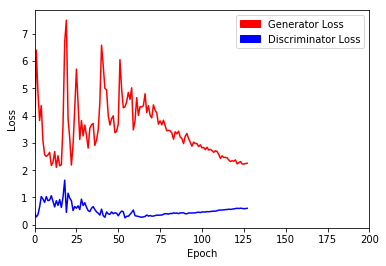

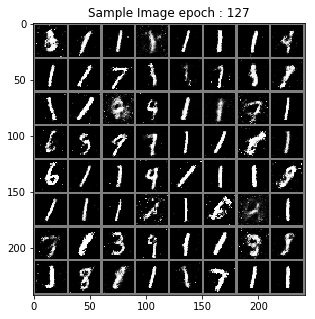

> Epoch : 129 Batch : 19 / 235 Loss_D : 0.5818794965744019 Loss_G : 2.162181854248047
> Epoch : 129 Batch : 39 / 235 Loss_D : 0.5912989377975464 Loss_G : 2.540372371673584
> Epoch : 129 Batch : 59 / 235 Loss_D : 0.6082414984703064 Loss_G : 2.1943061351776123
> Epoch : 129 Batch : 79 / 235 Loss_D : 0.6064721345901489 Loss_G : 2.2084622383117676
> Epoch : 129 Batch : 99 / 235 Loss_D : 0.6284865736961365 Loss_G : 2.1424708366394043
> Epoch : 129 Batch : 119 / 235 Loss_D : 0.5273170471191406 Loss_G : 2.429598569869995
> Epoch : 129 Batch : 139 / 235 Loss_D : 0.6718310713768005 Loss_G : 2.123258352279663
> Epoch : 129 Batch : 159 / 235 Loss_D : 0.6002682447433472 Loss_G : 2.3548507690429688
> Epoch : 129 Batch : 179 / 235 Loss_D : 0.6287009119987488 Loss_G : 2.6029059886932373
> Epoch : 129 Batch : 199 / 235 Loss_D : 0.6121889352798462 Loss_G : 1.9671555757522583
> Epoch : 129 Batch : 219 / 235 Loss_D : 0.7076796293258667 Loss_G : 2.150886058807373


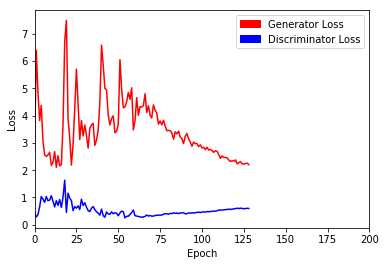

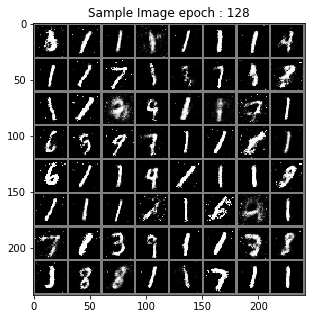

> Epoch : 130 Batch : 19 / 235 Loss_D : 0.5168546438217163 Loss_G : 2.5298852920532227
> Epoch : 130 Batch : 39 / 235 Loss_D : 0.6115760207176208 Loss_G : 2.48170804977417
> Epoch : 130 Batch : 59 / 235 Loss_D : 0.6080921292304993 Loss_G : 2.304664373397827
> Epoch : 130 Batch : 79 / 235 Loss_D : 0.5597361326217651 Loss_G : 2.3311874866485596
> Epoch : 130 Batch : 99 / 235 Loss_D : 0.5829030275344849 Loss_G : 1.9760029315948486
> Epoch : 130 Batch : 119 / 235 Loss_D : 0.6017604470252991 Loss_G : 2.1992788314819336
> Epoch : 130 Batch : 139 / 235 Loss_D : 0.5736857652664185 Loss_G : 2.11456561088562
> Epoch : 130 Batch : 159 / 235 Loss_D : 0.5760277509689331 Loss_G : 2.273517608642578
> Epoch : 130 Batch : 179 / 235 Loss_D : 0.6885521411895752 Loss_G : 1.8116273880004883
> Epoch : 130 Batch : 199 / 235 Loss_D : 0.548464298248291 Loss_G : 2.474907159805298
> Epoch : 130 Batch : 219 / 235 Loss_D : 0.6278964281082153 Loss_G : 2.092805862426758


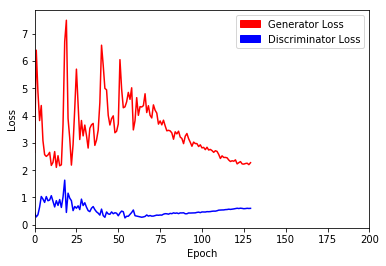

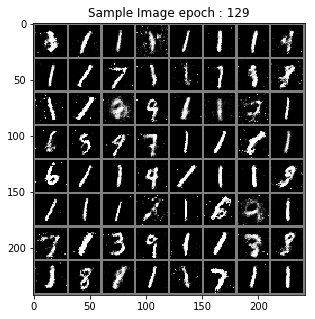

> Epoch : 131 Batch : 19 / 235 Loss_D : 0.5695528388023376 Loss_G : 2.1387104988098145
> Epoch : 131 Batch : 39 / 235 Loss_D : 0.6516596674919128 Loss_G : 2.1421055793762207
> Epoch : 131 Batch : 59 / 235 Loss_D : 0.6787512302398682 Loss_G : 2.05281138420105
> Epoch : 131 Batch : 79 / 235 Loss_D : 0.5243427157402039 Loss_G : 2.458595037460327
> Epoch : 131 Batch : 99 / 235 Loss_D : 0.7012960910797119 Loss_G : 2.439908027648926
> Epoch : 131 Batch : 119 / 235 Loss_D : 0.6029024124145508 Loss_G : 2.101229667663574
> Epoch : 131 Batch : 139 / 235 Loss_D : 0.4854884147644043 Loss_G : 2.477865219116211
> Epoch : 131 Batch : 159 / 235 Loss_D : 0.6939046382904053 Loss_G : 2.1245903968811035
> Epoch : 131 Batch : 179 / 235 Loss_D : 0.5510938167572021 Loss_G : 1.9513278007507324
> Epoch : 131 Batch : 199 / 235 Loss_D : 0.5883439779281616 Loss_G : 2.052199363708496
> Epoch : 131 Batch : 219 / 235 Loss_D : 0.6060667037963867 Loss_G : 2.22904109954834


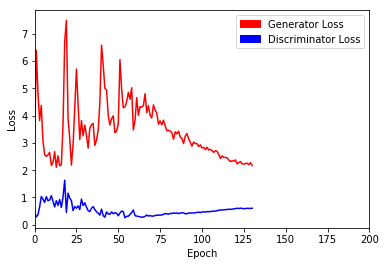

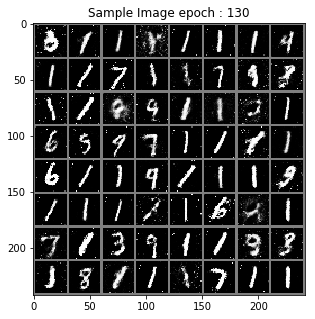

> Epoch : 132 Batch : 19 / 235 Loss_D : 0.5657663345336914 Loss_G : 1.9009082317352295
> Epoch : 132 Batch : 39 / 235 Loss_D : 0.603542149066925 Loss_G : 2.481175422668457
> Epoch : 132 Batch : 59 / 235 Loss_D : 0.6754830479621887 Loss_G : 1.5893275737762451
> Epoch : 132 Batch : 79 / 235 Loss_D : 0.5594187378883362 Loss_G : 2.307095527648926
> Epoch : 132 Batch : 99 / 235 Loss_D : 0.6837518215179443 Loss_G : 1.856529951095581
> Epoch : 132 Batch : 119 / 235 Loss_D : 0.6468023061752319 Loss_G : 2.062340259552002
> Epoch : 132 Batch : 139 / 235 Loss_D : 0.6404140591621399 Loss_G : 2.0174994468688965
> Epoch : 132 Batch : 159 / 235 Loss_D : 0.5879579186439514 Loss_G : 2.358781337738037
> Epoch : 132 Batch : 179 / 235 Loss_D : 0.7065780162811279 Loss_G : 1.7221310138702393
> Epoch : 132 Batch : 199 / 235 Loss_D : 0.6776355504989624 Loss_G : 1.7461864948272705
> Epoch : 132 Batch : 219 / 235 Loss_D : 0.7328548431396484 Loss_G : 1.9609262943267822


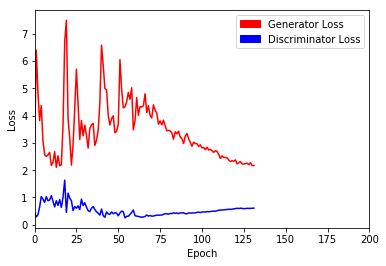

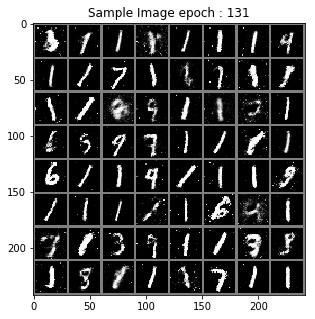

> Epoch : 133 Batch : 19 / 235 Loss_D : 0.5577628016471863 Loss_G : 2.4175186157226562
> Epoch : 133 Batch : 39 / 235 Loss_D : 0.5978666543960571 Loss_G : 2.3410449028015137
> Epoch : 133 Batch : 59 / 235 Loss_D : 0.5628831386566162 Loss_G : 2.082350730895996
> Epoch : 133 Batch : 79 / 235 Loss_D : 0.5462077856063843 Loss_G : 2.0199291706085205
> Epoch : 133 Batch : 99 / 235 Loss_D : 0.5097753405570984 Loss_G : 1.8346022367477417
> Epoch : 133 Batch : 119 / 235 Loss_D : 0.6420824527740479 Loss_G : 2.059116840362549
> Epoch : 133 Batch : 139 / 235 Loss_D : 0.6193718910217285 Loss_G : 2.175952196121216
> Epoch : 133 Batch : 159 / 235 Loss_D : 0.5346724390983582 Loss_G : 2.1572375297546387
> Epoch : 133 Batch : 179 / 235 Loss_D : 0.6664989590644836 Loss_G : 2.184174060821533
> Epoch : 133 Batch : 199 / 235 Loss_D : 0.5943903923034668 Loss_G : 2.1672840118408203
> Epoch : 133 Batch : 219 / 235 Loss_D : 0.6544415950775146 Loss_G : 2.426236152648926


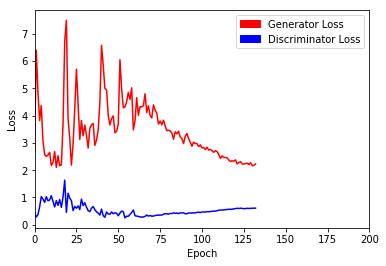

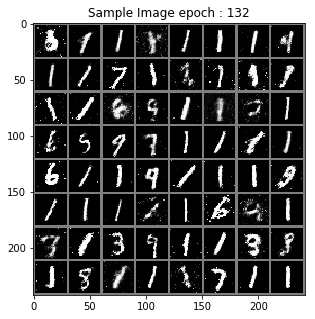

> Epoch : 134 Batch : 19 / 235 Loss_D : 0.5974347591400146 Loss_G : 2.3971433639526367
> Epoch : 134 Batch : 39 / 235 Loss_D : 0.6040536165237427 Loss_G : 1.9735331535339355
> Epoch : 134 Batch : 59 / 235 Loss_D : 0.7034221887588501 Loss_G : 1.9201459884643555
> Epoch : 134 Batch : 79 / 235 Loss_D : 0.6636050939559937 Loss_G : 1.8173713684082031
> Epoch : 134 Batch : 99 / 235 Loss_D : 0.6052356362342834 Loss_G : 2.1158323287963867
> Epoch : 134 Batch : 119 / 235 Loss_D : 0.6638875603675842 Loss_G : 2.0438570976257324
> Epoch : 134 Batch : 139 / 235 Loss_D : 0.7076471447944641 Loss_G : 1.9570119380950928
> Epoch : 134 Batch : 159 / 235 Loss_D : 0.6211984753608704 Loss_G : 2.123617649078369
> Epoch : 134 Batch : 179 / 235 Loss_D : 0.5094622373580933 Loss_G : 2.392545223236084
> Epoch : 134 Batch : 199 / 235 Loss_D : 0.566236138343811 Loss_G : 2.8175575733184814
> Epoch : 134 Batch : 219 / 235 Loss_D : 0.5959131121635437 Loss_G : 2.16866135597229


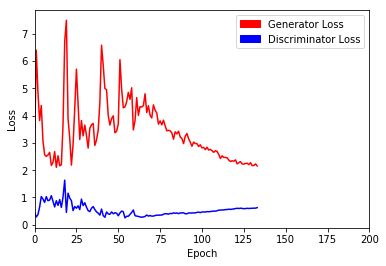

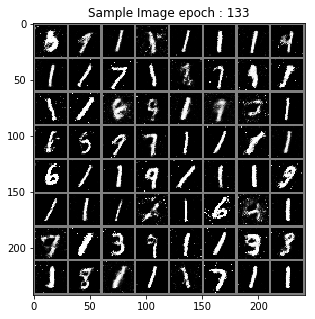

> Epoch : 135 Batch : 19 / 235 Loss_D : 0.695500373840332 Loss_G : 2.271756410598755
> Epoch : 135 Batch : 39 / 235 Loss_D : 0.618160605430603 Loss_G : 2.1274948120117188
> Epoch : 135 Batch : 59 / 235 Loss_D : 0.5671274662017822 Loss_G : 1.8189042806625366
> Epoch : 135 Batch : 79 / 235 Loss_D : 0.5700417757034302 Loss_G : 2.1850905418395996
> Epoch : 135 Batch : 99 / 235 Loss_D : 0.6447223424911499 Loss_G : 2.6412816047668457
> Epoch : 135 Batch : 119 / 235 Loss_D : 0.6905157566070557 Loss_G : 2.3962764739990234
> Epoch : 135 Batch : 139 / 235 Loss_D : 0.5899802446365356 Loss_G : 2.070981025695801
> Epoch : 135 Batch : 159 / 235 Loss_D : 0.7637059688568115 Loss_G : 2.4784436225891113
> Epoch : 135 Batch : 179 / 235 Loss_D : 0.57146817445755 Loss_G : 2.585848331451416
> Epoch : 135 Batch : 199 / 235 Loss_D : 0.6786099672317505 Loss_G : 1.9354197978973389
> Epoch : 135 Batch : 219 / 235 Loss_D : 0.6659787893295288 Loss_G : 2.063746452331543


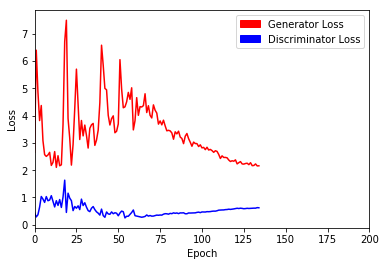

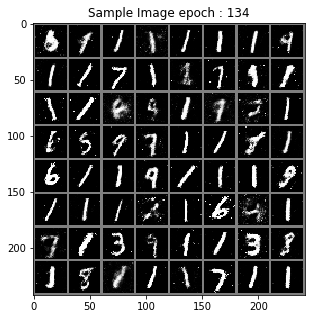

> Epoch : 136 Batch : 19 / 235 Loss_D : 0.6783362627029419 Loss_G : 1.9454209804534912
> Epoch : 136 Batch : 39 / 235 Loss_D : 0.6180844306945801 Loss_G : 2.2883360385894775
> Epoch : 136 Batch : 59 / 235 Loss_D : 0.6060165166854858 Loss_G : 2.002980947494507
> Epoch : 136 Batch : 79 / 235 Loss_D : 0.6774090528488159 Loss_G : 1.8606688976287842
> Epoch : 136 Batch : 99 / 235 Loss_D : 0.6853299140930176 Loss_G : 2.1737747192382812
> Epoch : 136 Batch : 119 / 235 Loss_D : 0.8018621802330017 Loss_G : 2.3204293251037598
> Epoch : 136 Batch : 139 / 235 Loss_D : 0.5721100568771362 Loss_G : 2.4240503311157227
> Epoch : 136 Batch : 159 / 235 Loss_D : 0.7129957675933838 Loss_G : 2.0428130626678467
> Epoch : 136 Batch : 179 / 235 Loss_D : 0.5754476189613342 Loss_G : 2.356997489929199
> Epoch : 136 Batch : 199 / 235 Loss_D : 0.6608659029006958 Loss_G : 2.293814182281494
> Epoch : 136 Batch : 219 / 235 Loss_D : 0.5654317140579224 Loss_G : 2.4025607109069824


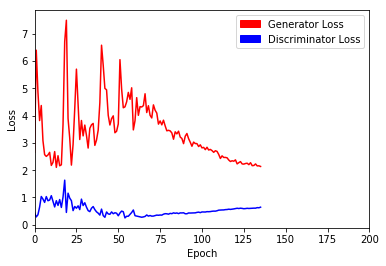

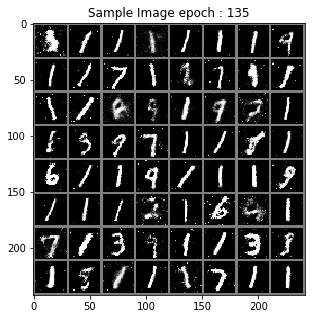

> Epoch : 137 Batch : 19 / 235 Loss_D : 0.6251322031021118 Loss_G : 1.7333226203918457
> Epoch : 137 Batch : 39 / 235 Loss_D : 0.6538957357406616 Loss_G : 2.06606388092041
> Epoch : 137 Batch : 59 / 235 Loss_D : 0.7148958444595337 Loss_G : 1.8716603517532349
> Epoch : 137 Batch : 79 / 235 Loss_D : 0.6282150149345398 Loss_G : 1.8102169036865234
> Epoch : 137 Batch : 99 / 235 Loss_D : 0.5547096729278564 Loss_G : 2.010770797729492
> Epoch : 137 Batch : 119 / 235 Loss_D : 0.6257410049438477 Loss_G : 2.065913677215576
> Epoch : 137 Batch : 139 / 235 Loss_D : 0.6804242134094238 Loss_G : 1.859635353088379
> Epoch : 137 Batch : 159 / 235 Loss_D : 0.6846454739570618 Loss_G : 2.072567939758301
> Epoch : 137 Batch : 179 / 235 Loss_D : 0.6326534152030945 Loss_G : 2.3111395835876465
> Epoch : 137 Batch : 199 / 235 Loss_D : 0.7324589490890503 Loss_G : 1.7315843105316162
> Epoch : 137 Batch : 219 / 235 Loss_D : 0.6132932901382446 Loss_G : 2.184878349304199


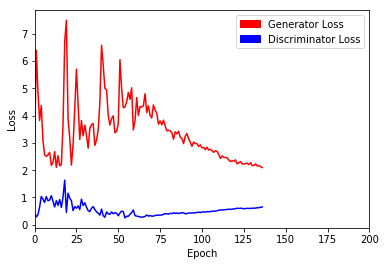

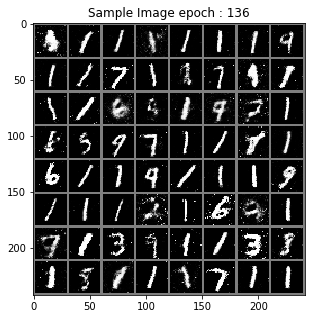

> Epoch : 138 Batch : 19 / 235 Loss_D : 0.5915010571479797 Loss_G : 2.1675658226013184
> Epoch : 138 Batch : 39 / 235 Loss_D : 0.6128059029579163 Loss_G : 1.9091533422470093
> Epoch : 138 Batch : 59 / 235 Loss_D : 0.6127743721008301 Loss_G : 2.1001858711242676
> Epoch : 138 Batch : 79 / 235 Loss_D : 0.7655239701271057 Loss_G : 1.9763529300689697
> Epoch : 138 Batch : 99 / 235 Loss_D : 0.6375243663787842 Loss_G : 1.9339020252227783
> Epoch : 138 Batch : 119 / 235 Loss_D : 0.6218641996383667 Loss_G : 1.9164702892303467
> Epoch : 138 Batch : 139 / 235 Loss_D : 0.5549358129501343 Loss_G : 2.3539962768554688
> Epoch : 138 Batch : 159 / 235 Loss_D : 0.4957408905029297 Loss_G : 2.5247280597686768
> Epoch : 138 Batch : 179 / 235 Loss_D : 0.7378045320510864 Loss_G : 2.4092319011688232
> Epoch : 138 Batch : 199 / 235 Loss_D : 0.6705940961837769 Loss_G : 2.178900718688965
> Epoch : 138 Batch : 219 / 235 Loss_D : 0.6085543036460876 Loss_G : 2.0443098545074463


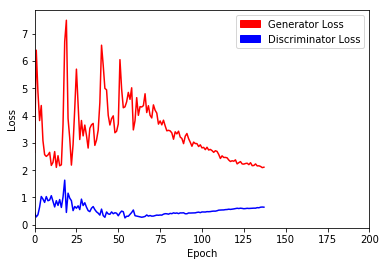

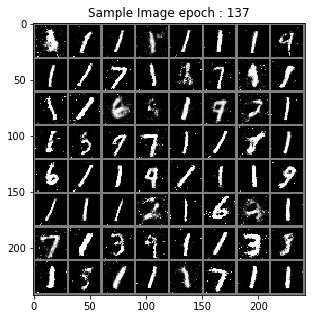

> Epoch : 139 Batch : 19 / 235 Loss_D : 0.633122444152832 Loss_G : 1.8516886234283447
> Epoch : 139 Batch : 39 / 235 Loss_D : 0.6605478525161743 Loss_G : 1.980843186378479
> Epoch : 139 Batch : 59 / 235 Loss_D : 0.6923123598098755 Loss_G : 1.8533223867416382
> Epoch : 139 Batch : 79 / 235 Loss_D : 0.5867253541946411 Loss_G : 1.8109232187271118
> Epoch : 139 Batch : 99 / 235 Loss_D : 0.6978330612182617 Loss_G : 2.318798065185547
> Epoch : 139 Batch : 119 / 235 Loss_D : 0.5784896016120911 Loss_G : 1.9309420585632324
> Epoch : 139 Batch : 139 / 235 Loss_D : 0.6755825281143188 Loss_G : 2.0371994972229004
> Epoch : 139 Batch : 159 / 235 Loss_D : 0.6505751609802246 Loss_G : 2.057075023651123
> Epoch : 139 Batch : 179 / 235 Loss_D : 0.64415043592453 Loss_G : 2.4554150104522705
> Epoch : 139 Batch : 199 / 235 Loss_D : 0.7226907014846802 Loss_G : 1.854438304901123
> Epoch : 139 Batch : 219 / 235 Loss_D : 0.6824069023132324 Loss_G : 2.223538637161255


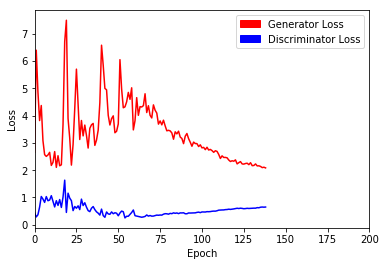

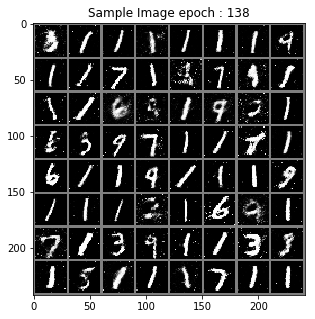

> Epoch : 140 Batch : 19 / 235 Loss_D : 0.584735095500946 Loss_G : 2.3508529663085938
> Epoch : 140 Batch : 39 / 235 Loss_D : 0.6708638668060303 Loss_G : 2.1021344661712646
> Epoch : 140 Batch : 59 / 235 Loss_D : 0.6427782773971558 Loss_G : 2.270883560180664
> Epoch : 140 Batch : 79 / 235 Loss_D : 0.6660125255584717 Loss_G : 2.0753767490386963
> Epoch : 140 Batch : 99 / 235 Loss_D : 0.6510416269302368 Loss_G : 2.171811580657959
> Epoch : 140 Batch : 119 / 235 Loss_D : 0.641003429889679 Loss_G : 1.641042709350586
> Epoch : 140 Batch : 139 / 235 Loss_D : 0.8192432522773743 Loss_G : 1.736424207687378
> Epoch : 140 Batch : 159 / 235 Loss_D : 0.6050313711166382 Loss_G : 2.177398204803467
> Epoch : 140 Batch : 179 / 235 Loss_D : 0.8624916672706604 Loss_G : 1.807803750038147
> Epoch : 140 Batch : 199 / 235 Loss_D : 0.6575891375541687 Loss_G : 2.0009989738464355
> Epoch : 140 Batch : 219 / 235 Loss_D : 0.6037353277206421 Loss_G : 1.8593602180480957


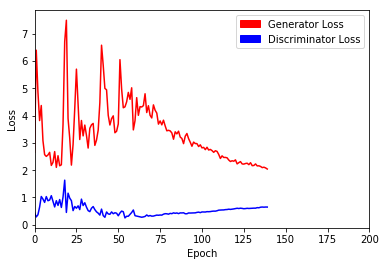

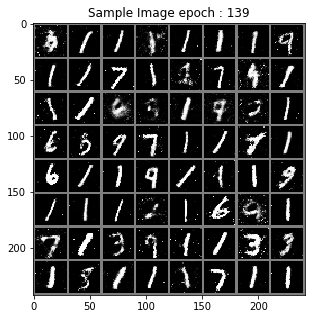

> Epoch : 141 Batch : 19 / 235 Loss_D : 0.8089861869812012 Loss_G : 1.8879952430725098
> Epoch : 141 Batch : 39 / 235 Loss_D : 0.6358250379562378 Loss_G : 2.045734405517578
> Epoch : 141 Batch : 59 / 235 Loss_D : 0.5864638686180115 Loss_G : 2.0012292861938477
> Epoch : 141 Batch : 79 / 235 Loss_D : 0.7001450061798096 Loss_G : 1.976755142211914
> Epoch : 141 Batch : 99 / 235 Loss_D : 0.4872291684150696 Loss_G : 2.318934679031372
> Epoch : 141 Batch : 119 / 235 Loss_D : 0.6715334057807922 Loss_G : 1.7312602996826172
> Epoch : 141 Batch : 139 / 235 Loss_D : 0.6615025997161865 Loss_G : 1.788588523864746
> Epoch : 141 Batch : 159 / 235 Loss_D : 0.6096762418746948 Loss_G : 1.9468730688095093
> Epoch : 141 Batch : 179 / 235 Loss_D : 0.7302740216255188 Loss_G : 1.8116554021835327
> Epoch : 141 Batch : 199 / 235 Loss_D : 0.5613099336624146 Loss_G : 2.1418168544769287
> Epoch : 141 Batch : 219 / 235 Loss_D : 0.6843987703323364 Loss_G : 1.8663356304168701


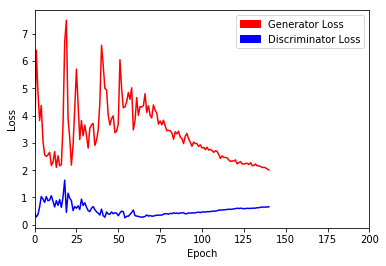

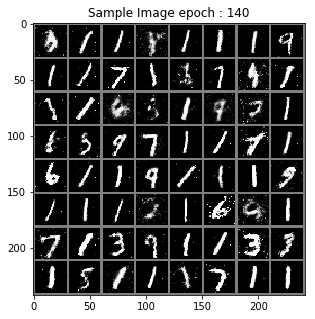

> Epoch : 142 Batch : 19 / 235 Loss_D : 0.619046688079834 Loss_G : 2.176098346710205
> Epoch : 142 Batch : 39 / 235 Loss_D : 0.6664832830429077 Loss_G : 2.31461238861084
> Epoch : 142 Batch : 59 / 235 Loss_D : 0.7913385033607483 Loss_G : 1.9549942016601562
> Epoch : 142 Batch : 79 / 235 Loss_D : 0.74443519115448 Loss_G : 1.7720081806182861
> Epoch : 142 Batch : 99 / 235 Loss_D : 0.7582055926322937 Loss_G : 1.7935783863067627
> Epoch : 142 Batch : 119 / 235 Loss_D : 0.6072770953178406 Loss_G : 2.147724151611328
> Epoch : 142 Batch : 139 / 235 Loss_D : 0.6317043304443359 Loss_G : 1.9776594638824463
> Epoch : 142 Batch : 159 / 235 Loss_D : 0.5291752219200134 Loss_G : 1.8840535879135132
> Epoch : 142 Batch : 179 / 235 Loss_D : 0.6807874441146851 Loss_G : 1.9121246337890625
> Epoch : 142 Batch : 199 / 235 Loss_D : 0.7444080710411072 Loss_G : 1.7315564155578613
> Epoch : 142 Batch : 219 / 235 Loss_D : 0.7086180448532104 Loss_G : 2.3676586151123047


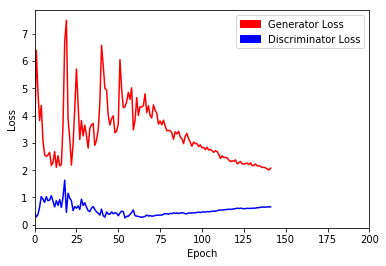

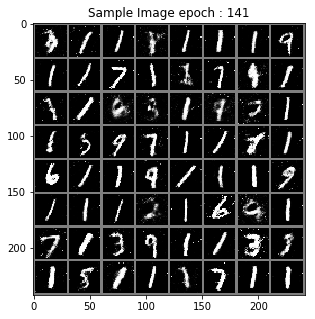

> Epoch : 143 Batch : 19 / 235 Loss_D : 0.6711248159408569 Loss_G : 2.2162933349609375
> Epoch : 143 Batch : 39 / 235 Loss_D : 0.6984361410140991 Loss_G : 1.9136359691619873
> Epoch : 143 Batch : 59 / 235 Loss_D : 0.5600559115409851 Loss_G : 2.5836117267608643
> Epoch : 143 Batch : 79 / 235 Loss_D : 0.7606047987937927 Loss_G : 1.7958661317825317
> Epoch : 143 Batch : 99 / 235 Loss_D : 0.5882209539413452 Loss_G : 2.0281481742858887
> Epoch : 143 Batch : 119 / 235 Loss_D : 0.6304258108139038 Loss_G : 2.628966808319092
> Epoch : 143 Batch : 139 / 235 Loss_D : 0.6458061337471008 Loss_G : 2.1319282054901123
> Epoch : 143 Batch : 159 / 235 Loss_D : 0.6389327049255371 Loss_G : 1.9359163045883179
> Epoch : 143 Batch : 179 / 235 Loss_D : 0.7667417526245117 Loss_G : 1.7233909368515015
> Epoch : 143 Batch : 199 / 235 Loss_D : 0.7210289239883423 Loss_G : 1.8270823955535889
> Epoch : 143 Batch : 219 / 235 Loss_D : 0.6163459420204163 Loss_G : 2.077583074569702


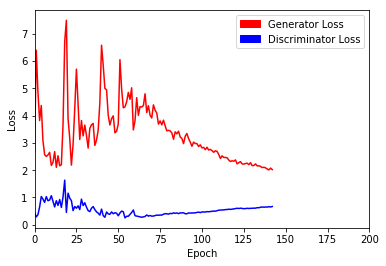

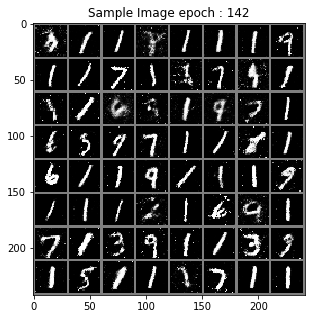

> Epoch : 144 Batch : 19 / 235 Loss_D : 0.6449072360992432 Loss_G : 1.8439937829971313
> Epoch : 144 Batch : 39 / 235 Loss_D : 0.6806769371032715 Loss_G : 1.8315653800964355
> Epoch : 144 Batch : 59 / 235 Loss_D : 0.6724370718002319 Loss_G : 2.023723602294922
> Epoch : 144 Batch : 79 / 235 Loss_D : 0.6561129093170166 Loss_G : 2.2334768772125244
> Epoch : 144 Batch : 99 / 235 Loss_D : 0.7347046136856079 Loss_G : 1.8912848234176636
> Epoch : 144 Batch : 119 / 235 Loss_D : 0.61887127161026 Loss_G : 1.8734028339385986
> Epoch : 144 Batch : 139 / 235 Loss_D : 0.7145174145698547 Loss_G : 2.053490161895752
> Epoch : 144 Batch : 159 / 235 Loss_D : 0.5545903444290161 Loss_G : 2.104492664337158
> Epoch : 144 Batch : 179 / 235 Loss_D : 0.6915887594223022 Loss_G : 2.021371603012085
> Epoch : 144 Batch : 199 / 235 Loss_D : 0.662354588508606 Loss_G : 2.103283405303955
> Epoch : 144 Batch : 219 / 235 Loss_D : 0.602148175239563 Loss_G : 2.1594929695129395


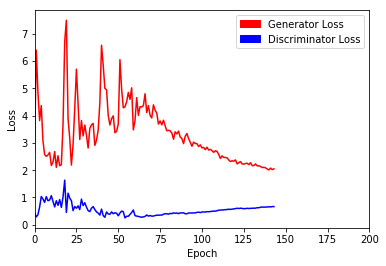

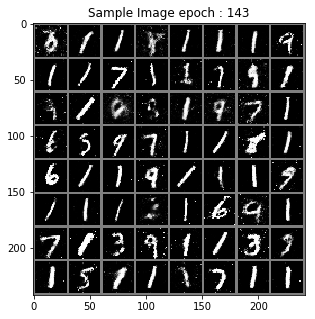

> Epoch : 145 Batch : 19 / 235 Loss_D : 0.7304111123085022 Loss_G : 1.8302907943725586
> Epoch : 145 Batch : 39 / 235 Loss_D : 0.6565307974815369 Loss_G : 1.7777390480041504
> Epoch : 145 Batch : 59 / 235 Loss_D : 0.5416411757469177 Loss_G : 2.490757942199707
> Epoch : 145 Batch : 79 / 235 Loss_D : 0.7343313694000244 Loss_G : 1.9190027713775635
> Epoch : 145 Batch : 99 / 235 Loss_D : 0.5800154805183411 Loss_G : 1.9716044664382935
> Epoch : 145 Batch : 119 / 235 Loss_D : 0.7230292558670044 Loss_G : 2.0407333374023438
> Epoch : 145 Batch : 139 / 235 Loss_D : 0.5840027332305908 Loss_G : 2.264784812927246
> Epoch : 145 Batch : 159 / 235 Loss_D : 0.7019264698028564 Loss_G : 1.9960827827453613
> Epoch : 145 Batch : 179 / 235 Loss_D : 0.6420952081680298 Loss_G : 1.9471782445907593
> Epoch : 145 Batch : 199 / 235 Loss_D : 0.6766394376754761 Loss_G : 1.805246353149414
> Epoch : 145 Batch : 219 / 235 Loss_D : 0.6712611317634583 Loss_G : 1.8913787603378296


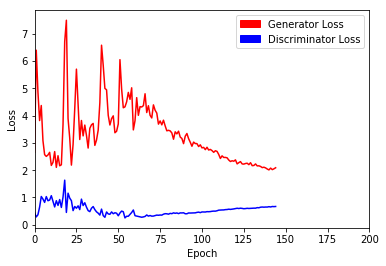

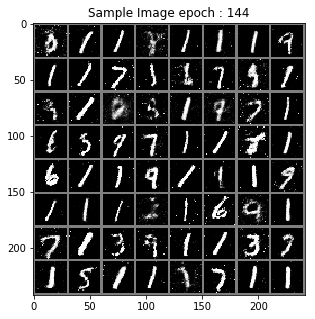

> Epoch : 146 Batch : 19 / 235 Loss_D : 0.6267792582511902 Loss_G : 2.081347942352295
> Epoch : 146 Batch : 39 / 235 Loss_D : 0.578519344329834 Loss_G : 2.148134231567383
> Epoch : 146 Batch : 59 / 235 Loss_D : 0.6041487455368042 Loss_G : 2.1326403617858887
> Epoch : 146 Batch : 79 / 235 Loss_D : 0.7242342829704285 Loss_G : 2.094089984893799
> Epoch : 146 Batch : 99 / 235 Loss_D : 0.7490831613540649 Loss_G : 2.4210102558135986
> Epoch : 146 Batch : 119 / 235 Loss_D : 0.6551433801651001 Loss_G : 2.1851391792297363
> Epoch : 146 Batch : 139 / 235 Loss_D : 0.6131117343902588 Loss_G : 1.9987542629241943
> Epoch : 146 Batch : 159 / 235 Loss_D : 0.7671843767166138 Loss_G : 2.4245572090148926
> Epoch : 146 Batch : 179 / 235 Loss_D : 0.8011599779129028 Loss_G : 2.0458154678344727
> Epoch : 146 Batch : 199 / 235 Loss_D : 0.5938501358032227 Loss_G : 2.3810980319976807
> Epoch : 146 Batch : 219 / 235 Loss_D : 0.7428556680679321 Loss_G : 1.9977760314941406


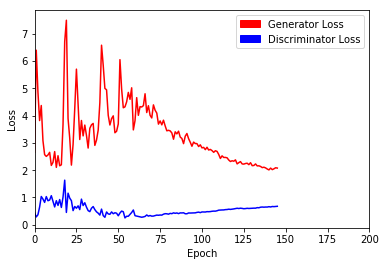

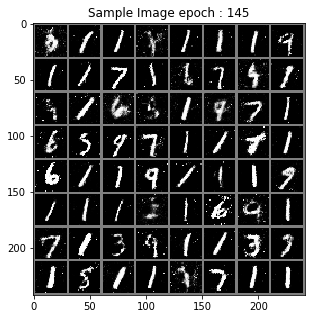

> Epoch : 147 Batch : 19 / 235 Loss_D : 0.5866876840591431 Loss_G : 2.0870866775512695
> Epoch : 147 Batch : 39 / 235 Loss_D : 0.7654411792755127 Loss_G : 2.101252794265747
> Epoch : 147 Batch : 59 / 235 Loss_D : 0.6193570494651794 Loss_G : 2.0398497581481934
> Epoch : 147 Batch : 79 / 235 Loss_D : 0.7896095514297485 Loss_G : 1.7346928119659424
> Epoch : 147 Batch : 99 / 235 Loss_D : 0.7246423959732056 Loss_G : 2.03762149810791
> Epoch : 147 Batch : 119 / 235 Loss_D : 0.6597739458084106 Loss_G : 2.059857130050659
> Epoch : 147 Batch : 139 / 235 Loss_D : 0.5463788509368896 Loss_G : 2.316408634185791
> Epoch : 147 Batch : 159 / 235 Loss_D : 0.6887856721878052 Loss_G : 1.7896144390106201
> Epoch : 147 Batch : 179 / 235 Loss_D : 0.617738664150238 Loss_G : 2.0407276153564453
> Epoch : 147 Batch : 199 / 235 Loss_D : 0.6782772541046143 Loss_G : 2.261293888092041
> Epoch : 147 Batch : 219 / 235 Loss_D : 0.7378275394439697 Loss_G : 1.8053264617919922


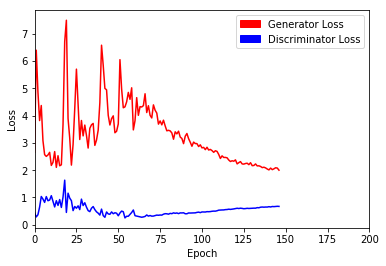

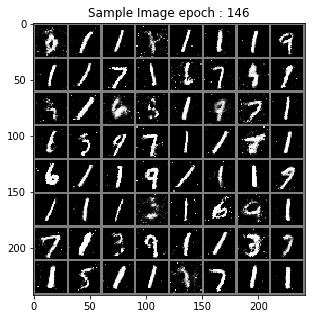

> Epoch : 148 Batch : 19 / 235 Loss_D : 0.7425215244293213 Loss_G : 2.0834922790527344
> Epoch : 148 Batch : 39 / 235 Loss_D : 0.6204454302787781 Loss_G : 2.1620664596557617
> Epoch : 148 Batch : 59 / 235 Loss_D : 0.7062370777130127 Loss_G : 1.7681734561920166
> Epoch : 148 Batch : 79 / 235 Loss_D : 0.6072821021080017 Loss_G : 1.9074780941009521
> Epoch : 148 Batch : 99 / 235 Loss_D : 0.6355890035629272 Loss_G : 1.710974931716919
> Epoch : 148 Batch : 119 / 235 Loss_D : 0.6023167371749878 Loss_G : 2.1260080337524414
> Epoch : 148 Batch : 139 / 235 Loss_D : 0.7024465799331665 Loss_G : 2.0603020191192627
> Epoch : 148 Batch : 159 / 235 Loss_D : 0.6508458256721497 Loss_G : 2.084850311279297
> Epoch : 148 Batch : 179 / 235 Loss_D : 0.6258456110954285 Loss_G : 1.7572002410888672
> Epoch : 148 Batch : 199 / 235 Loss_D : 0.679667055606842 Loss_G : 2.1453518867492676
> Epoch : 148 Batch : 219 / 235 Loss_D : 0.6146658658981323 Loss_G : 2.0321009159088135


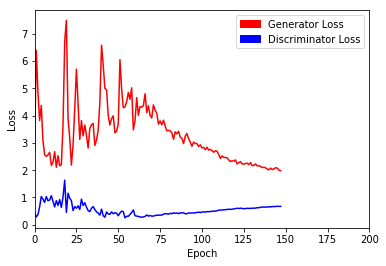

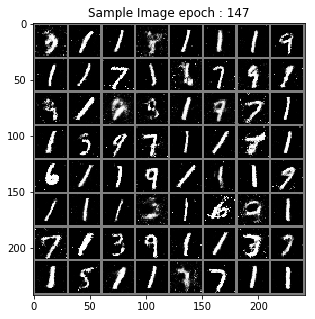

> Epoch : 149 Batch : 19 / 235 Loss_D : 0.655951976776123 Loss_G : 2.2758893966674805
> Epoch : 149 Batch : 39 / 235 Loss_D : 0.7283266186714172 Loss_G : 1.8209340572357178
> Epoch : 149 Batch : 59 / 235 Loss_D : 0.5538634061813354 Loss_G : 2.027660608291626
> Epoch : 149 Batch : 79 / 235 Loss_D : 0.7067642211914062 Loss_G : 1.956058144569397
> Epoch : 149 Batch : 99 / 235 Loss_D : 0.6752532124519348 Loss_G : 1.8721301555633545
> Epoch : 149 Batch : 119 / 235 Loss_D : 0.6400247812271118 Loss_G : 2.141507625579834
> Epoch : 149 Batch : 139 / 235 Loss_D : 0.6094726324081421 Loss_G : 1.7768551111221313
> Epoch : 149 Batch : 159 / 235 Loss_D : 0.6164876222610474 Loss_G : 2.035069704055786
> Epoch : 149 Batch : 179 / 235 Loss_D : 0.7050652503967285 Loss_G : 2.0508289337158203
> Epoch : 149 Batch : 199 / 235 Loss_D : 0.7053585052490234 Loss_G : 1.8520867824554443
> Epoch : 149 Batch : 219 / 235 Loss_D : 0.6991404294967651 Loss_G : 1.8642189502716064


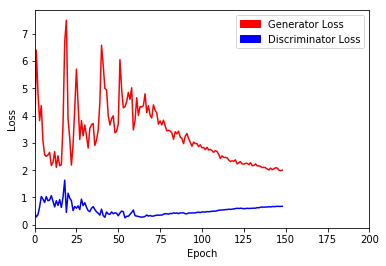

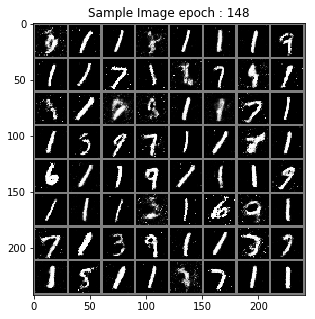

> Epoch : 150 Batch : 19 / 235 Loss_D : 0.6574763059616089 Loss_G : 2.0273244380950928
> Epoch : 150 Batch : 39 / 235 Loss_D : 0.795979380607605 Loss_G : 2.161315679550171
> Epoch : 150 Batch : 59 / 235 Loss_D : 0.6636868715286255 Loss_G : 2.1446690559387207
> Epoch : 150 Batch : 79 / 235 Loss_D : 0.699103057384491 Loss_G : 2.626267433166504
> Epoch : 150 Batch : 99 / 235 Loss_D : 0.6026780605316162 Loss_G : 1.815524697303772
> Epoch : 150 Batch : 119 / 235 Loss_D : 0.5745801329612732 Loss_G : 1.983044981956482
> Epoch : 150 Batch : 139 / 235 Loss_D : 0.7279922962188721 Loss_G : 1.5601084232330322
> Epoch : 150 Batch : 159 / 235 Loss_D : 0.7122297286987305 Loss_G : 1.9558696746826172
> Epoch : 150 Batch : 179 / 235 Loss_D : 0.5787475109100342 Loss_G : 2.1206021308898926
> Epoch : 150 Batch : 199 / 235 Loss_D : 0.7692215442657471 Loss_G : 1.8457168340682983
> Epoch : 150 Batch : 219 / 235 Loss_D : 0.6987178325653076 Loss_G : 1.9795137643814087


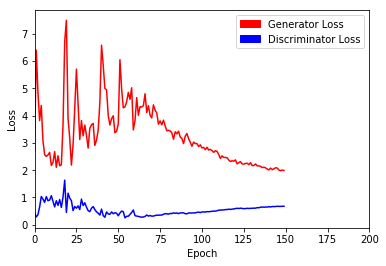

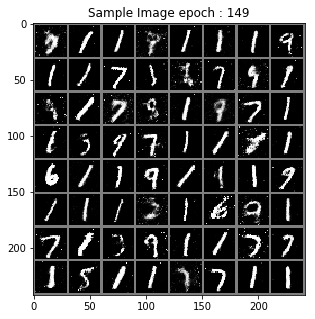

> Epoch : 151 Batch : 19 / 235 Loss_D : 0.6781688928604126 Loss_G : 1.8704447746276855
> Epoch : 151 Batch : 39 / 235 Loss_D : 0.7411649227142334 Loss_G : 1.8860751390457153
> Epoch : 151 Batch : 59 / 235 Loss_D : 0.615920901298523 Loss_G : 2.174088478088379
> Epoch : 151 Batch : 79 / 235 Loss_D : 0.6451694965362549 Loss_G : 1.9955509901046753
> Epoch : 151 Batch : 99 / 235 Loss_D : 0.7098195552825928 Loss_G : 1.9370989799499512
> Epoch : 151 Batch : 119 / 235 Loss_D : 0.7009409666061401 Loss_G : 1.8306128978729248
> Epoch : 151 Batch : 139 / 235 Loss_D : 0.6803959608078003 Loss_G : 2.107844114303589
> Epoch : 151 Batch : 159 / 235 Loss_D : 0.6630260944366455 Loss_G : 1.9347622394561768
> Epoch : 151 Batch : 179 / 235 Loss_D : 0.5714409351348877 Loss_G : 1.881941318511963
> Epoch : 151 Batch : 199 / 235 Loss_D : 0.73516845703125 Loss_G : 2.35640811920166
> Epoch : 151 Batch : 219 / 235 Loss_D : 0.6770693063735962 Loss_G : 1.8820247650146484


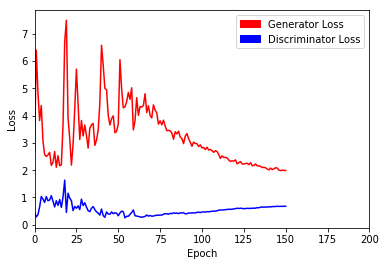

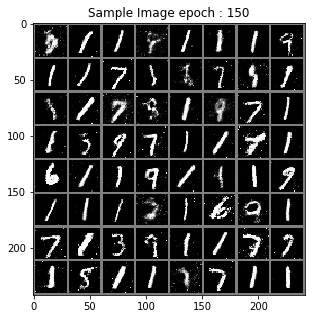

> Epoch : 152 Batch : 19 / 235 Loss_D : 0.8139287233352661 Loss_G : 1.9163490533828735
> Epoch : 152 Batch : 39 / 235 Loss_D : 0.7510590553283691 Loss_G : 2.2286243438720703
> Epoch : 152 Batch : 59 / 235 Loss_D : 0.6370375156402588 Loss_G : 1.9662435054779053
> Epoch : 152 Batch : 79 / 235 Loss_D : 0.6491475105285645 Loss_G : 2.151491403579712
> Epoch : 152 Batch : 99 / 235 Loss_D : 0.6362959146499634 Loss_G : 2.4317307472229004
> Epoch : 152 Batch : 119 / 235 Loss_D : 0.7059071660041809 Loss_G : 1.7853819131851196
> Epoch : 152 Batch : 139 / 235 Loss_D : 0.6421716213226318 Loss_G : 2.3497095108032227
> Epoch : 152 Batch : 159 / 235 Loss_D : 0.5860922932624817 Loss_G : 2.241727590560913
> Epoch : 152 Batch : 179 / 235 Loss_D : 0.7118455767631531 Loss_G : 2.0021214485168457
> Epoch : 152 Batch : 199 / 235 Loss_D : 0.7079869508743286 Loss_G : 2.040083408355713
> Epoch : 152 Batch : 219 / 235 Loss_D : 0.6715548634529114 Loss_G : 2.0863399505615234


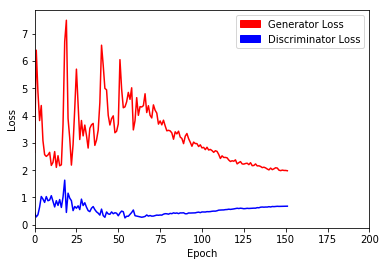

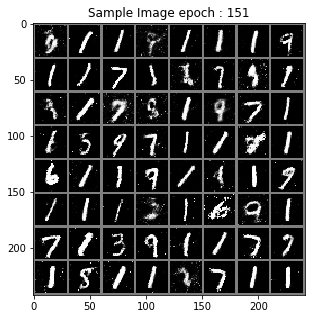

> Epoch : 153 Batch : 19 / 235 Loss_D : 0.717746913433075 Loss_G : 1.8027069568634033
> Epoch : 153 Batch : 39 / 235 Loss_D : 0.6592251062393188 Loss_G : 1.578904151916504
> Epoch : 153 Batch : 59 / 235 Loss_D : 0.6787405014038086 Loss_G : 2.0373435020446777
> Epoch : 153 Batch : 79 / 235 Loss_D : 0.6872018575668335 Loss_G : 1.843897819519043
> Epoch : 153 Batch : 99 / 235 Loss_D : 0.6139833927154541 Loss_G : 1.9715683460235596
> Epoch : 153 Batch : 119 / 235 Loss_D : 0.6654065847396851 Loss_G : 2.0854411125183105
> Epoch : 153 Batch : 139 / 235 Loss_D : 0.7065043449401855 Loss_G : 1.8459649085998535
> Epoch : 153 Batch : 159 / 235 Loss_D : 0.676064133644104 Loss_G : 2.0530664920806885
> Epoch : 153 Batch : 179 / 235 Loss_D : 0.6723434925079346 Loss_G : 2.0504231452941895
> Epoch : 153 Batch : 199 / 235 Loss_D : 0.782525897026062 Loss_G : 1.8632231950759888
> Epoch : 153 Batch : 219 / 235 Loss_D : 0.7068191170692444 Loss_G : 2.150742530822754


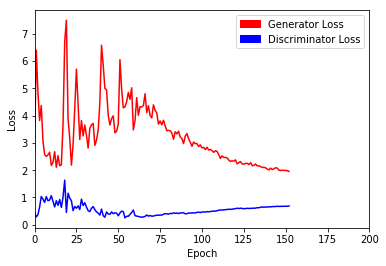

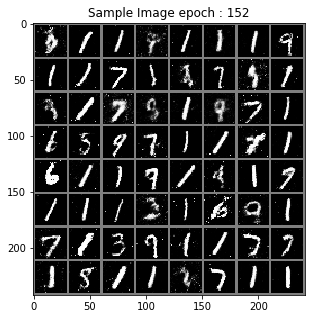

> Epoch : 154 Batch : 19 / 235 Loss_D : 0.6542155146598816 Loss_G : 2.0662012100219727
> Epoch : 154 Batch : 39 / 235 Loss_D : 0.7208424806594849 Loss_G : 2.0583713054656982
> Epoch : 154 Batch : 59 / 235 Loss_D : 0.6674588918685913 Loss_G : 2.007873296737671
> Epoch : 154 Batch : 79 / 235 Loss_D : 0.7060415148735046 Loss_G : 2.149536609649658
> Epoch : 154 Batch : 99 / 235 Loss_D : 0.8047820329666138 Loss_G : 1.7389048337936401
> Epoch : 154 Batch : 119 / 235 Loss_D : 0.6925076842308044 Loss_G : 1.850576400756836
> Epoch : 154 Batch : 139 / 235 Loss_D : 0.6913053393363953 Loss_G : 1.7367241382598877
> Epoch : 154 Batch : 159 / 235 Loss_D : 0.687965989112854 Loss_G : 1.869368314743042
> Epoch : 154 Batch : 179 / 235 Loss_D : 0.7116793394088745 Loss_G : 1.7403903007507324
> Epoch : 154 Batch : 199 / 235 Loss_D : 0.7043416500091553 Loss_G : 1.81632399559021
> Epoch : 154 Batch : 219 / 235 Loss_D : 0.6351351141929626 Loss_G : 2.0446248054504395


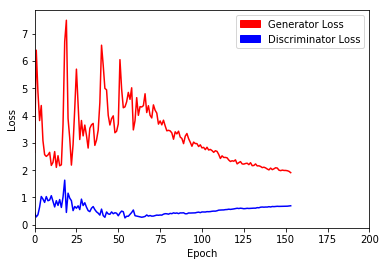

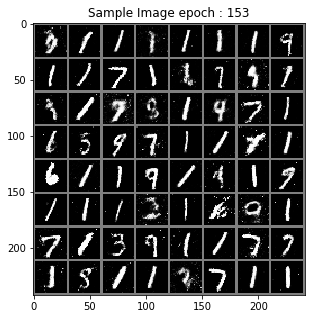

> Epoch : 155 Batch : 19 / 235 Loss_D : 0.6716907024383545 Loss_G : 1.808241367340088
> Epoch : 155 Batch : 39 / 235 Loss_D : 0.6497447490692139 Loss_G : 1.8685070276260376
> Epoch : 155 Batch : 59 / 235 Loss_D : 0.614259660243988 Loss_G : 1.9479490518569946
> Epoch : 155 Batch : 79 / 235 Loss_D : 0.6007508635520935 Loss_G : 1.981386661529541
> Epoch : 155 Batch : 99 / 235 Loss_D : 0.6846731901168823 Loss_G : 1.602739930152893
> Epoch : 155 Batch : 119 / 235 Loss_D : 0.7167622447013855 Loss_G : 1.9642289876937866
> Epoch : 155 Batch : 139 / 235 Loss_D : 0.6264605522155762 Loss_G : 1.6631324291229248
> Epoch : 155 Batch : 159 / 235 Loss_D : 0.7945623397827148 Loss_G : 1.99016273021698
> Epoch : 155 Batch : 179 / 235 Loss_D : 0.7263163924217224 Loss_G : 1.8058065176010132
> Epoch : 155 Batch : 199 / 235 Loss_D : 0.7291098833084106 Loss_G : 1.9918451309204102
> Epoch : 155 Batch : 219 / 235 Loss_D : 0.6297124028205872 Loss_G : 1.7781074047088623


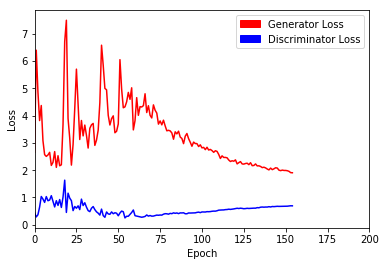

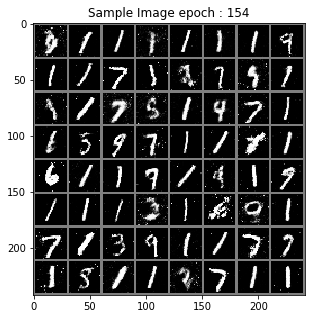

> Epoch : 156 Batch : 19 / 235 Loss_D : 0.7253652811050415 Loss_G : 1.9902783632278442
> Epoch : 156 Batch : 39 / 235 Loss_D : 0.6725175380706787 Loss_G : 1.910970687866211
> Epoch : 156 Batch : 59 / 235 Loss_D : 0.6585191488265991 Loss_G : 1.8605473041534424
> Epoch : 156 Batch : 79 / 235 Loss_D : 0.700811505317688 Loss_G : 2.047213315963745
> Epoch : 156 Batch : 99 / 235 Loss_D : 0.6941102743148804 Loss_G : 2.1525356769561768
> Epoch : 156 Batch : 119 / 235 Loss_D : 0.7060217261314392 Loss_G : 1.5638079643249512
> Epoch : 156 Batch : 139 / 235 Loss_D : 0.6720460653305054 Loss_G : 1.8983471393585205
> Epoch : 156 Batch : 159 / 235 Loss_D : 0.6854302883148193 Loss_G : 1.997290015220642
> Epoch : 156 Batch : 179 / 235 Loss_D : 0.64341801404953 Loss_G : 1.9044454097747803
> Epoch : 156 Batch : 199 / 235 Loss_D : 0.768588125705719 Loss_G : 1.7838654518127441
> Epoch : 156 Batch : 219 / 235 Loss_D : 0.6555904150009155 Loss_G : 1.821135401725769


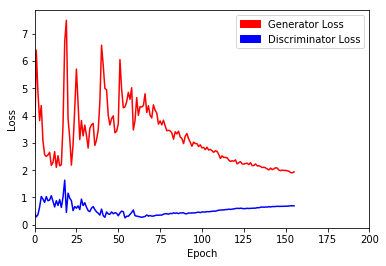

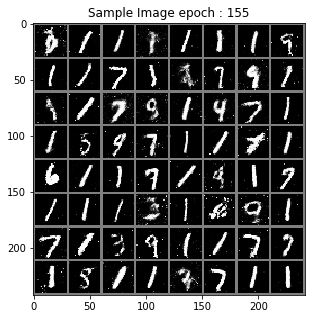

> Epoch : 157 Batch : 19 / 235 Loss_D : 0.7415883541107178 Loss_G : 1.8750643730163574
> Epoch : 157 Batch : 39 / 235 Loss_D : 0.6456446647644043 Loss_G : 2.1945762634277344
> Epoch : 157 Batch : 59 / 235 Loss_D : 0.6454989910125732 Loss_G : 2.1663818359375
> Epoch : 157 Batch : 79 / 235 Loss_D : 0.80059415102005 Loss_G : 2.0141139030456543
> Epoch : 157 Batch : 99 / 235 Loss_D : 0.7208110094070435 Loss_G : 2.1242237091064453
> Epoch : 157 Batch : 119 / 235 Loss_D : 0.6973575949668884 Loss_G : 1.665236234664917
> Epoch : 157 Batch : 139 / 235 Loss_D : 0.6067607402801514 Loss_G : 2.1155219078063965
> Epoch : 157 Batch : 159 / 235 Loss_D : 0.7314625978469849 Loss_G : 2.0553572177886963
> Epoch : 157 Batch : 179 / 235 Loss_D : 0.7559076547622681 Loss_G : 1.8903415203094482
> Epoch : 157 Batch : 199 / 235 Loss_D : 0.6286821961402893 Loss_G : 1.9350368976593018
> Epoch : 157 Batch : 219 / 235 Loss_D : 0.7141876220703125 Loss_G : 1.9590117931365967


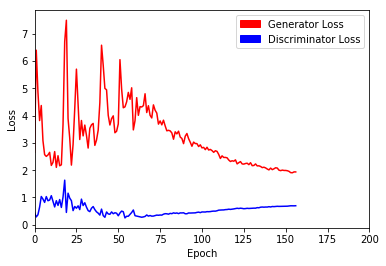

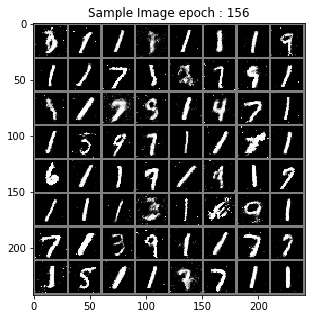

> Epoch : 158 Batch : 19 / 235 Loss_D : 0.68953937292099 Loss_G : 1.9518487453460693
> Epoch : 158 Batch : 39 / 235 Loss_D : 0.7418301701545715 Loss_G : 1.7141392230987549
> Epoch : 158 Batch : 59 / 235 Loss_D : 0.6424303650856018 Loss_G : 1.6081886291503906
> Epoch : 158 Batch : 79 / 235 Loss_D : 0.7459059357643127 Loss_G : 1.9410881996154785
> Epoch : 158 Batch : 99 / 235 Loss_D : 0.7017611265182495 Loss_G : 2.209402561187744
> Epoch : 158 Batch : 119 / 235 Loss_D : 0.8065011501312256 Loss_G : 2.057870388031006
> Epoch : 158 Batch : 139 / 235 Loss_D : 0.6932645440101624 Loss_G : 2.03749418258667
> Epoch : 158 Batch : 159 / 235 Loss_D : 0.7952212691307068 Loss_G : 2.0087904930114746
> Epoch : 158 Batch : 179 / 235 Loss_D : 0.7155713438987732 Loss_G : 1.617812991142273
> Epoch : 158 Batch : 199 / 235 Loss_D : 0.6793941259384155 Loss_G : 2.186349868774414
> Epoch : 158 Batch : 219 / 235 Loss_D : 0.6588877439498901 Loss_G : 1.9957866668701172


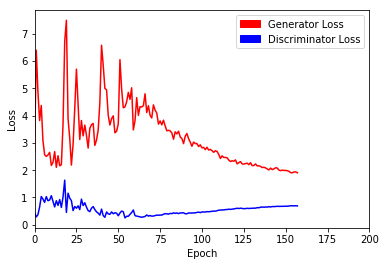

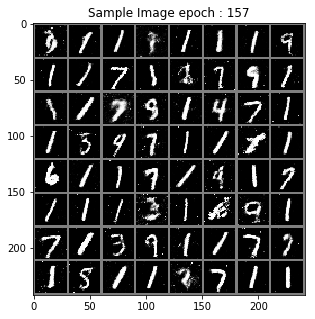

> Epoch : 159 Batch : 19 / 235 Loss_D : 0.6934282779693604 Loss_G : 1.9983162879943848
> Epoch : 159 Batch : 39 / 235 Loss_D : 0.6361700296401978 Loss_G : 2.1242191791534424
> Epoch : 159 Batch : 59 / 235 Loss_D : 0.6619521975517273 Loss_G : 1.8440837860107422
> Epoch : 159 Batch : 79 / 235 Loss_D : 0.7051715850830078 Loss_G : 1.873985767364502
> Epoch : 159 Batch : 99 / 235 Loss_D : 0.6875244379043579 Loss_G : 1.886773943901062
> Epoch : 159 Batch : 119 / 235 Loss_D : 0.758556604385376 Loss_G : 1.894167184829712
> Epoch : 159 Batch : 139 / 235 Loss_D : 0.7338108420372009 Loss_G : 2.073167562484741
> Epoch : 159 Batch : 159 / 235 Loss_D : 0.656644880771637 Loss_G : 1.886256217956543
> Epoch : 159 Batch : 179 / 235 Loss_D : 0.6482458114624023 Loss_G : 1.8618358373641968
> Epoch : 159 Batch : 199 / 235 Loss_D : 0.6174046993255615 Loss_G : 1.8653264045715332
> Epoch : 159 Batch : 219 / 235 Loss_D : 0.7983385324478149 Loss_G : 1.6762546300888062


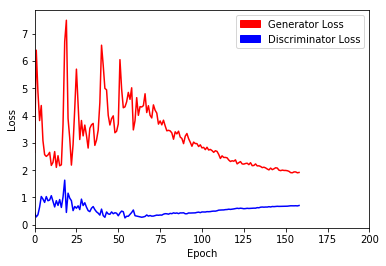

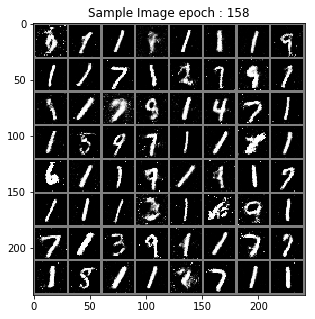

> Epoch : 160 Batch : 19 / 235 Loss_D : 0.6867724657058716 Loss_G : 2.0752811431884766
> Epoch : 160 Batch : 39 / 235 Loss_D : 0.842089056968689 Loss_G : 1.8131704330444336
> Epoch : 160 Batch : 59 / 235 Loss_D : 0.6203436851501465 Loss_G : 2.237990140914917
> Epoch : 160 Batch : 79 / 235 Loss_D : 0.749725341796875 Loss_G : 1.9181597232818604
> Epoch : 160 Batch : 99 / 235 Loss_D : 0.7164826393127441 Loss_G : 2.0405831336975098
> Epoch : 160 Batch : 119 / 235 Loss_D : 0.6477579474449158 Loss_G : 1.9895960092544556
> Epoch : 160 Batch : 139 / 235 Loss_D : 0.7147321701049805 Loss_G : 1.854802131652832
> Epoch : 160 Batch : 159 / 235 Loss_D : 0.6685875654220581 Loss_G : 1.8636959791183472
> Epoch : 160 Batch : 179 / 235 Loss_D : 0.7399290800094604 Loss_G : 2.0832371711730957
> Epoch : 160 Batch : 199 / 235 Loss_D : 0.668074369430542 Loss_G : 2.0980327129364014
> Epoch : 160 Batch : 219 / 235 Loss_D : 0.6322951316833496 Loss_G : 1.944010615348816


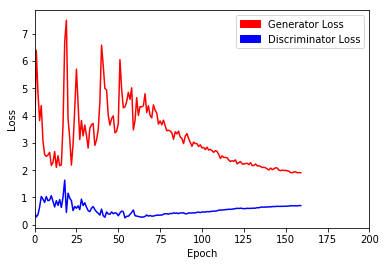

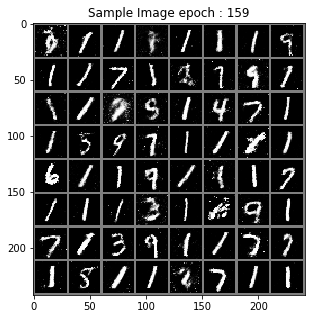

> Epoch : 161 Batch : 19 / 235 Loss_D : 0.723368763923645 Loss_G : 2.209044933319092
> Epoch : 161 Batch : 39 / 235 Loss_D : 0.815717339515686 Loss_G : 1.8623321056365967
> Epoch : 161 Batch : 59 / 235 Loss_D : 0.6820656061172485 Loss_G : 1.8470747470855713
> Epoch : 161 Batch : 79 / 235 Loss_D : 0.5532013177871704 Loss_G : 2.3304386138916016
> Epoch : 161 Batch : 99 / 235 Loss_D : 0.7149897813796997 Loss_G : 2.0614426136016846
> Epoch : 161 Batch : 119 / 235 Loss_D : 0.7702029347419739 Loss_G : 1.8207651376724243
> Epoch : 161 Batch : 139 / 235 Loss_D : 0.6788594722747803 Loss_G : 1.9986507892608643
> Epoch : 161 Batch : 159 / 235 Loss_D : 0.6448176503181458 Loss_G : 1.8732877969741821
> Epoch : 161 Batch : 179 / 235 Loss_D : 0.8527559041976929 Loss_G : 1.8323460817337036
> Epoch : 161 Batch : 199 / 235 Loss_D : 0.7116947770118713 Loss_G : 2.015827178955078
> Epoch : 161 Batch : 219 / 235 Loss_D : 0.762712299823761 Loss_G : 1.6907869577407837


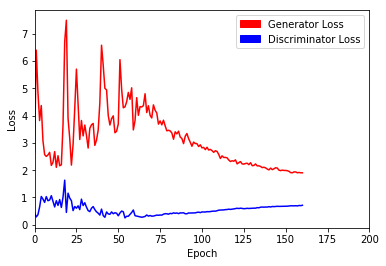

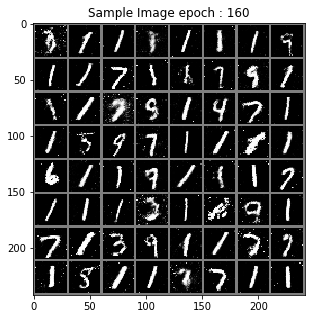

> Epoch : 162 Batch : 19 / 235 Loss_D : 0.7530632615089417 Loss_G : 1.7428858280181885
> Epoch : 162 Batch : 39 / 235 Loss_D : 0.6400563716888428 Loss_G : 2.072478771209717
> Epoch : 162 Batch : 59 / 235 Loss_D : 0.7711727619171143 Loss_G : 1.9936375617980957
> Epoch : 162 Batch : 79 / 235 Loss_D : 0.6639008522033691 Loss_G : 2.094944953918457
> Epoch : 162 Batch : 99 / 235 Loss_D : 0.6974306106567383 Loss_G : 2.0989012718200684
> Epoch : 162 Batch : 119 / 235 Loss_D : 0.7085989713668823 Loss_G : 1.6333060264587402
> Epoch : 162 Batch : 139 / 235 Loss_D : 0.5987840890884399 Loss_G : 2.1666836738586426
> Epoch : 162 Batch : 159 / 235 Loss_D : 0.6897866725921631 Loss_G : 1.856734275817871
> Epoch : 162 Batch : 179 / 235 Loss_D : 0.7260754704475403 Loss_G : 2.143527030944824
> Epoch : 162 Batch : 199 / 235 Loss_D : 0.6856326460838318 Loss_G : 1.8086707592010498
> Epoch : 162 Batch : 219 / 235 Loss_D : 0.8217064738273621 Loss_G : 2.0014684200286865


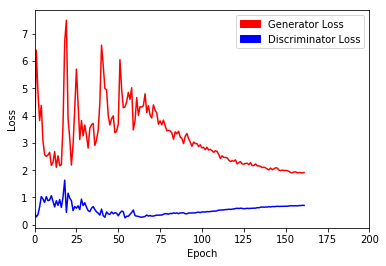

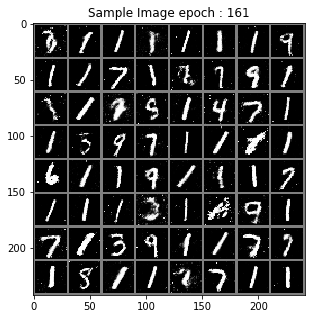

> Epoch : 163 Batch : 19 / 235 Loss_D : 0.7468451261520386 Loss_G : 2.0595409870147705
> Epoch : 163 Batch : 39 / 235 Loss_D : 0.7041181325912476 Loss_G : 1.897603988647461
> Epoch : 163 Batch : 59 / 235 Loss_D : 0.6759050488471985 Loss_G : 1.596806526184082
> Epoch : 163 Batch : 79 / 235 Loss_D : 0.6111195087432861 Loss_G : 1.625152587890625
> Epoch : 163 Batch : 99 / 235 Loss_D : 0.7683255076408386 Loss_G : 1.6797579526901245
> Epoch : 163 Batch : 119 / 235 Loss_D : 0.7750570774078369 Loss_G : 1.7954175472259521
> Epoch : 163 Batch : 139 / 235 Loss_D : 0.6980458498001099 Loss_G : 1.973060131072998
> Epoch : 163 Batch : 159 / 235 Loss_D : 0.6569523811340332 Loss_G : 1.7462207078933716
> Epoch : 163 Batch : 179 / 235 Loss_D : 0.6573396921157837 Loss_G : 1.751294732093811
> Epoch : 163 Batch : 199 / 235 Loss_D : 0.7446886897087097 Loss_G : 1.672815203666687
> Epoch : 163 Batch : 219 / 235 Loss_D : 0.6709574460983276 Loss_G : 1.8451430797576904


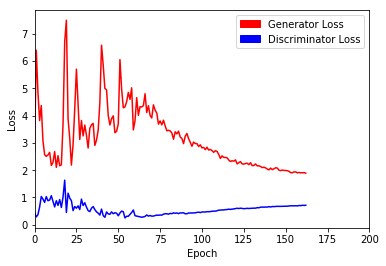

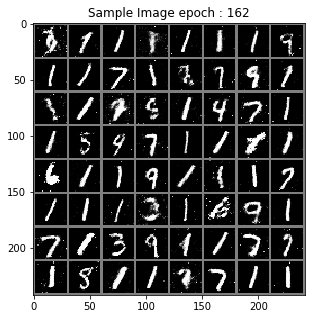

> Epoch : 164 Batch : 19 / 235 Loss_D : 0.8213595747947693 Loss_G : 2.0279972553253174
> Epoch : 164 Batch : 39 / 235 Loss_D : 0.6935941576957703 Loss_G : 2.0716476440429688
> Epoch : 164 Batch : 59 / 235 Loss_D : 0.7303942441940308 Loss_G : 1.8355798721313477
> Epoch : 164 Batch : 79 / 235 Loss_D : 0.7372385263442993 Loss_G : 1.8363038301467896
> Epoch : 164 Batch : 99 / 235 Loss_D : 0.7515506744384766 Loss_G : 2.002786159515381
> Epoch : 164 Batch : 119 / 235 Loss_D : 0.6646213531494141 Loss_G : 1.9221971035003662
> Epoch : 164 Batch : 139 / 235 Loss_D : 0.6765302419662476 Loss_G : 1.8186702728271484
> Epoch : 164 Batch : 159 / 235 Loss_D : 0.7214312553405762 Loss_G : 1.7933114767074585
> Epoch : 164 Batch : 179 / 235 Loss_D : 0.7091506719589233 Loss_G : 2.0867395401000977
> Epoch : 164 Batch : 199 / 235 Loss_D : 0.806445300579071 Loss_G : 1.8644851446151733
> Epoch : 164 Batch : 219 / 235 Loss_D : 0.6390939354896545 Loss_G : 1.9811861515045166


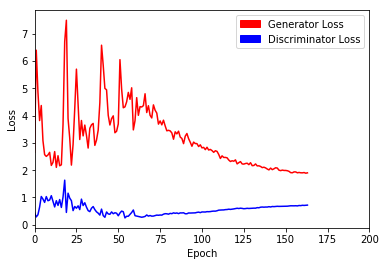

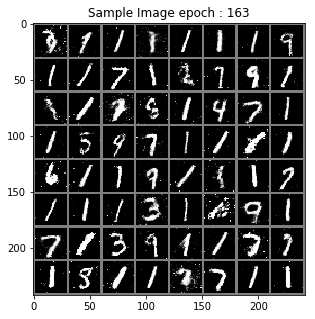

> Epoch : 165 Batch : 19 / 235 Loss_D : 0.7732413411140442 Loss_G : 1.884465217590332
> Epoch : 165 Batch : 39 / 235 Loss_D : 0.6330593228340149 Loss_G : 2.165844440460205
> Epoch : 165 Batch : 59 / 235 Loss_D : 0.8336888551712036 Loss_G : 1.9369418621063232
> Epoch : 165 Batch : 79 / 235 Loss_D : 0.8019373416900635 Loss_G : 2.013277053833008
> Epoch : 165 Batch : 99 / 235 Loss_D : 0.7584832906723022 Loss_G : 1.7785091400146484
> Epoch : 165 Batch : 119 / 235 Loss_D : 0.7409124374389648 Loss_G : 1.9945945739746094
> Epoch : 165 Batch : 139 / 235 Loss_D : 0.761762797832489 Loss_G : 1.7191853523254395
> Epoch : 165 Batch : 159 / 235 Loss_D : 0.6418102979660034 Loss_G : 1.8539780378341675
> Epoch : 165 Batch : 179 / 235 Loss_D : 0.7040291428565979 Loss_G : 2.051734209060669
> Epoch : 165 Batch : 199 / 235 Loss_D : 0.6870502233505249 Loss_G : 2.1540980339050293
> Epoch : 165 Batch : 219 / 235 Loss_D : 0.711231529712677 Loss_G : 1.6804752349853516


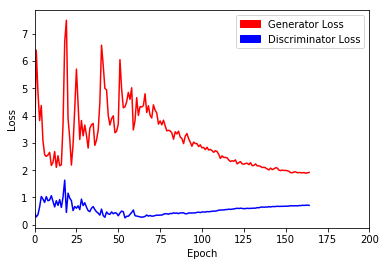

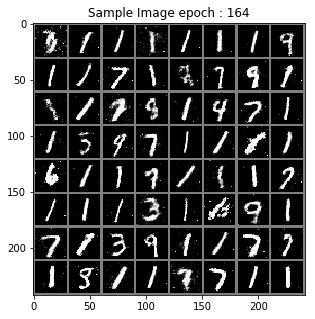

> Epoch : 166 Batch : 19 / 235 Loss_D : 0.7301978468894958 Loss_G : 2.0366029739379883
> Epoch : 166 Batch : 39 / 235 Loss_D : 0.7851589322090149 Loss_G : 1.8117423057556152
> Epoch : 166 Batch : 59 / 235 Loss_D : 0.6423699855804443 Loss_G : 1.6604691743850708
> Epoch : 166 Batch : 79 / 235 Loss_D : 0.7160468101501465 Loss_G : 1.6263728141784668
> Epoch : 166 Batch : 99 / 235 Loss_D : 0.6638082265853882 Loss_G : 1.6301653385162354
> Epoch : 166 Batch : 119 / 235 Loss_D : 0.7138214707374573 Loss_G : 1.9181596040725708
> Epoch : 166 Batch : 139 / 235 Loss_D : 0.7445847988128662 Loss_G : 1.8585700988769531
> Epoch : 166 Batch : 159 / 235 Loss_D : 0.7262636423110962 Loss_G : 1.7723195552825928
> Epoch : 166 Batch : 179 / 235 Loss_D : 0.8011037111282349 Loss_G : 1.9384076595306396
> Epoch : 166 Batch : 199 / 235 Loss_D : 0.676919162273407 Loss_G : 2.0353047847747803
> Epoch : 166 Batch : 219 / 235 Loss_D : 0.6347452402114868 Loss_G : 1.8515512943267822


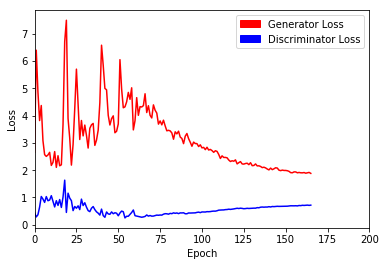

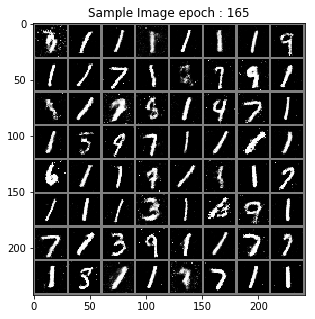

> Epoch : 167 Batch : 19 / 235 Loss_D : 0.7240771055221558 Loss_G : 1.830209732055664
> Epoch : 167 Batch : 39 / 235 Loss_D : 0.7764214277267456 Loss_G : 2.049957513809204
> Epoch : 167 Batch : 59 / 235 Loss_D : 0.6852201223373413 Loss_G : 2.034226894378662
> Epoch : 167 Batch : 79 / 235 Loss_D : 0.7105104923248291 Loss_G : 1.8488507270812988
> Epoch : 167 Batch : 99 / 235 Loss_D : 0.6713660359382629 Loss_G : 1.9562125205993652
> Epoch : 167 Batch : 119 / 235 Loss_D : 0.744144082069397 Loss_G : 1.7187594175338745
> Epoch : 167 Batch : 139 / 235 Loss_D : 0.7179903984069824 Loss_G : 1.8539667129516602
> Epoch : 167 Batch : 159 / 235 Loss_D : 0.6858541965484619 Loss_G : 1.7316977977752686
> Epoch : 167 Batch : 179 / 235 Loss_D : 0.8047057390213013 Loss_G : 1.8328521251678467
> Epoch : 167 Batch : 199 / 235 Loss_D : 0.7805672287940979 Loss_G : 1.859554648399353
> Epoch : 167 Batch : 219 / 235 Loss_D : 0.7285119891166687 Loss_G : 1.9360345602035522


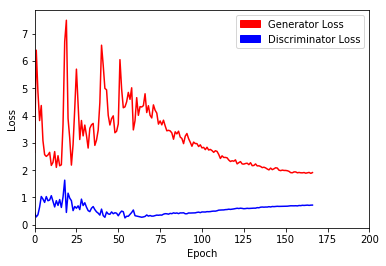

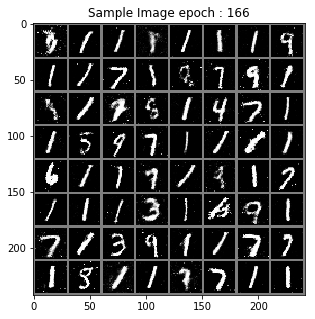

> Epoch : 168 Batch : 19 / 235 Loss_D : 0.789374589920044 Loss_G : 2.013505697250366
> Epoch : 168 Batch : 39 / 235 Loss_D : 0.7141387462615967 Loss_G : 1.8558546304702759
> Epoch : 168 Batch : 59 / 235 Loss_D : 0.7448716163635254 Loss_G : 1.8576385974884033
> Epoch : 168 Batch : 79 / 235 Loss_D : 0.694317102432251 Loss_G : 1.784186840057373
> Epoch : 168 Batch : 99 / 235 Loss_D : 0.6775628328323364 Loss_G : 1.9085124731063843
> Epoch : 168 Batch : 119 / 235 Loss_D : 0.7242996096611023 Loss_G : 1.8554623126983643
> Epoch : 168 Batch : 139 / 235 Loss_D : 0.7377110719680786 Loss_G : 1.8533130884170532
> Epoch : 168 Batch : 159 / 235 Loss_D : 0.6344637870788574 Loss_G : 2.0794568061828613
> Epoch : 168 Batch : 179 / 235 Loss_D : 0.7975519895553589 Loss_G : 1.8954873085021973
> Epoch : 168 Batch : 199 / 235 Loss_D : 0.8197174668312073 Loss_G : 1.875809669494629
> Epoch : 168 Batch : 219 / 235 Loss_D : 0.7192559242248535 Loss_G : 1.9596636295318604


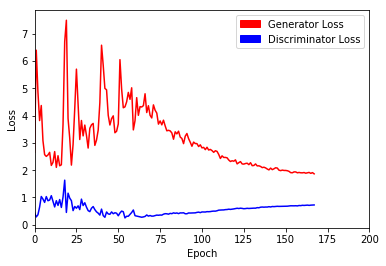

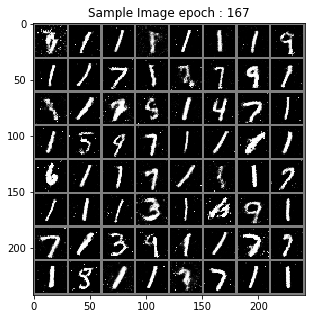

> Epoch : 169 Batch : 19 / 235 Loss_D : 0.6952890157699585 Loss_G : 1.9020596742630005
> Epoch : 169 Batch : 39 / 235 Loss_D : 0.6932651400566101 Loss_G : 1.744450569152832
> Epoch : 169 Batch : 59 / 235 Loss_D : 0.730323851108551 Loss_G : 1.568533182144165
> Epoch : 169 Batch : 79 / 235 Loss_D : 0.6559473872184753 Loss_G : 2.1521849632263184
> Epoch : 169 Batch : 99 / 235 Loss_D : 0.7761448621749878 Loss_G : 1.4943186044692993
> Epoch : 169 Batch : 119 / 235 Loss_D : 0.7981895208358765 Loss_G : 1.789620280265808
> Epoch : 169 Batch : 139 / 235 Loss_D : 0.6658449769020081 Loss_G : 1.6633446216583252
> Epoch : 169 Batch : 159 / 235 Loss_D : 0.6643783450126648 Loss_G : 1.8463895320892334
> Epoch : 169 Batch : 179 / 235 Loss_D : 0.8371061086654663 Loss_G : 1.7333180904388428
> Epoch : 169 Batch : 199 / 235 Loss_D : 0.731145977973938 Loss_G : 1.6717084646224976
> Epoch : 169 Batch : 219 / 235 Loss_D : 0.6568793058395386 Loss_G : 1.6318027973175049


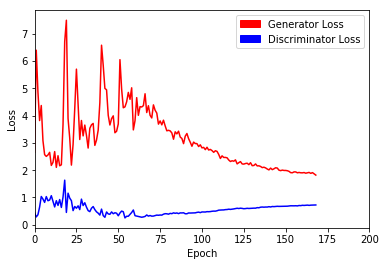

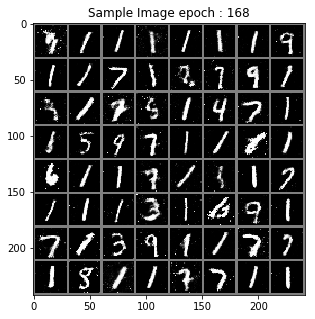

> Epoch : 170 Batch : 19 / 235 Loss_D : 0.6854780912399292 Loss_G : 1.7815824747085571
> Epoch : 170 Batch : 39 / 235 Loss_D : 0.6333367824554443 Loss_G : 1.972093105316162
> Epoch : 170 Batch : 59 / 235 Loss_D : 0.8707435131072998 Loss_G : 1.9818205833435059
> Epoch : 170 Batch : 79 / 235 Loss_D : 0.7271020412445068 Loss_G : 2.026043653488159
> Epoch : 170 Batch : 99 / 235 Loss_D : 0.7185528874397278 Loss_G : 2.279841423034668
> Epoch : 170 Batch : 119 / 235 Loss_D : 0.7943727970123291 Loss_G : 1.9278711080551147
> Epoch : 170 Batch : 139 / 235 Loss_D : 0.6225721836090088 Loss_G : 1.852924108505249
> Epoch : 170 Batch : 159 / 235 Loss_D : 0.6522272825241089 Loss_G : 1.8541343212127686
> Epoch : 170 Batch : 179 / 235 Loss_D : 0.8287940621376038 Loss_G : 1.86048424243927
> Epoch : 170 Batch : 199 / 235 Loss_D : 0.696946382522583 Loss_G : 1.8859018087387085
> Epoch : 170 Batch : 219 / 235 Loss_D : 0.721442699432373 Loss_G : 2.050121307373047


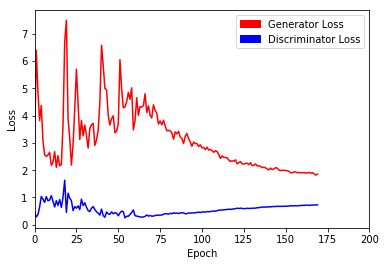

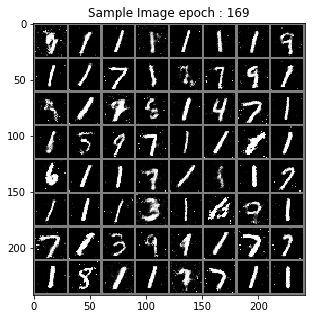

> Epoch : 171 Batch : 19 / 235 Loss_D : 0.7221705913543701 Loss_G : 1.6418652534484863
> Epoch : 171 Batch : 39 / 235 Loss_D : 0.7227883338928223 Loss_G : 1.7319450378417969
> Epoch : 171 Batch : 59 / 235 Loss_D : 0.7141575813293457 Loss_G : 1.827789545059204
> Epoch : 171 Batch : 79 / 235 Loss_D : 0.7408341765403748 Loss_G : 1.7908459901809692
> Epoch : 171 Batch : 99 / 235 Loss_D : 0.7713501453399658 Loss_G : 1.834188461303711
> Epoch : 171 Batch : 119 / 235 Loss_D : 0.7361220121383667 Loss_G : 1.8439571857452393
> Epoch : 171 Batch : 139 / 235 Loss_D : 0.5982627868652344 Loss_G : 2.2383642196655273
> Epoch : 171 Batch : 159 / 235 Loss_D : 0.8167864084243774 Loss_G : 1.8733432292938232
> Epoch : 171 Batch : 179 / 235 Loss_D : 0.7214338779449463 Loss_G : 1.9664921760559082
> Epoch : 171 Batch : 199 / 235 Loss_D : 0.6473801732063293 Loss_G : 2.0891942977905273
> Epoch : 171 Batch : 219 / 235 Loss_D : 0.7312600612640381 Loss_G : 1.700310230255127


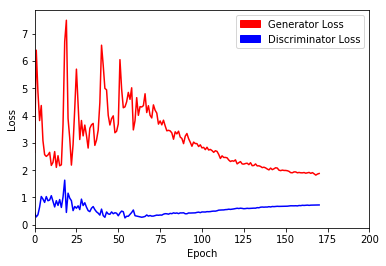

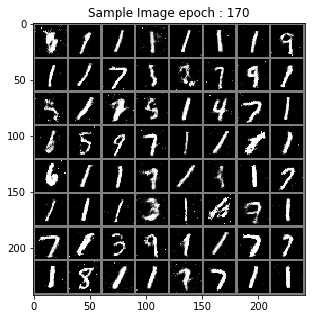

> Epoch : 172 Batch : 19 / 235 Loss_D : 0.6311654448509216 Loss_G : 2.0826339721679688
> Epoch : 172 Batch : 39 / 235 Loss_D : 0.8227922916412354 Loss_G : 1.9888886213302612
> Epoch : 172 Batch : 59 / 235 Loss_D : 0.7072222828865051 Loss_G : 1.8750109672546387
> Epoch : 172 Batch : 79 / 235 Loss_D : 0.6833441853523254 Loss_G : 2.026958703994751
> Epoch : 172 Batch : 99 / 235 Loss_D : 0.7746062278747559 Loss_G : 1.8878953456878662
> Epoch : 172 Batch : 119 / 235 Loss_D : 0.6721572875976562 Loss_G : 1.6283013820648193
> Epoch : 172 Batch : 139 / 235 Loss_D : 0.6872739195823669 Loss_G : 1.677807331085205
> Epoch : 172 Batch : 159 / 235 Loss_D : 0.6974048614501953 Loss_G : 1.6626029014587402
> Epoch : 172 Batch : 179 / 235 Loss_D : 0.7435020208358765 Loss_G : 2.0758681297302246
> Epoch : 172 Batch : 199 / 235 Loss_D : 0.7833348512649536 Loss_G : 1.7951414585113525
> Epoch : 172 Batch : 219 / 235 Loss_D : 0.6791534423828125 Loss_G : 2.103745937347412


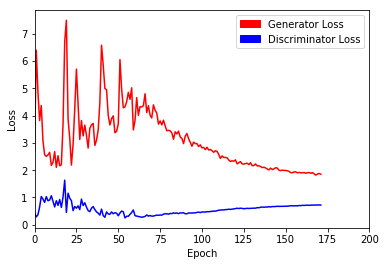

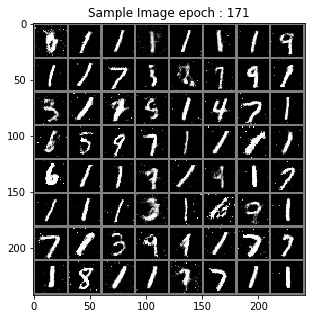

> Epoch : 173 Batch : 19 / 235 Loss_D : 0.613998293876648 Loss_G : 1.9812530279159546
> Epoch : 173 Batch : 39 / 235 Loss_D : 0.7037353515625 Loss_G : 2.246588706970215
> Epoch : 173 Batch : 59 / 235 Loss_D : 0.720601499080658 Loss_G : 1.9445585012435913
> Epoch : 173 Batch : 79 / 235 Loss_D : 0.6601790189743042 Loss_G : 1.6853878498077393
> Epoch : 173 Batch : 99 / 235 Loss_D : 0.6650713682174683 Loss_G : 2.051347017288208
> Epoch : 173 Batch : 119 / 235 Loss_D : 0.7271780967712402 Loss_G : 1.8680590391159058
> Epoch : 173 Batch : 139 / 235 Loss_D : 0.7260236144065857 Loss_G : 1.8195987939834595
> Epoch : 173 Batch : 159 / 235 Loss_D : 0.7585517168045044 Loss_G : 1.8636677265167236
> Epoch : 173 Batch : 179 / 235 Loss_D : 0.6822773218154907 Loss_G : 1.8504629135131836
> Epoch : 173 Batch : 199 / 235 Loss_D : 0.8158671855926514 Loss_G : 1.81648850440979
> Epoch : 173 Batch : 219 / 235 Loss_D : 0.7348504662513733 Loss_G : 1.8581639528274536


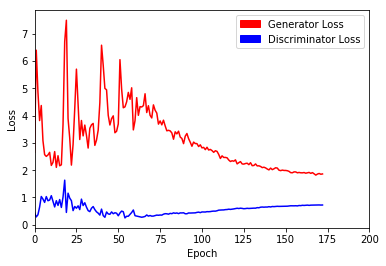

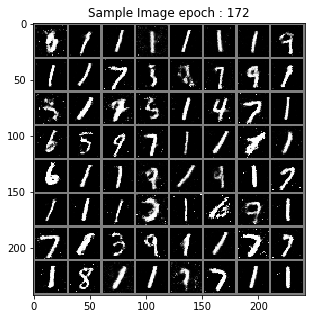

> Epoch : 174 Batch : 19 / 235 Loss_D : 0.6973382830619812 Loss_G : 1.9355487823486328
> Epoch : 174 Batch : 39 / 235 Loss_D : 0.6434539556503296 Loss_G : 2.0071043968200684
> Epoch : 174 Batch : 59 / 235 Loss_D : 0.6815058588981628 Loss_G : 1.7002997398376465
> Epoch : 174 Batch : 79 / 235 Loss_D : 0.6710970401763916 Loss_G : 1.4898662567138672
> Epoch : 174 Batch : 99 / 235 Loss_D : 0.778020977973938 Loss_G : 1.8874003887176514
> Epoch : 174 Batch : 119 / 235 Loss_D : 0.7699552774429321 Loss_G : 1.5755994319915771
> Epoch : 174 Batch : 139 / 235 Loss_D : 0.723700761795044 Loss_G : 1.9976361989974976
> Epoch : 174 Batch : 159 / 235 Loss_D : 0.6478139162063599 Loss_G : 2.310671329498291
> Epoch : 174 Batch : 179 / 235 Loss_D : 0.7173414826393127 Loss_G : 1.7074127197265625
> Epoch : 174 Batch : 199 / 235 Loss_D : 0.6749317646026611 Loss_G : 2.018040657043457
> Epoch : 174 Batch : 219 / 235 Loss_D : 0.7015053033828735 Loss_G : 1.6351290941238403


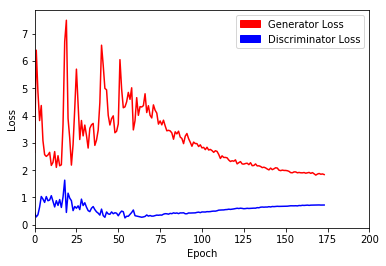

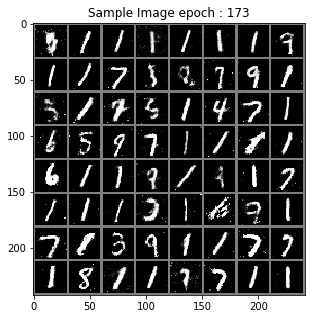

> Epoch : 175 Batch : 19 / 235 Loss_D : 0.8037042617797852 Loss_G : 1.5665446519851685
> Epoch : 175 Batch : 39 / 235 Loss_D : 0.6817829608917236 Loss_G : 1.8369693756103516
> Epoch : 175 Batch : 59 / 235 Loss_D : 0.6562532186508179 Loss_G : 1.8986517190933228
> Epoch : 175 Batch : 79 / 235 Loss_D : 0.8137043714523315 Loss_G : 1.6194422245025635
> Epoch : 175 Batch : 99 / 235 Loss_D : 0.6799178123474121 Loss_G : 1.7003731727600098
> Epoch : 175 Batch : 119 / 235 Loss_D : 0.6460044980049133 Loss_G : 1.8950117826461792
> Epoch : 175 Batch : 139 / 235 Loss_D : 0.6797972917556763 Loss_G : 1.4936453104019165
> Epoch : 175 Batch : 159 / 235 Loss_D : 0.740208625793457 Loss_G : 1.9908448457717896
> Epoch : 175 Batch : 179 / 235 Loss_D : 0.8044067621231079 Loss_G : 1.7549552917480469
> Epoch : 175 Batch : 199 / 235 Loss_D : 0.7396713495254517 Loss_G : 1.9057073593139648
> Epoch : 175 Batch : 219 / 235 Loss_D : 0.7162259817123413 Loss_G : 1.861883282661438


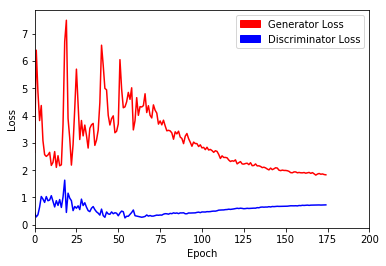

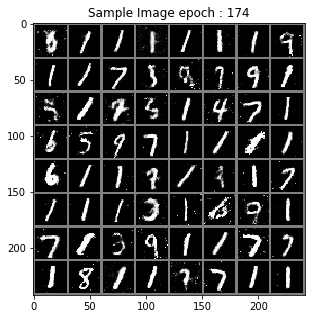

> Epoch : 176 Batch : 19 / 235 Loss_D : 0.7420430183410645 Loss_G : 1.8505830764770508
> Epoch : 176 Batch : 39 / 235 Loss_D : 0.739971399307251 Loss_G : 1.6761409044265747
> Epoch : 176 Batch : 59 / 235 Loss_D : 0.7695380449295044 Loss_G : 1.928810954093933
> Epoch : 176 Batch : 79 / 235 Loss_D : 0.6646213531494141 Loss_G : 1.8753422498703003
> Epoch : 176 Batch : 99 / 235 Loss_D : 0.7093158960342407 Loss_G : 1.7789406776428223
> Epoch : 176 Batch : 119 / 235 Loss_D : 0.6183686256408691 Loss_G : 1.8259031772613525
> Epoch : 176 Batch : 139 / 235 Loss_D : 0.7175989151000977 Loss_G : 1.953187108039856
> Epoch : 176 Batch : 159 / 235 Loss_D : 0.7679721117019653 Loss_G : 1.8354363441467285
> Epoch : 176 Batch : 179 / 235 Loss_D : 0.7469540238380432 Loss_G : 1.933850646018982
> Epoch : 176 Batch : 199 / 235 Loss_D : 0.7442939877510071 Loss_G : 1.7756255865097046
> Epoch : 176 Batch : 219 / 235 Loss_D : 0.6715912818908691 Loss_G : 1.7323652505874634


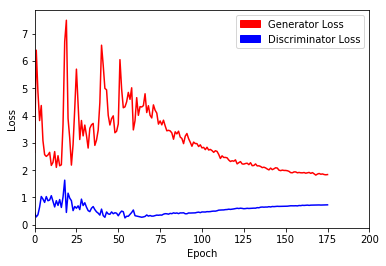

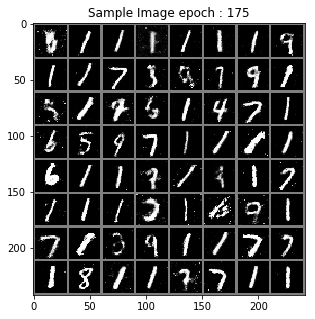

> Epoch : 177 Batch : 19 / 235 Loss_D : 0.729632556438446 Loss_G : 1.9894580841064453
> Epoch : 177 Batch : 39 / 235 Loss_D : 0.7386829257011414 Loss_G : 1.7801356315612793
> Epoch : 177 Batch : 59 / 235 Loss_D : 0.7179485559463501 Loss_G : 1.7010856866836548
> Epoch : 177 Batch : 79 / 235 Loss_D : 0.7366555333137512 Loss_G : 1.708182692527771
> Epoch : 177 Batch : 99 / 235 Loss_D : 0.749053418636322 Loss_G : 1.985858678817749
> Epoch : 177 Batch : 119 / 235 Loss_D : 0.6433602571487427 Loss_G : 2.0462117195129395
> Epoch : 177 Batch : 139 / 235 Loss_D : 0.6855607032775879 Loss_G : 1.6633927822113037
> Epoch : 177 Batch : 159 / 235 Loss_D : 0.7462010979652405 Loss_G : 2.0421202182769775
> Epoch : 177 Batch : 179 / 235 Loss_D : 0.6667978763580322 Loss_G : 1.987027645111084
> Epoch : 177 Batch : 199 / 235 Loss_D : 0.7415177822113037 Loss_G : 2.239661693572998
> Epoch : 177 Batch : 219 / 235 Loss_D : 0.7445241808891296 Loss_G : 1.9486746788024902


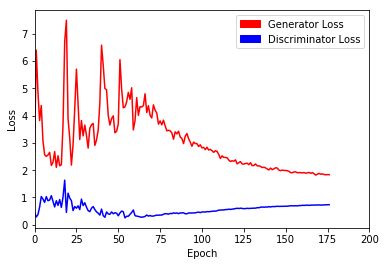

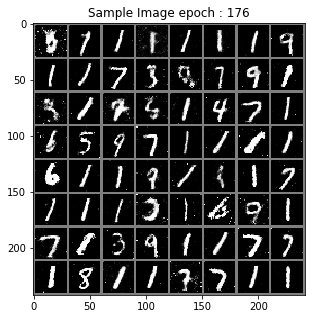

> Epoch : 178 Batch : 19 / 235 Loss_D : 0.776107907295227 Loss_G : 1.8728996515274048
> Epoch : 178 Batch : 39 / 235 Loss_D : 0.6625577807426453 Loss_G : 1.87333083152771
> Epoch : 178 Batch : 59 / 235 Loss_D : 0.70237135887146 Loss_G : 2.140881061553955
> Epoch : 178 Batch : 79 / 235 Loss_D : 0.7377642393112183 Loss_G : 1.8713406324386597
> Epoch : 178 Batch : 99 / 235 Loss_D : 0.8822622299194336 Loss_G : 1.3894821405410767
> Epoch : 178 Batch : 119 / 235 Loss_D : 0.8076164126396179 Loss_G : 2.008828639984131
> Epoch : 178 Batch : 139 / 235 Loss_D : 0.709531843662262 Loss_G : 1.7046054601669312
> Epoch : 178 Batch : 159 / 235 Loss_D : 0.8027864098548889 Loss_G : 2.0349340438842773
> Epoch : 178 Batch : 179 / 235 Loss_D : 0.8025667667388916 Loss_G : 2.2751705646514893
> Epoch : 178 Batch : 199 / 235 Loss_D : 0.8184723854064941 Loss_G : 1.6936676502227783
> Epoch : 178 Batch : 219 / 235 Loss_D : 0.6857051253318787 Loss_G : 1.6981390714645386


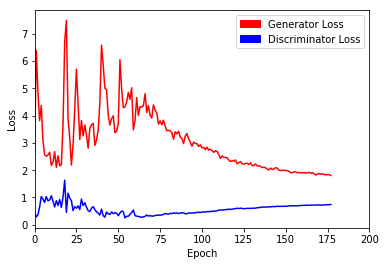

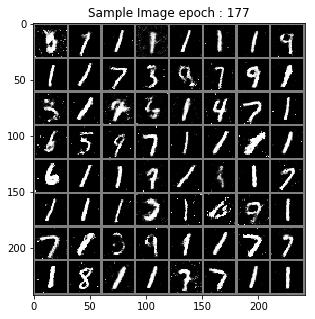

> Epoch : 179 Batch : 19 / 235 Loss_D : 0.8092950582504272 Loss_G : 2.0864555835723877
> Epoch : 179 Batch : 39 / 235 Loss_D : 0.7536767721176147 Loss_G : 1.7313036918640137
> Epoch : 179 Batch : 59 / 235 Loss_D : 0.7091052532196045 Loss_G : 1.5469800233840942
> Epoch : 179 Batch : 79 / 235 Loss_D : 0.7677415609359741 Loss_G : 1.800478458404541
> Epoch : 179 Batch : 99 / 235 Loss_D : 0.8308038115501404 Loss_G : 1.9964416027069092
> Epoch : 179 Batch : 119 / 235 Loss_D : 0.7124369740486145 Loss_G : 2.2068638801574707
> Epoch : 179 Batch : 139 / 235 Loss_D : 0.8622482419013977 Loss_G : 1.8545973300933838
> Epoch : 179 Batch : 159 / 235 Loss_D : 0.7834888696670532 Loss_G : 1.6925891637802124
> Epoch : 179 Batch : 179 / 235 Loss_D : 0.8598661422729492 Loss_G : 1.8164440393447876
> Epoch : 179 Batch : 199 / 235 Loss_D : 0.7011829614639282 Loss_G : 1.6799176931381226
> Epoch : 179 Batch : 219 / 235 Loss_D : 0.8102074861526489 Loss_G : 1.7012401819229126


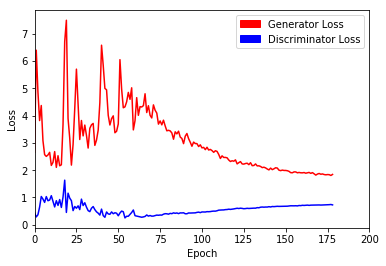

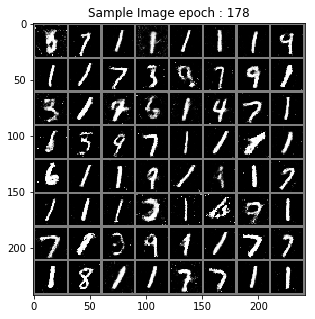

> Epoch : 180 Batch : 19 / 235 Loss_D : 0.6201044321060181 Loss_G : 1.9068965911865234
> Epoch : 180 Batch : 39 / 235 Loss_D : 0.7250790596008301 Loss_G : 1.6699212789535522
> Epoch : 180 Batch : 59 / 235 Loss_D : 0.7491758465766907 Loss_G : 1.7914501428604126
> Epoch : 180 Batch : 79 / 235 Loss_D : 0.7163149118423462 Loss_G : 1.8401918411254883
> Epoch : 180 Batch : 99 / 235 Loss_D : 0.6735913753509521 Loss_G : 2.1336841583251953
> Epoch : 180 Batch : 119 / 235 Loss_D : 0.7170267701148987 Loss_G : 1.8238856792449951
> Epoch : 180 Batch : 139 / 235 Loss_D : 0.7419332265853882 Loss_G : 1.9969322681427002
> Epoch : 180 Batch : 159 / 235 Loss_D : 0.724751353263855 Loss_G : 1.9919114112854004
> Epoch : 180 Batch : 179 / 235 Loss_D : 0.6804863810539246 Loss_G : 2.159409999847412
> Epoch : 180 Batch : 199 / 235 Loss_D : 0.7532455325126648 Loss_G : 1.5613853931427002
> Epoch : 180 Batch : 219 / 235 Loss_D : 0.7470114231109619 Loss_G : 1.6766018867492676


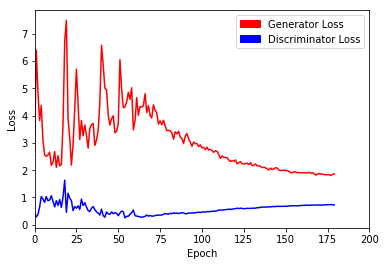

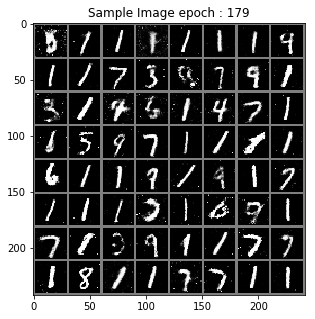

> Epoch : 181 Batch : 19 / 235 Loss_D : 0.7792639136314392 Loss_G : 1.7189786434173584
> Epoch : 181 Batch : 39 / 235 Loss_D : 0.6806083917617798 Loss_G : 1.85963773727417
> Epoch : 181 Batch : 59 / 235 Loss_D : 0.7183462381362915 Loss_G : 1.9332268238067627
> Epoch : 181 Batch : 79 / 235 Loss_D : 0.8106417655944824 Loss_G : 1.5928332805633545
> Epoch : 181 Batch : 99 / 235 Loss_D : 0.7005856037139893 Loss_G : 2.0320472717285156
> Epoch : 181 Batch : 119 / 235 Loss_D : 0.7707338333129883 Loss_G : 1.62060546875
> Epoch : 181 Batch : 139 / 235 Loss_D : 0.7409301400184631 Loss_G : 1.9304388761520386
> Epoch : 181 Batch : 159 / 235 Loss_D : 0.8055524826049805 Loss_G : 1.876474142074585
> Epoch : 181 Batch : 179 / 235 Loss_D : 0.7110663056373596 Loss_G : 2.1147141456604004
> Epoch : 181 Batch : 199 / 235 Loss_D : 0.8116785287857056 Loss_G : 1.8673481941223145
> Epoch : 181 Batch : 219 / 235 Loss_D : 0.7315413951873779 Loss_G : 1.8781321048736572


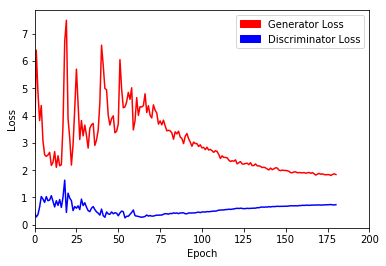

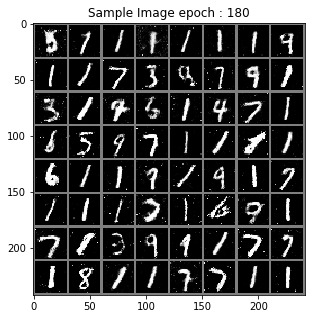

> Epoch : 182 Batch : 19 / 235 Loss_D : 0.7611212134361267 Loss_G : 1.7595289945602417
> Epoch : 182 Batch : 39 / 235 Loss_D : 0.7359858751296997 Loss_G : 1.9140375852584839
> Epoch : 182 Batch : 59 / 235 Loss_D : 0.7870416641235352 Loss_G : 1.6490485668182373
> Epoch : 182 Batch : 79 / 235 Loss_D : 0.7378641366958618 Loss_G : 1.77047860622406
> Epoch : 182 Batch : 99 / 235 Loss_D : 0.682080090045929 Loss_G : 1.7750680446624756
> Epoch : 182 Batch : 119 / 235 Loss_D : 0.7682071328163147 Loss_G : 1.6183024644851685
> Epoch : 182 Batch : 139 / 235 Loss_D : 0.7449665069580078 Loss_G : 1.8790134191513062
> Epoch : 182 Batch : 159 / 235 Loss_D : 0.7488114237785339 Loss_G : 1.8778122663497925
> Epoch : 182 Batch : 179 / 235 Loss_D : 0.7323671579360962 Loss_G : 1.7556971311569214
> Epoch : 182 Batch : 199 / 235 Loss_D : 0.8098621368408203 Loss_G : 1.5810294151306152
> Epoch : 182 Batch : 219 / 235 Loss_D : 0.701144814491272 Loss_G : 2.2575769424438477


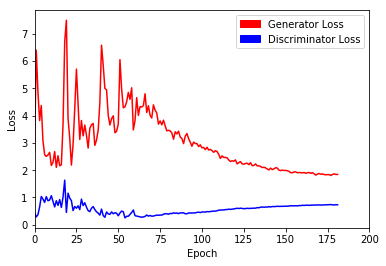

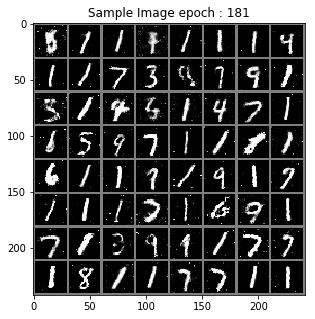

> Epoch : 183 Batch : 19 / 235 Loss_D : 0.7373374700546265 Loss_G : 1.7864041328430176
> Epoch : 183 Batch : 39 / 235 Loss_D : 0.7885648012161255 Loss_G : 1.7900125980377197
> Epoch : 183 Batch : 59 / 235 Loss_D : 0.6055616140365601 Loss_G : 1.6376113891601562
> Epoch : 183 Batch : 79 / 235 Loss_D : 0.7765297889709473 Loss_G : 1.6714332103729248
> Epoch : 183 Batch : 99 / 235 Loss_D : 0.796652615070343 Loss_G : 1.9222378730773926
> Epoch : 183 Batch : 119 / 235 Loss_D : 0.6613078117370605 Loss_G : 1.6957201957702637
> Epoch : 183 Batch : 139 / 235 Loss_D : 0.733875036239624 Loss_G : 1.8185642957687378
> Epoch : 183 Batch : 159 / 235 Loss_D : 0.7562310695648193 Loss_G : 1.915608286857605
> Epoch : 183 Batch : 179 / 235 Loss_D : 0.8316851854324341 Loss_G : 1.7782268524169922
> Epoch : 183 Batch : 199 / 235 Loss_D : 0.7456257939338684 Loss_G : 1.5398706197738647
> Epoch : 183 Batch : 219 / 235 Loss_D : 0.7032877802848816 Loss_G : 1.8211398124694824


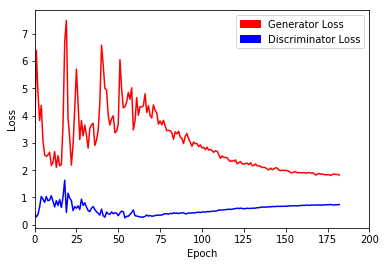

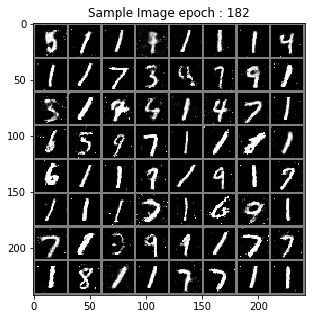

> Epoch : 184 Batch : 19 / 235 Loss_D : 0.7236292362213135 Loss_G : 1.853046178817749
> Epoch : 184 Batch : 39 / 235 Loss_D : 0.6359359622001648 Loss_G : 1.6971039772033691
> Epoch : 184 Batch : 59 / 235 Loss_D : 0.8680505752563477 Loss_G : 1.654769778251648
> Epoch : 184 Batch : 79 / 235 Loss_D : 0.7425003051757812 Loss_G : 1.9786120653152466
> Epoch : 184 Batch : 99 / 235 Loss_D : 0.8008689880371094 Loss_G : 1.6191805601119995
> Epoch : 184 Batch : 119 / 235 Loss_D : 0.720872163772583 Loss_G : 1.8120015859603882
> Epoch : 184 Batch : 139 / 235 Loss_D : 0.8240562081336975 Loss_G : 1.7515904903411865
> Epoch : 184 Batch : 159 / 235 Loss_D : 0.7563858032226562 Loss_G : 1.7450673580169678
> Epoch : 184 Batch : 179 / 235 Loss_D : 0.7556502223014832 Loss_G : 2.128720998764038
> Epoch : 184 Batch : 199 / 235 Loss_D : 0.8106567859649658 Loss_G : 1.746610164642334
> Epoch : 184 Batch : 219 / 235 Loss_D : 0.7099239826202393 Loss_G : 1.9186272621154785


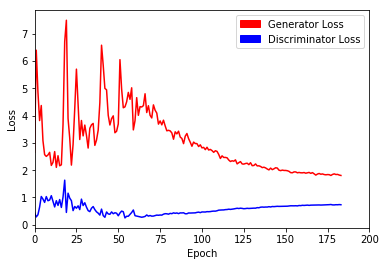

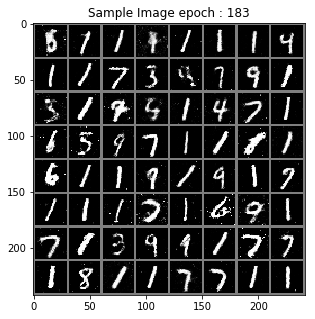

> Epoch : 185 Batch : 19 / 235 Loss_D : 0.7025464773178101 Loss_G : 1.637648344039917
> Epoch : 185 Batch : 39 / 235 Loss_D : 0.6770871877670288 Loss_G : 1.8715687990188599
> Epoch : 185 Batch : 59 / 235 Loss_D : 0.7281790375709534 Loss_G : 1.7434473037719727
> Epoch : 185 Batch : 79 / 235 Loss_D : 0.7123752236366272 Loss_G : 2.1684629917144775
> Epoch : 185 Batch : 99 / 235 Loss_D : 0.7796990871429443 Loss_G : 1.789505958557129
> Epoch : 185 Batch : 119 / 235 Loss_D : 0.7188131809234619 Loss_G : 1.7011016607284546
> Epoch : 185 Batch : 139 / 235 Loss_D : 0.8230067491531372 Loss_G : 1.830717921257019
> Epoch : 185 Batch : 159 / 235 Loss_D : 0.8311054706573486 Loss_G : 1.318920612335205
> Epoch : 185 Batch : 179 / 235 Loss_D : 0.6899060010910034 Loss_G : 1.9265917539596558
> Epoch : 185 Batch : 199 / 235 Loss_D : 0.8179255723953247 Loss_G : 1.8380454778671265
> Epoch : 185 Batch : 219 / 235 Loss_D : 0.7634871006011963 Loss_G : 1.7143688201904297


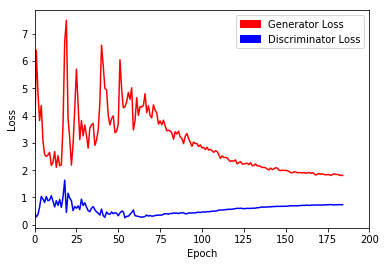

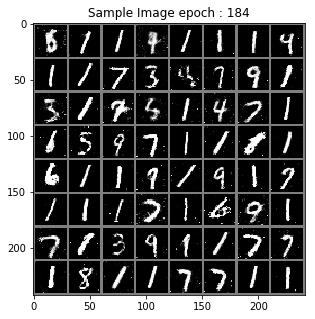

> Epoch : 186 Batch : 19 / 235 Loss_D : 0.8144911527633667 Loss_G : 1.7072346210479736
> Epoch : 186 Batch : 39 / 235 Loss_D : 0.7156223654747009 Loss_G : 1.879093885421753
> Epoch : 186 Batch : 59 / 235 Loss_D : 0.7482703328132629 Loss_G : 1.8224077224731445
> Epoch : 186 Batch : 79 / 235 Loss_D : 0.7323639392852783 Loss_G : 1.8717894554138184
> Epoch : 186 Batch : 99 / 235 Loss_D : 0.7797402739524841 Loss_G : 1.8338584899902344
> Epoch : 186 Batch : 119 / 235 Loss_D : 0.7779837846755981 Loss_G : 1.7907249927520752
> Epoch : 186 Batch : 139 / 235 Loss_D : 0.6887503862380981 Loss_G : 2.1761491298675537
> Epoch : 186 Batch : 159 / 235 Loss_D : 0.8510050773620605 Loss_G : 1.5600171089172363
> Epoch : 186 Batch : 179 / 235 Loss_D : 0.66817307472229 Loss_G : 1.983623743057251
> Epoch : 186 Batch : 199 / 235 Loss_D : 0.8304800987243652 Loss_G : 1.5735561847686768
> Epoch : 186 Batch : 219 / 235 Loss_D : 0.7053637504577637 Loss_G : 2.009535312652588


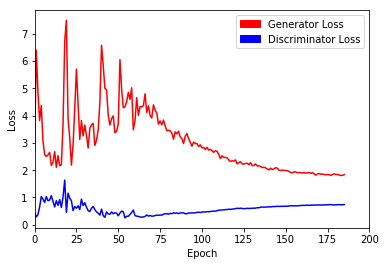

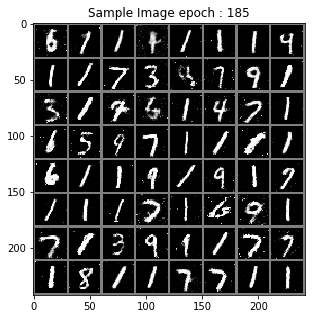

> Epoch : 187 Batch : 19 / 235 Loss_D : 0.6709128618240356 Loss_G : 1.7274361848831177
> Epoch : 187 Batch : 39 / 235 Loss_D : 0.7398232221603394 Loss_G : 1.7006711959838867
> Epoch : 187 Batch : 59 / 235 Loss_D : 0.6514972448348999 Loss_G : 1.9393588304519653
> Epoch : 187 Batch : 79 / 235 Loss_D : 0.7131178975105286 Loss_G : 1.8928136825561523
> Epoch : 187 Batch : 99 / 235 Loss_D : 0.8059607744216919 Loss_G : 1.8213212490081787
> Epoch : 187 Batch : 119 / 235 Loss_D : 0.7635405659675598 Loss_G : 2.0498476028442383
> Epoch : 187 Batch : 139 / 235 Loss_D : 0.7756034731864929 Loss_G : 1.7949824333190918
> Epoch : 187 Batch : 159 / 235 Loss_D : 0.7356616258621216 Loss_G : 1.829946517944336
> Epoch : 187 Batch : 179 / 235 Loss_D : 0.7514370679855347 Loss_G : 1.8769927024841309
> Epoch : 187 Batch : 199 / 235 Loss_D : 0.8069754838943481 Loss_G : 1.8523201942443848
> Epoch : 187 Batch : 219 / 235 Loss_D : 0.7430894374847412 Loss_G : 1.6466565132141113


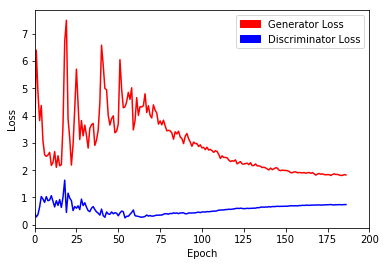

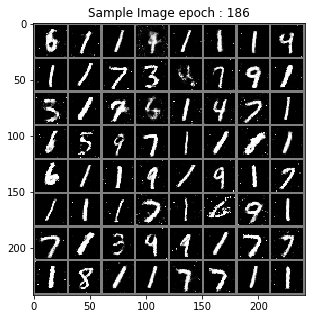

> Epoch : 188 Batch : 19 / 235 Loss_D : 0.7049679756164551 Loss_G : 1.8528571128845215
> Epoch : 188 Batch : 39 / 235 Loss_D : 0.6889853477478027 Loss_G : 1.9906202554702759
> Epoch : 188 Batch : 59 / 235 Loss_D : 0.8261857032775879 Loss_G : 2.0298972129821777
> Epoch : 188 Batch : 79 / 235 Loss_D : 0.8054712414741516 Loss_G : 1.7227685451507568
> Epoch : 188 Batch : 99 / 235 Loss_D : 0.7581136226654053 Loss_G : 1.5977122783660889
> Epoch : 188 Batch : 119 / 235 Loss_D : 0.7433436512947083 Loss_G : 1.8379918336868286
> Epoch : 188 Batch : 139 / 235 Loss_D : 0.724224328994751 Loss_G : 1.6678571701049805
> Epoch : 188 Batch : 159 / 235 Loss_D : 0.7732045650482178 Loss_G : 1.6891651153564453
> Epoch : 188 Batch : 179 / 235 Loss_D : 0.8024857044219971 Loss_G : 1.624467372894287
> Epoch : 188 Batch : 199 / 235 Loss_D : 0.8156893253326416 Loss_G : 1.7117877006530762
> Epoch : 188 Batch : 219 / 235 Loss_D : 0.7699853181838989 Loss_G : 1.6629323959350586


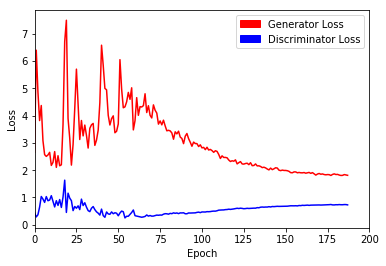

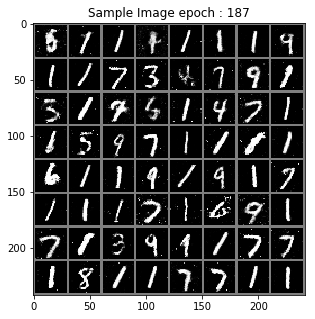

> Epoch : 189 Batch : 19 / 235 Loss_D : 0.7843532562255859 Loss_G : 2.0408260822296143
> Epoch : 189 Batch : 39 / 235 Loss_D : 0.6613539457321167 Loss_G : 1.7450165748596191
> Epoch : 189 Batch : 59 / 235 Loss_D : 0.8027964234352112 Loss_G : 1.6184706687927246
> Epoch : 189 Batch : 79 / 235 Loss_D : 0.6416225433349609 Loss_G : 1.870697259902954
> Epoch : 189 Batch : 99 / 235 Loss_D : 0.7771480083465576 Loss_G : 1.7690414190292358
> Epoch : 189 Batch : 119 / 235 Loss_D : 0.7514681816101074 Loss_G : 1.7268468141555786
> Epoch : 189 Batch : 139 / 235 Loss_D : 0.7009782791137695 Loss_G : 1.7629542350769043
> Epoch : 189 Batch : 159 / 235 Loss_D : 0.6720250248908997 Loss_G : 2.077805519104004
> Epoch : 189 Batch : 179 / 235 Loss_D : 0.593277633190155 Loss_G : 1.9050599336624146
> Epoch : 189 Batch : 199 / 235 Loss_D : 0.8305063843727112 Loss_G : 1.6641976833343506
> Epoch : 189 Batch : 219 / 235 Loss_D : 0.8211265802383423 Loss_G : 1.6822378635406494


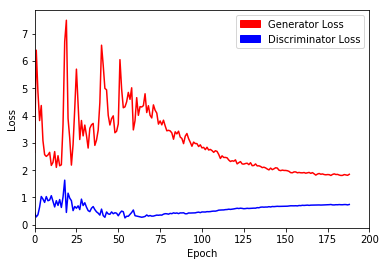

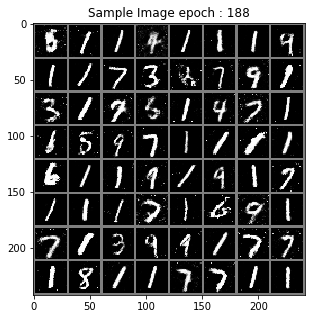

> Epoch : 190 Batch : 19 / 235 Loss_D : 0.6916496753692627 Loss_G : 1.787532091140747
> Epoch : 190 Batch : 39 / 235 Loss_D : 0.8315025568008423 Loss_G : 2.015881061553955
> Epoch : 190 Batch : 59 / 235 Loss_D : 0.7207696437835693 Loss_G : 1.6489787101745605
> Epoch : 190 Batch : 79 / 235 Loss_D : 0.6941385269165039 Loss_G : 1.7767665386199951
> Epoch : 190 Batch : 99 / 235 Loss_D : 0.7309088110923767 Loss_G : 1.795485019683838
> Epoch : 190 Batch : 119 / 235 Loss_D : 0.6684434413909912 Loss_G : 1.7308638095855713
> Epoch : 190 Batch : 139 / 235 Loss_D : 0.8138469457626343 Loss_G : 1.6148821115493774
> Epoch : 190 Batch : 159 / 235 Loss_D : 0.6877436637878418 Loss_G : 1.8706088066101074
> Epoch : 190 Batch : 179 / 235 Loss_D : 0.6948965787887573 Loss_G : 1.8401830196380615
> Epoch : 190 Batch : 199 / 235 Loss_D : 0.7675843834877014 Loss_G : 1.6561578512191772
> Epoch : 190 Batch : 219 / 235 Loss_D : 0.7826903462409973 Loss_G : 2.216142416000366


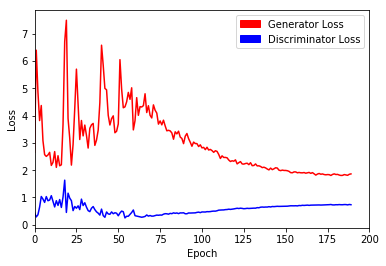

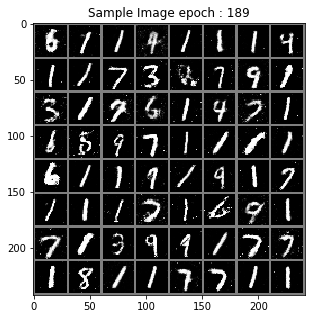

> Epoch : 191 Batch : 19 / 235 Loss_D : 0.8401223421096802 Loss_G : 1.9126962423324585
> Epoch : 191 Batch : 39 / 235 Loss_D : 0.7831759452819824 Loss_G : 1.9124501943588257
> Epoch : 191 Batch : 59 / 235 Loss_D : 0.700350284576416 Loss_G : 1.7786338329315186
> Epoch : 191 Batch : 79 / 235 Loss_D : 0.7781655788421631 Loss_G : 1.7996582984924316
> Epoch : 191 Batch : 99 / 235 Loss_D : 0.7513527870178223 Loss_G : 1.363193392753601
> Epoch : 191 Batch : 119 / 235 Loss_D : 0.7826741933822632 Loss_G : 1.729433298110962
> Epoch : 191 Batch : 139 / 235 Loss_D : 0.7408573031425476 Loss_G : 1.8587175607681274
> Epoch : 191 Batch : 159 / 235 Loss_D : 0.6527529358863831 Loss_G : 1.7540243864059448
> Epoch : 191 Batch : 179 / 235 Loss_D : 0.7396566271781921 Loss_G : 1.630899429321289
> Epoch : 191 Batch : 199 / 235 Loss_D : 0.8237599730491638 Loss_G : 1.7836346626281738
> Epoch : 191 Batch : 219 / 235 Loss_D : 0.7303509712219238 Loss_G : 1.8309139013290405


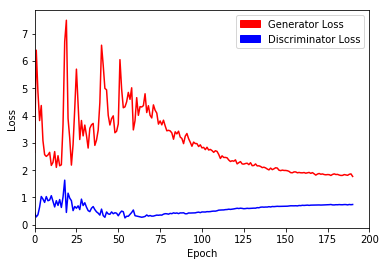

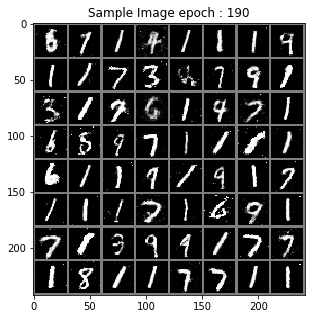

> Epoch : 192 Batch : 19 / 235 Loss_D : 0.7283105850219727 Loss_G : 1.9160923957824707
> Epoch : 192 Batch : 39 / 235 Loss_D : 0.693353533744812 Loss_G : 1.9271844625473022
> Epoch : 192 Batch : 59 / 235 Loss_D : 0.6638418436050415 Loss_G : 1.916176199913025
> Epoch : 192 Batch : 79 / 235 Loss_D : 0.7440381050109863 Loss_G : 1.8386669158935547
> Epoch : 192 Batch : 99 / 235 Loss_D : 0.7859559059143066 Loss_G : 1.621233344078064
> Epoch : 192 Batch : 119 / 235 Loss_D : 0.7140058875083923 Loss_G : 1.9991918802261353
> Epoch : 192 Batch : 139 / 235 Loss_D : 0.7479535937309265 Loss_G : 1.9478166103363037
> Epoch : 192 Batch : 159 / 235 Loss_D : 0.8107078671455383 Loss_G : 1.8440078496932983
> Epoch : 192 Batch : 179 / 235 Loss_D : 0.6732059121131897 Loss_G : 1.6998388767242432
> Epoch : 192 Batch : 199 / 235 Loss_D : 0.7563670873641968 Loss_G : 1.6954296827316284
> Epoch : 192 Batch : 219 / 235 Loss_D : 0.7147887945175171 Loss_G : 2.133591413497925


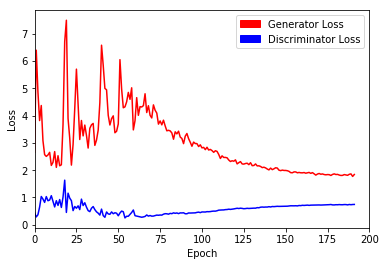

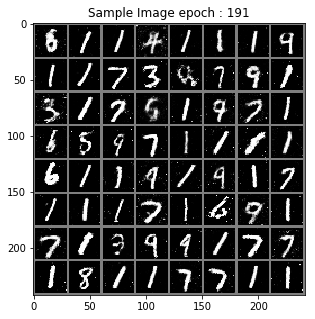

> Epoch : 193 Batch : 19 / 235 Loss_D : 0.6828674077987671 Loss_G : 1.8439927101135254
> Epoch : 193 Batch : 39 / 235 Loss_D : 0.7745287418365479 Loss_G : 1.9609038829803467
> Epoch : 193 Batch : 59 / 235 Loss_D : 0.8121546506881714 Loss_G : 2.0204572677612305
> Epoch : 193 Batch : 79 / 235 Loss_D : 0.6775059700012207 Loss_G : 2.0982561111450195
> Epoch : 193 Batch : 99 / 235 Loss_D : 0.7537603974342346 Loss_G : 1.819840669631958
> Epoch : 193 Batch : 119 / 235 Loss_D : 0.763414204120636 Loss_G : 1.829433560371399
> Epoch : 193 Batch : 139 / 235 Loss_D : 0.7845052480697632 Loss_G : 1.6489417552947998
> Epoch : 193 Batch : 159 / 235 Loss_D : 0.6905810832977295 Loss_G : 2.0364270210266113
> Epoch : 193 Batch : 179 / 235 Loss_D : 0.730543851852417 Loss_G : 1.6013412475585938
> Epoch : 193 Batch : 199 / 235 Loss_D : 0.7129181623458862 Loss_G : 1.8882708549499512
> Epoch : 193 Batch : 219 / 235 Loss_D : 0.8124126195907593 Loss_G : 1.7188526391983032


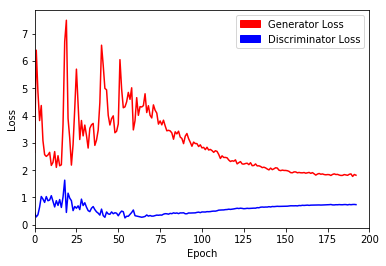

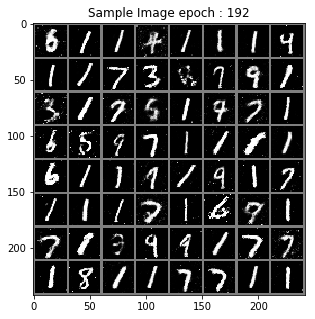

> Epoch : 194 Batch : 19 / 235 Loss_D : 0.78538978099823 Loss_G : 1.8274987936019897
> Epoch : 194 Batch : 39 / 235 Loss_D : 0.726402997970581 Loss_G : 1.8079077005386353
> Epoch : 194 Batch : 59 / 235 Loss_D : 0.630996584892273 Loss_G : 2.007938861846924
> Epoch : 194 Batch : 79 / 235 Loss_D : 0.7627344131469727 Loss_G : 1.8029881715774536
> Epoch : 194 Batch : 99 / 235 Loss_D : 0.7541102766990662 Loss_G : 1.7520980834960938
> Epoch : 194 Batch : 119 / 235 Loss_D : 0.6368250846862793 Loss_G : 2.001425266265869
> Epoch : 194 Batch : 139 / 235 Loss_D : 0.736799418926239 Loss_G : 1.6690469980239868
> Epoch : 194 Batch : 159 / 235 Loss_D : 0.6686185002326965 Loss_G : 1.9265683889389038
> Epoch : 194 Batch : 179 / 235 Loss_D : 0.6752340793609619 Loss_G : 2.0058135986328125
> Epoch : 194 Batch : 199 / 235 Loss_D : 0.7669966816902161 Loss_G : 1.5726499557495117
> Epoch : 194 Batch : 219 / 235 Loss_D : 0.7588198184967041 Loss_G : 1.7756812572479248


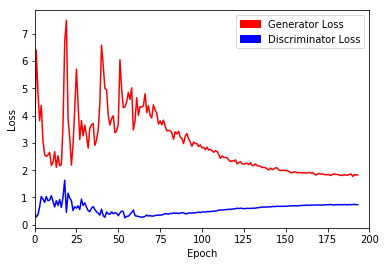

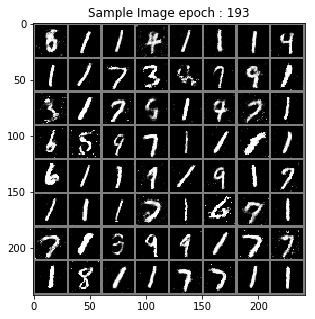

> Epoch : 195 Batch : 19 / 235 Loss_D : 0.7784301042556763 Loss_G : 1.7905972003936768
> Epoch : 195 Batch : 39 / 235 Loss_D : 0.6961954832077026 Loss_G : 1.7258274555206299
> Epoch : 195 Batch : 59 / 235 Loss_D : 0.7517579197883606 Loss_G : 1.9500126838684082
> Epoch : 195 Batch : 79 / 235 Loss_D : 0.8602654933929443 Loss_G : 1.7827825546264648
> Epoch : 195 Batch : 99 / 235 Loss_D : 0.6876205205917358 Loss_G : 1.9870550632476807
> Epoch : 195 Batch : 119 / 235 Loss_D : 0.812423825263977 Loss_G : 2.016542911529541
> Epoch : 195 Batch : 139 / 235 Loss_D : 0.6704423427581787 Loss_G : 1.5839834213256836
> Epoch : 195 Batch : 159 / 235 Loss_D : 0.7011359930038452 Loss_G : 1.8108211755752563
> Epoch : 195 Batch : 179 / 235 Loss_D : 0.8369776010513306 Loss_G : 1.6351532936096191
> Epoch : 195 Batch : 199 / 235 Loss_D : 0.7370861172676086 Loss_G : 1.6186590194702148
> Epoch : 195 Batch : 219 / 235 Loss_D : 0.8072425127029419 Loss_G : 1.6825401782989502


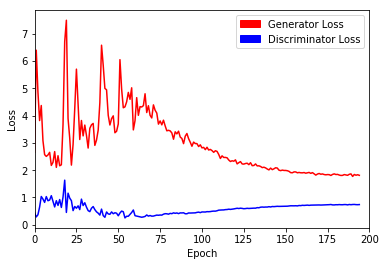

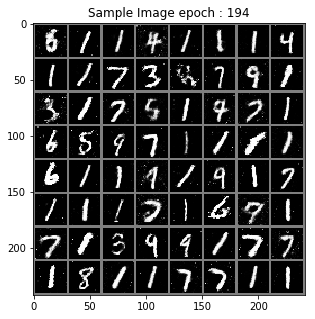

> Epoch : 196 Batch : 19 / 235 Loss_D : 0.7287020683288574 Loss_G : 1.947929859161377
> Epoch : 196 Batch : 39 / 235 Loss_D : 0.6957083940505981 Loss_G : 1.5508676767349243
> Epoch : 196 Batch : 59 / 235 Loss_D : 0.7439994812011719 Loss_G : 1.647383451461792
> Epoch : 196 Batch : 79 / 235 Loss_D : 0.6317969560623169 Loss_G : 1.8901453018188477
> Epoch : 196 Batch : 99 / 235 Loss_D : 0.7112990617752075 Loss_G : 1.9744348526000977
> Epoch : 196 Batch : 119 / 235 Loss_D : 0.8133804798126221 Loss_G : 1.9248864650726318
> Epoch : 196 Batch : 139 / 235 Loss_D : 0.764428973197937 Loss_G : 1.6982872486114502
> Epoch : 196 Batch : 159 / 235 Loss_D : 0.7643302083015442 Loss_G : 1.9867041110992432
> Epoch : 196 Batch : 179 / 235 Loss_D : 0.7567184567451477 Loss_G : 2.007110595703125
> Epoch : 196 Batch : 199 / 235 Loss_D : 0.7084357738494873 Loss_G : 1.6559815406799316
> Epoch : 196 Batch : 219 / 235 Loss_D : 0.7425493001937866 Loss_G : 1.693739891052246


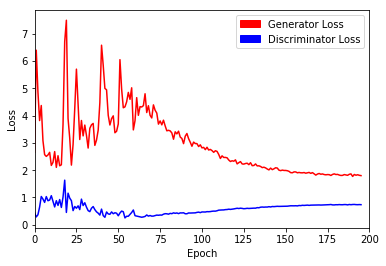

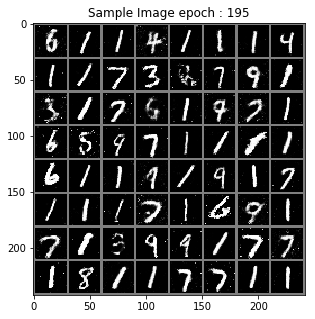

> Epoch : 197 Batch : 19 / 235 Loss_D : 0.6938075423240662 Loss_G : 2.064561367034912
> Epoch : 197 Batch : 39 / 235 Loss_D : 0.7094607949256897 Loss_G : 1.8864670991897583
> Epoch : 197 Batch : 59 / 235 Loss_D : 0.7940649390220642 Loss_G : 1.9313567876815796
> Epoch : 197 Batch : 79 / 235 Loss_D : 0.8862181901931763 Loss_G : 1.6840276718139648
> Epoch : 197 Batch : 99 / 235 Loss_D : 0.721458911895752 Loss_G : 1.9622390270233154
> Epoch : 197 Batch : 119 / 235 Loss_D : 0.7025024890899658 Loss_G : 1.803333044052124
> Epoch : 197 Batch : 139 / 235 Loss_D : 0.7106224894523621 Loss_G : 1.7867002487182617
> Epoch : 197 Batch : 159 / 235 Loss_D : 0.6637131571769714 Loss_G : 1.8545620441436768
> Epoch : 197 Batch : 179 / 235 Loss_D : 0.6525547504425049 Loss_G : 2.1041219234466553
> Epoch : 197 Batch : 199 / 235 Loss_D : 0.8708202838897705 Loss_G : 1.6387529373168945
> Epoch : 197 Batch : 219 / 235 Loss_D : 0.7469683885574341 Loss_G : 2.0435245037078857


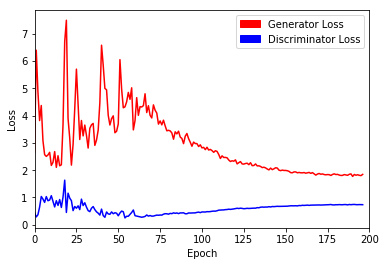

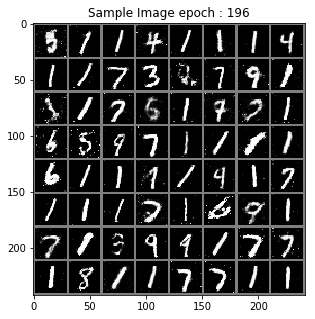

> Epoch : 198 Batch : 19 / 235 Loss_D : 0.7419924736022949 Loss_G : 1.9091367721557617
> Epoch : 198 Batch : 39 / 235 Loss_D : 0.8515384197235107 Loss_G : 1.6701784133911133
> Epoch : 198 Batch : 59 / 235 Loss_D : 0.795006275177002 Loss_G : 1.9768763780593872
> Epoch : 198 Batch : 79 / 235 Loss_D : 0.6803185939788818 Loss_G : 1.7213783264160156
> Epoch : 198 Batch : 99 / 235 Loss_D : 0.7706356048583984 Loss_G : 1.7604188919067383
> Epoch : 198 Batch : 119 / 235 Loss_D : 0.7569950819015503 Loss_G : 1.7105443477630615
> Epoch : 198 Batch : 139 / 235 Loss_D : 0.8071075677871704 Loss_G : 1.8295601606369019
> Epoch : 198 Batch : 159 / 235 Loss_D : 0.6912171840667725 Loss_G : 1.9801065921783447
> Epoch : 198 Batch : 179 / 235 Loss_D : 0.7953064441680908 Loss_G : 1.9364702701568604
> Epoch : 198 Batch : 199 / 235 Loss_D : 0.7669627070426941 Loss_G : 1.9233019351959229
> Epoch : 198 Batch : 219 / 235 Loss_D : 0.7086465954780579 Loss_G : 1.9301259517669678


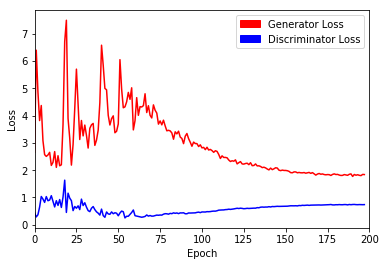

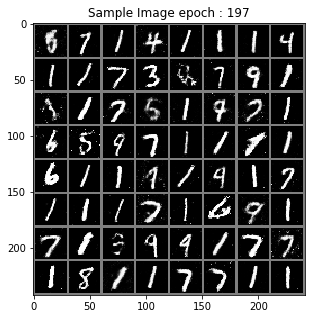

> Epoch : 199 Batch : 19 / 235 Loss_D : 0.6803379058837891 Loss_G : 1.8193867206573486
> Epoch : 199 Batch : 39 / 235 Loss_D : 0.6778963804244995 Loss_G : 1.703256368637085
> Epoch : 199 Batch : 59 / 235 Loss_D : 0.7005377411842346 Loss_G : 1.9543163776397705
> Epoch : 199 Batch : 79 / 235 Loss_D : 0.6752768754959106 Loss_G : 1.7851886749267578
> Epoch : 199 Batch : 99 / 235 Loss_D : 0.7074340581893921 Loss_G : 1.906996726989746
> Epoch : 199 Batch : 119 / 235 Loss_D : 0.7940912246704102 Loss_G : 1.7998969554901123
> Epoch : 199 Batch : 139 / 235 Loss_D : 0.6130344867706299 Loss_G : 1.6547281742095947
> Epoch : 199 Batch : 159 / 235 Loss_D : 0.8602650165557861 Loss_G : 1.842972755432129
> Epoch : 199 Batch : 179 / 235 Loss_D : 0.7884148955345154 Loss_G : 1.781874656677246
> Epoch : 199 Batch : 199 / 235 Loss_D : 0.7210572361946106 Loss_G : 1.9319714307785034
> Epoch : 199 Batch : 219 / 235 Loss_D : 0.7762763500213623 Loss_G : 1.5659068822860718


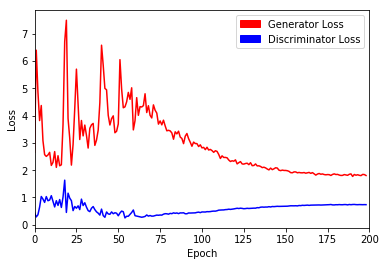

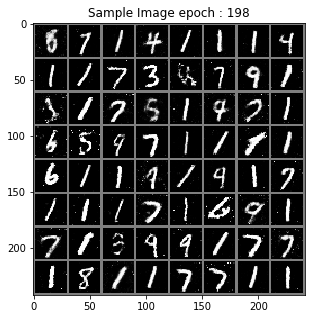

> Epoch : 200 Batch : 19 / 235 Loss_D : 0.7238961458206177 Loss_G : 1.745542287826538
> Epoch : 200 Batch : 39 / 235 Loss_D : 0.6457486152648926 Loss_G : 1.8724857568740845
> Epoch : 200 Batch : 59 / 235 Loss_D : 0.7801877856254578 Loss_G : 1.6097252368927002
> Epoch : 200 Batch : 79 / 235 Loss_D : 0.7276437282562256 Loss_G : 1.8342947959899902
> Epoch : 200 Batch : 99 / 235 Loss_D : 0.7893431782722473 Loss_G : 1.8852856159210205
> Epoch : 200 Batch : 119 / 235 Loss_D : 0.7712901830673218 Loss_G : 1.8775951862335205
> Epoch : 200 Batch : 139 / 235 Loss_D : 0.6475558280944824 Loss_G : 1.774446725845337
> Epoch : 200 Batch : 159 / 235 Loss_D : 0.7566608190536499 Loss_G : 2.032968044281006
> Epoch : 200 Batch : 179 / 235 Loss_D : 0.7958136796951294 Loss_G : 1.759171962738037
> Epoch : 200 Batch : 199 / 235 Loss_D : 0.7804723978042603 Loss_G : 1.683080792427063
> Epoch : 200 Batch : 219 / 235 Loss_D : 0.7362689971923828 Loss_G : 1.7902926206588745


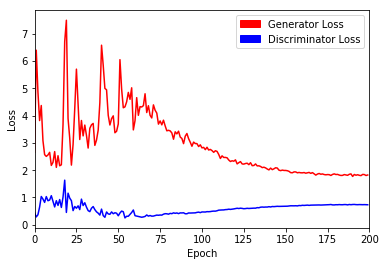

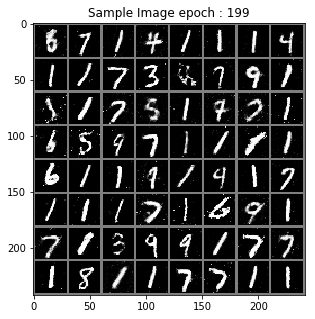

In [34]:
EPOCHS=200

if args['cuda']:
    fixed_noise=Variable(torch.randn(64,64)).cuda(CUDA_DEVICE)
else:
    fixed_noise=Variable(torch.randn(64,64))

losses_d=[]
losses_g=[]

for e in range(EPOCHS):
    loss_d_total=0
    loss_g_total=0
    for batch_idx, (data, _) in enumerate(MNIST_data):
        dis.zero_grad()
        
        #train discriminator with real
        if args['cuda']:
            real_im=Variable(data).cuda(CUDA_DEVICE)
            real_label=Variable(torch.ones(data.size(0))).cuda(CUDA_DEVICE)
        else:
            real_im=Variable(data)
            real_label=Variable(torch.ones(data.size(0)))
        
        pred_real=dis(real_im)
        dis_loss_real=criterion(pred_real.squeeze(),real_label)
        dis_loss_real.backward()
        
        #train discriminator with fake
        if args['cuda']:
            noise=Variable(torch.randn(data.size(0),64)).cuda(CUDA_DEVICE)
            fake_label=Variable(torch.zeros(data.size(0))).cuda(CUDA_DEVICE)
        else:
            noise=Variable(torch.randn(data.size(0),64))
            fake_label=Variable(torch.zeros(data.size(0)))
            
        fake_im=gen(noise)
        pred_fake=dis(fake_im.detach())
        dis_loss_fake=criterion(pred_fake.squeeze(),fake_label)
        dis_loss_fake.backward()

        #update total loss and optimize
        dis_loss=dis_loss_fake+dis_loss_real
        dis_optimizer.step()


        gen.zero_grad()

        #train generator
        if args['cuda']:
            noise=Variable(torch.randn(data.size(0),64)).cuda(CUDA_DEVICE)
        else:
            noise=Variable(torch.randn(data.size(0),64))
        
        fake_im=gen(noise)
        pred_fake=dis(fake_im)
        gen_loss=criterion(pred_fake.squeeze(),real_label)
        gen_loss.backward()
        gen_optimizer.step()
        
        loss_d_total+=dis_loss.data[0]
        loss_g_total+=gen_loss.data[0]
        if((batch_idx+1)%20==0):
            print('> Epoch :',e+1,'Batch :',batch_idx,'/',len(MNIST_data),'Loss_D :',dis_loss.data[0],'Loss_G :',gen_loss.data[0])
    
    loss_d_total/=len(MNIST_data)
    loss_g_total/=len(MNIST_data)
    
    losses_d.append(loss_d_total)
    losses_g.append(loss_g_total)
    
    axes = plt.gca()
    axes.set_xlim([0,EPOCHS])
    red_patch = mpatches.Patch(color='red', label='Generator Loss')
    blue_patch = mpatches.Patch(color='blue', label='Discriminator Loss')
    plt.legend(handles=[red_patch,blue_patch])
    plt.plot(list(range(e+1)),losses_g,c='red')
    plt.plot(list(range(e+1)),losses_d,c='blue')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.savefig('results/loss_plot_epoch_'+str(e)+'.jpg')
    plt.show()

    fake_im=gen(fixed_noise)
    out=make_grid(fake_im.view(-1,1,28,28).data)
    imshow(denorm(out.cpu()), c=0, save=False, title="Sample Image epoch : "+str(e))
    save_image(gen(fixed_noise).cpu().data,'results/sample_epoch_'+str(e+1)+'.jpg')
        
    